#**SKIN CANCER SEGMENTATION AND CLASSIFICATION ON HAM10000 DATASET**

This project has been made by Roberto Di Lauro, Roberto Tessitore, Giovanni De Francesco; Data Science students to University of Naples Federico II.

# Introduction
Skin cancer is the most common human malignancy and is primarily diagnosed through visual inspection—starting with clinical screening and potentially followed by dermoscopic analysis, biopsy, and histopathological examination. However, the global shortage of dermatologists, especially in resource-limited settings, has encouraged the development of computer-aided diagnosis (CAD) systems. These systems, leveraging advances in artificial intelligence, aim to support clinicians in detecting patterns in dermatoscopic images and guiding the diagnostic process.

While ethical considerations emphasize the irreplaceable role of human judgment—particularly in the final decision-making stages—CAD tools can provide valuable assistance by highlighting salient features and offering objective, reproducible interpretations based on pattern recognition.

The HAM10000 ("Human Against Machine with 10,000 training images") dataset is a curated collection of dermatoscopic images representing seven types of pigmented skin lesions. It has become a benchmark for developing machine learning models in dermatology.

In this project, we aim to develop a deep learning pipeline for multiclass classification of skin lesions using the HAM10000 dataset. Our approach includes:

Careful image preprocessing, aiming to enhance feature quality, reduce noise, and minimize computational cost;

Segmentation of dermatoscopic images to isolate the lesion region, thereby providing a more focused input for classification;

The use of convolutional neural networks (CNNs) and efficient architectures for classification;

Integration of statistical and unsupervised techniques, including clustering and dimensionality reduction, to support feature extraction and analysis.

This project stands at the intersection of data mining and machine learning, combining rigorous data analysis with powerful predictive modeling, with the overarching goal of contributing to interpretable, accurate, and reproducible skin lesion classification systems.

convolutional neural networks (CNNs) for image classification tasks.


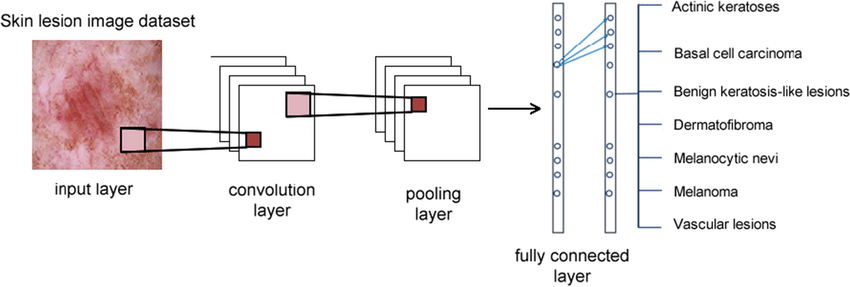

In [1]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import skew, kurtosis,chi2_contingency
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns


# Data loading

We will work on the following data. These data have been provided by the dataset HAM10000( Human against Machine with 10000 training images). It is a collection of skin pigmented lesions images, belonging from the different sources( Austria and Australia), taken in different ways and modalities. There are 4 different population involved into this case study. Austrian images belong to people who may be affected by skin diseases or with pathology cases in their family. Australian data belongs from people who may have skin sun damages.

In [ ]:
base_path = r"D:\Desktop\Directory"

df = pd.read_csv(os.path.join(base_path, "HAM10000_metadata.csv"))

df.rename(columns={
    "dx": "CLASS",
    "dx_type": "Ground truth type"
}, inplace=True)

df

,lesion_id,image_id,CLASS,Ground truth type,age,sex,localization,dataset
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,vidir_modern
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,vidir_modern
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,vidir_modern
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,vidir_modern
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,vidir_modern
...,...,...,...,...,...,...,...,...
10010,HAM_0002867,ISIC_0033084,akiec,histo,40.0,male,abdomen,vidir_modern
10011,HAM_0002867,ISIC_0033550,akiec,histo,40.0,male,abdomen,vidir_modern
10012,HAM_0002867,ISIC_0033536,akiec,histo,40.0,male,abdomen,vidir_modern
10013,HAM_0000239,ISIC_0032854,akiec,histo,80.0,male,face,vidir_modern


The Metadata csv give information about the Class of lesion and the type of Ground Truth, which is the way used to attribute a specific class to an image:
More than 50% of lesions are confirmed through histopathology (histo), the ground truth for the rest of the cases is either follow-up examination (follow_up), expert consensus (consensus), or confirmation by in-vivo confocal microscopy (confocal).  

The dataset includes lesions with multiple images, which can be tracked by the lesion_id-column

Than there is the age and sex of the people and the localization of the lesions.

In [ ]:
lesion_type_dict = {
    'nv': 'Melanocytic nevi',
    'mel': 'Melanoma',
    'bkl': 'Benign keratosis-like lesions ',
    'bcc': 'Basal cell carcinoma',
    'akiec': 'Actinic keratoses',
    'vasc': 'Vascular lesions',
    'df': 'Dermatofibroma'
}


df["Cell_type"] = df["CLASS"].map(lesion_type_dict.get)

There are 10.015 different images among the different classes.

Adding the column with the path of each image.

In [ ]:
cartella = r"D:\Desktop\Directory\IMG"
df['percorso_immagine'] = df["image_id"].apply(lambda x: os.path.join(cartella, x + '.jpg'))
df

,lesion_id,image_id,CLASS,Ground truth type,age,sex,localization,dataset,Cell_type,percorso_immagine
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,vidir_modern,Benign keratosis-like lesions,C:\Users\giovi\Desktop\Directory\IMG\ISIC_0027...
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,vidir_modern,Benign keratosis-like lesions,C:\Users\giovi\Desktop\Directory\IMG\ISIC_0025...
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,vidir_modern,Benign keratosis-like lesions,C:\Users\giovi\Desktop\Directory\IMG\ISIC_0026...
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,vidir_modern,Benign keratosis-like lesions,C:\Users\giovi\Desktop\Directory\IMG\ISIC_0025...
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,vidir_modern,Benign keratosis-like lesions,C:\Users\giovi\Desktop\Directory\IMG\ISIC_0031...
...,...,...,...,...,...,...,...,...,...,...
10010,HAM_0002867,ISIC_0033084,akiec,histo,40.0,male,abdomen,vidir_modern,Actinic keratoses,C:\Users\giovi\Desktop\Directory\IMG\ISIC_0033...
10011,HAM_0002867,ISIC_0033550,akiec,histo,40.0,male,abdomen,vidir_modern,Actinic keratoses,C:\Users\giovi\Desktop\Directory\IMG\ISIC_0033...
10012,HAM_0002867,ISIC_0033536,akiec,histo,40.0,male,abdomen,vidir_modern,Actinic keratoses,C:\Users\giovi\Desktop\Directory\IMG\ISIC_0033...
10013,HAM_0000239,ISIC_0032854,akiec,histo,80.0,male,face,vidir_modern,Actinic keratoses,C:\Users\giovi\Desktop\Directory\IMG\ISIC_0032...


Getting the path for each segmented image from the drive and adding it to the dataframe.

In [ ]:
cartella = r"C:\Users\giovi\Desktop\Directory\HAM10000_segmentations_lesion_tschandl"
df['percorso_maschere'] = df["image_id"].apply(lambda x: os.path.join(cartella, x + '_segmentation.png'))
df


There are 7 different classes of lesion. Their names stand for:


1) nv :  Melanocytic Nevi --> benign neoplasms, have many variants and dermathologically can differ a  lot between themselves. Respect to the melanoma are more simmetric in terms of color and distribution

2) Mel : Melanoma --> malign form of skin lesion. It may have a caothic distribution

3) bkl : Benign Keratosis-like lesions --> it may have different sources, but all of them are biologically similar

4) bcc : Basal cell carcinoma --> is a malign form of lesion, it may be flat, nodular, pigmented. it has no methastasys, but should be treated in time( it may become destructive)

5) akiec : Actinic Keratoses and Intraepithelial carcinoma --> It is generally a non invasive carcinoma, it may be not treated surgically. It may evolve in an invasive form, generally on face.

6) vasc : Vascular skin lesion --> Generally red and purple lesions.


7) df : Dermatofibroma --> benign lesion. Sometimes may be a reaction to a trauma. It has reticular lines and white central bulbe.

In [ ]:
print(f"Number of classes: {len(df['CLASS'].unique())}")

counting_classes = df["CLASS"].value_counts()
counting_classes

Number of classes: 7


CLASS
nv       6705
mel      1113
bkl      1099
bcc       514
akiec     327
vasc      142
df        115
Name: count, dtype: int64

It is clearly observable that this is actually an unbalanced problem. The Melanocytic Nevi class has many more samples. This may affect the modelling phase, so we will have to deal with that.

Showing two examples of images for each class of the dataset. In the dataset there has been done a natural augmentation, so many image are already cropped or there has been a zoom over them. It is possible to see how quite different images belong to the same class and that some are hair artifact and black edges that may be removed eventually.

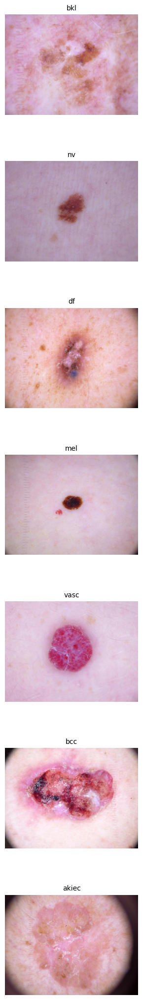

In [ ]:
classes = df["CLASS"].unique()
n_img_for_class = 1

fig, axs = plt.subplots(len(classes), n_img_for_class, figsize=(n_img_for_class * 3, len(classes) * 3))

if len(classes) == 1 and n_img_for_class == 1:
    axs = np.array([[axs]])
elif len(classes) == 1:
    axs = np.expand_dims(axs, axis=0)
elif n_img_for_class == 1:
    axs = np.expand_dims(axs, axis=1)

for i, classe in enumerate(classes):
    sotto_df = df[df["CLASS"] == classe].head(n_img_for_class)
    for j, path in enumerate(sotto_df["percorso_immagine"]):
        img = mpimg.imread(path)
        axs[i, j].imshow(img)
        axs[i, j].axis('off')
        axs[i, j].set_title(f"{classe}", fontsize=10)

plt.tight_layout()
plt.show()


#  Data Cleaning

To preparate data it is important to check if there are any missing values into the dataset. There are 57 missing values for the "age" column. So before proceeding, it may be interesting to check which are the classes with missing values.

In [ ]:
df.isnull().sum()

lesion_id             0
image_id              0
CLASS                 0
Ground truth type     0
age                  57
sex                   0
localization          0
dataset               0
Cell_type             0
percorso_immagine     0
percorso_maschere     0
dtype: int64

There are 45 missing age values for Melanocytic nevi, 10 for BKL and 2 for Melanoma.

In [ ]:
#Record with missing age
missing_age = df[df["age"].isna()]

counting_cell_type = missing_age["Cell_type"].value_counts()
print(counting_cell_type)


Cell_type
Melanocytic nevi                  45
Benign keratosis-like lesions     10
Melanoma                           2
Name: count, dtype: int64


There are 52 over 57 missing values for different lesion_id.

In [ ]:
#Checking if there are equal lesion_id with missing age
print("Unique lesion_id with missing age:", missing_age["lesion_id"].nunique())

lesion_counts = missing_age["lesion_id"].value_counts()
print(lesion_counts.head())

Unique lesion_id with missing age: 52
lesion_id
HAM_0000698    2
HAM_0006074    2
HAM_0000169    2
HAM_0007278    2
HAM_0002417    2
Name: count, dtype: int64


Creating a map to check if there are same lesion_id for the one with missing values in order to fill in the age column. Unfortunately this case in not efficient and it is not possible to fill in any empty record.

In [ ]:
#Creating a map lesion_id → known age
lesion_age_map = df[df["age"].notna()].groupby("lesion_id")["age"].first().to_dict()

#Filling missing age if lesion_id is in the map
def fill_age(row):
    if pd.isna(row["age"]) and row["lesion_id"] in lesion_age_map:
        return lesion_age_map[row["lesion_id"]]
    else:
        return row["age"]

df["age"] = df.apply(fill_age, axis=1)
print("How many missing 'age' values after applying fill_age ?:", df["age"].isna().sum())


How many missing 'age' values after applying fill_age ?: 57


Before making any imputation to solve the problem, we want to understand the global distribution of age among the different lesions classes. The average age is quite similar among the classes(around 65 years old), excpet for "nv", "vasc" and "df"(all benign form of lesions).

In [ ]:
df_unici = df.drop_duplicates(subset="lesion_id", keep="first")
df_unici.groupby("CLASS")["age"].describe()


,count,mean,std,min,25%,50%,75%,max
CLASS,,,,,,,,
akiec,228.0,66.557018,11.576647,30.0,60.0,67.5,75.0,85.0
bcc,327.0,66.896024,13.518275,20.0,60.0,70.0,77.5,85.0
bkl,718.0,64.394150,13.981531,0.0,55.0,65.0,75.0,85.0
df,73.0,52.739726,13.229835,25.0,45.0,55.0,65.0,80.0
mel,613.0,61.296900,15.105509,5.0,50.0,65.0,70.0,85.0
nv,5361.0,47.257974,14.169103,0.0,40.0,45.0,55.0,85.0
vasc,98.0,52.500000,20.373446,0.0,45.0,55.0,70.0,85.0


Showing the distribution of the age among the different classes(considering unique lesion_id not to introduce any biases into the visualization). This boxplot give us the information about the range of ages of the dataset which is 0-85. There is the presence of some outliers. It has been decided to proceed imputating the mean for each belonging class to the missing values.

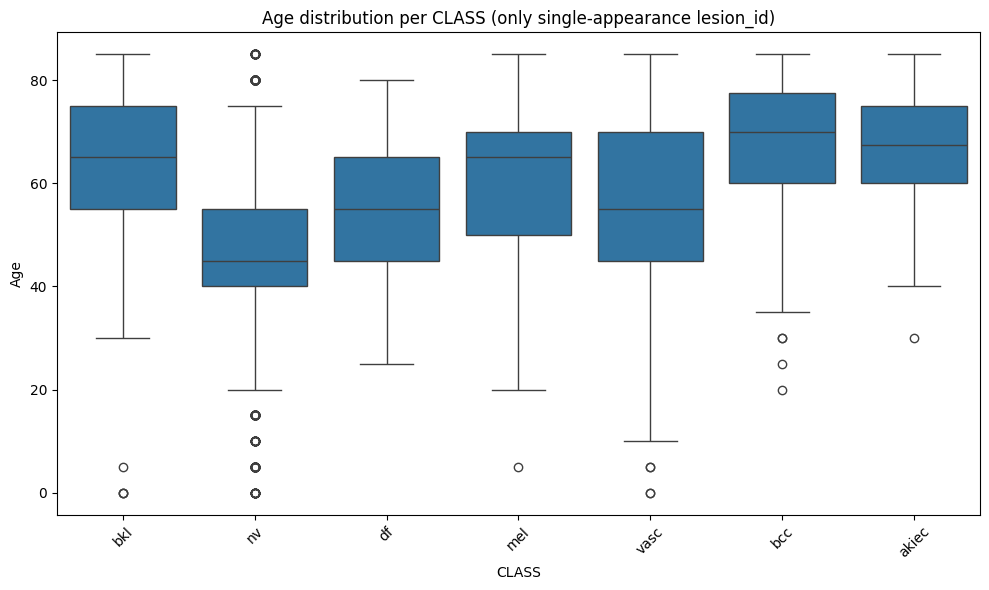

In [ ]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_unici, x="CLASS", y="age")
plt.title("Age distribution per CLASS (only single-appearance lesion_id)")
plt.xticks(rotation=45)
plt.ylabel("Age")
plt.xlabel("CLASS")
plt.tight_layout()
plt.show()

In [ ]:
#Imputation for missing values

mean_age_per_class = df.groupby("CLASS")["age"].mean()
print(mean_age_per_class)

def mean_age(row):
    if pd.isna(row["age"]):
        return mean_age_per_class[row["CLASS"]]
    return row["age"]

df["age"] = df.apply(mean_age, axis=1)


CLASS
akiec    66.529052
bcc      66.828794
bkl      64.283747
df       53.043478
mel      60.679568
nv       46.477477
vasc     51.373239
Name: age, dtype: float64


In [ ]:
print("Missing values over 'age':", df["age"].isna().sum())


Missing values over 'age': 0


# Exploratory data analysis(EDA)

*Univariate EDA*

In this section we want to understand the distribution of the metadata features, trying to extract useful information.

By looking at the frequency distribution of the different Cell_type(classes) it is clearly observable how this is an unbalanced dataset. ALmost 7 thousands of images belong to Melanocytic Nevi, only 1 thousand are Melanoma and BKL images, and very few of them belong to the other classes.

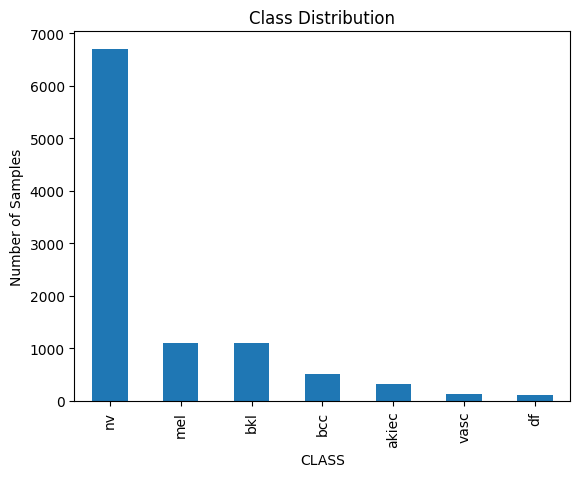

In [ ]:
df["CLASS"].value_counts().plot(kind='bar', title='Class Distribution')
plt.ylabel("Number of Samples")
plt.show()


In [ ]:
print(df["CLASS"].value_counts(normalize=True))


CLASS
nv       0.669496
mel      0.111133
bkl      0.109735
bcc      0.051323
akiec    0.032651
vasc     0.014179
df       0.011483
Name: proportion, dtype: float64


We then went into the distribution of the different technical ways to assign a the ground truth to each images. These are the following with relative explanation:


1. Histopathology(Histo): Histopathologic diagnoses of excised lesions have been performed by specialized dermatopathologists.
2. Confocal: Reflectance confocal microscopy is an in-vivo imaging technique with a resolution at near-cellular level , and some facial benign with a grey-world assumption of all training-set images in Lab-color space before and after manual histogram changes.
3. Follow-up: If nevi monitored by digital dermatoscopy did not show any changes during 3 follow-up visits or 1.5 years biologists accepted this as evidence of biologic benignity. Only nevi, but no other benign diagnoses were labeled with this type of ground-truth because dermatologists usually do not monitor dermatofibromas, seborrheic keratoses, or vascular lesions.
4. Consensus: For typical benign cases without histopathology or followup biologists provide an expert-consensus rating of authors PT and HK. They applied the consensus label only if both authors independently gave the same unequivocal benign diagnosis. Lesions with this type of groundtruth were usually photographed for educational reasons and did not need further follow-up or biopsy for confirmation.

Most of the images have been classified by hystopathologic diagnoses and follow-up.

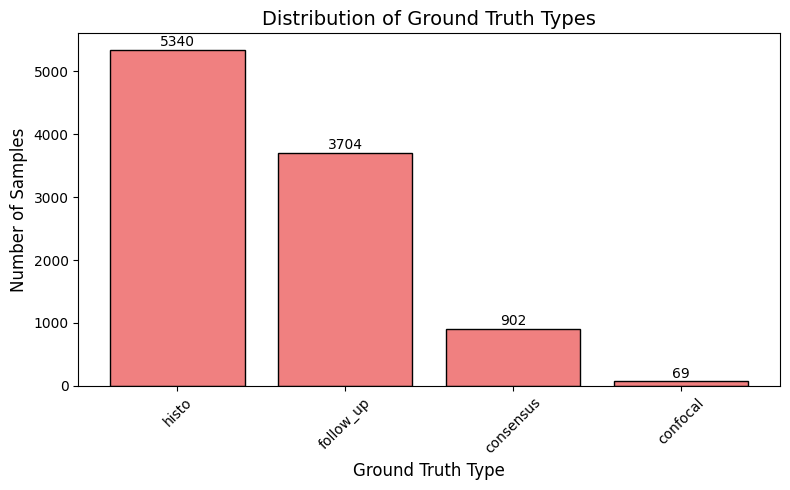

In [ ]:
#Different ground truth types
gt_counts = df['Ground truth type'].value_counts()


plt.figure(figsize=(8, 5))
bars = plt.bar(gt_counts.index, gt_counts.values, color='lightcoral', edgecolor='black')
plt.title('Distribution of Ground Truth Types', fontsize=14)
plt.xlabel('Ground Truth Type', fontsize=12)
plt.ylabel('Number of Samples', fontsize=12)
plt.xticks(rotation=45)

#label
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 10, str(height),
             ha='center', va='bottom', fontsize=10)

plt.tight_layout()
plt.show()

Then we can see the distribution of the "localization" column. It shows that the lesions are mainly detected on the back, at lower extremity and rarely on the ears or genitals.

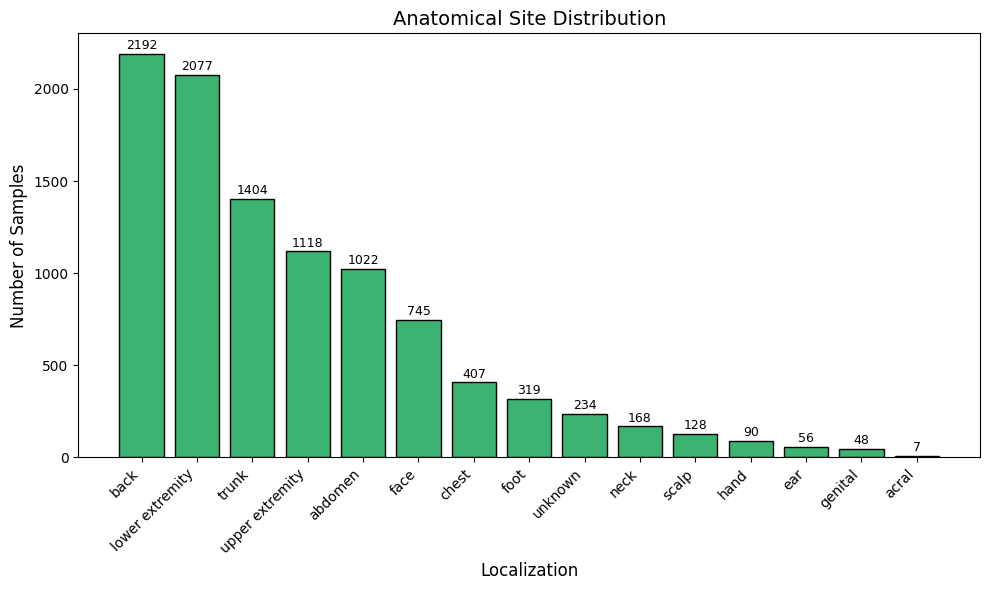

In [ ]:
#Counting localization
loc_counts = df['localization'].value_counts()


plt.figure(figsize=(10, 6))
bars = plt.bar(loc_counts.index, loc_counts.values, color='mediumseagreen', edgecolor='black')
plt.title('Anatomical Site Distribution', fontsize=14)
plt.xlabel('Localization', fontsize=12)
plt.ylabel('Number of Samples', fontsize=12)
plt.xticks(rotation=45, ha='right')

#number over the bars
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 10, str(height),
             ha='center', va='bottom', fontsize=9)

plt.tight_layout()
plt.show()

It is possible to appreciate now the global distribution of "age". It seems to be a normal distribution with a peak between 40 and 50 years old.  This shows that people involved into the study range over a wide range of age, but are mainly middle-age people.

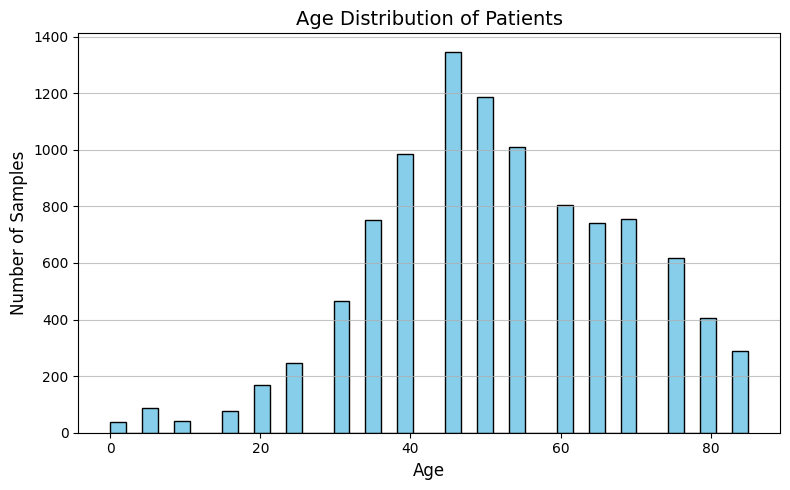

In [ ]:
plt.figure(figsize=(8,5))
plt.hist(df['age'].dropna(), bins=40, color='skyblue', edgecolor='black')
plt.title('Age Distribution of Patients', fontsize=14)
plt.xlabel('Age', fontsize=12)
plt.ylabel('Number of Samples', fontsize=12)
plt.grid(axis='y', alpha=0.75)
plt.tight_layout()
plt.show()


In [ ]:
ages = df['age'].dropna()

#descriptive statistics
mean_age = ages.mean()
median_age = ages.median()
mode_age = ages.mode().iloc[0]

var_age = ages.var()
std_age = ages.std()
skewness_age = skew(ages)
kurtosis_age = kurtosis(ages)

print(f"Mean age: {mean_age:.2f}")
print(f"Median age: {median_age:.2f}")
print(f"Mode age: {mode_age}")
print(f"Variance: {var_age:.2f}")
print(f"Standard Deviation: {std_age:.2f}")
print(f"Skewness: {skewness_age:.2f}")
print(f"Kurtosis: {kurtosis_age:.2f}")


Mean age: 51.85
Median age: 50.00
Mode age: 45.0
Variance: 286.59
Standard Deviation: 16.93
Skewness: -0.16
Kurtosis: -0.15


Now, it is possible to see how the images are well distributed between male and female(54% and 45% respectively). So there is not a gender bias into data. There is also a very small percentage of "uunknown", which should not be important in terms of exploration.

C:\Users\giovi\AppData\Local\Temp\ipykernel_23700\3683568138.py:14: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  f'{sex_counts[i]} ({sex_perc[i]:.1f}%)',


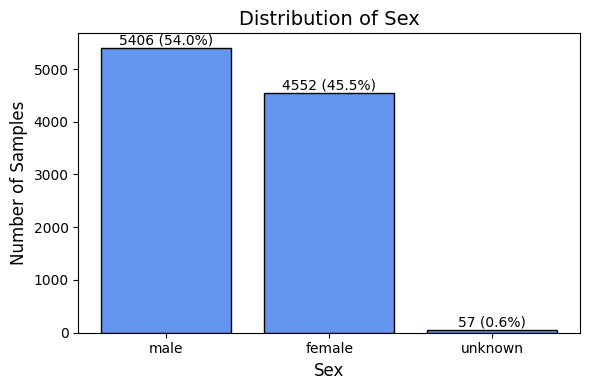

In [ ]:
sex_counts = df['sex'].value_counts()
sex_perc = df['sex'].value_counts(normalize=True) * 100

plt.figure(figsize=(6,4))
bars = plt.bar(sex_counts.index, sex_counts.values, color='cornflowerblue', edgecolor='black')

plt.title('Distribution of Sex', fontsize=14)
plt.xlabel('Sex', fontsize=12)
plt.ylabel('Number of Samples', fontsize=12)

for i, bar in enumerate(bars):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 5,
             f'{sex_counts[i]} ({sex_perc[i]:.1f}%)',
             ha='center', va='bottom', fontsize=10)

plt.tight_layout()
plt.show()


*Bivariate EDA*

Categorical vs Categorical

We performed a Chi-squared test to investigate whether there is a statistically significant association between the lesion class (CLASS) and the patient's sex (sex).

The test yielded a Chi-squared statistic of 106.90 with a p-value < 0.05, indicating a statistically significant dependence between the two variables.

However, upon visual inspection of the class distribution by sex through count plots and normalized bar plots, the relative proportions appear very similar across sexes. This suggests that although the test detects a significant association, it is likely due to the large sample size (over 10,000 samples), which makes the test highly sensitive even to small deviations.

As a result, we conclude that while the association is statistically significant, it may not be practically relevant, and the distribution of lesion classes can be considered approximately balanced across sex for modeling purposes.

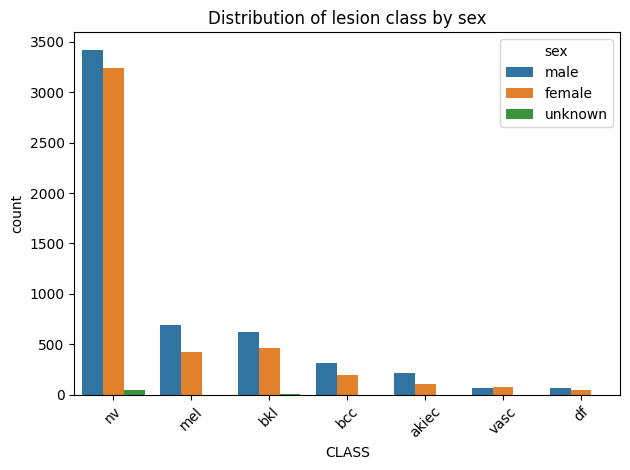

Chi2 statistic: 106.90381271641068
p-value: 2.4464388098587195e-17


In [ ]:
sns.countplot(data=df, x="CLASS", hue="sex", order=df["CLASS"].value_counts().index)
plt.title("Distribution of lesion class by sex")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



#Table of frequencies
table = pd.crosstab(df["CLASS"], df["sex"])

#Chi-square test
chi2, p, dof, expected = chi2_contingency(table)

print("Chi2 statistic:", chi2)
print("p-value:", p)


It may be interesting to understand the relation between the localization of the lesion and its belonging class. It is showed an heatmap that gives the percentage of the observation among the different parts of the body. It is possible to see that Melanoma, BCC, BKL are mainly present on the back, while Dermatofibroma is for the 71% over the lower extremities. An high percentage (35%) ok Akiec is over the face, and so the BCC and BKL. These assumptions have been possible over the heatmap, by executing a Chi-square test. It shows that there is a strong association between the lesion class and its localization.
Some lesion types occur more frequently in specific parts of the body. The Chi-square statistic is very high and the p-value < 0.05, showing association(rejection of the null-hypothesis).

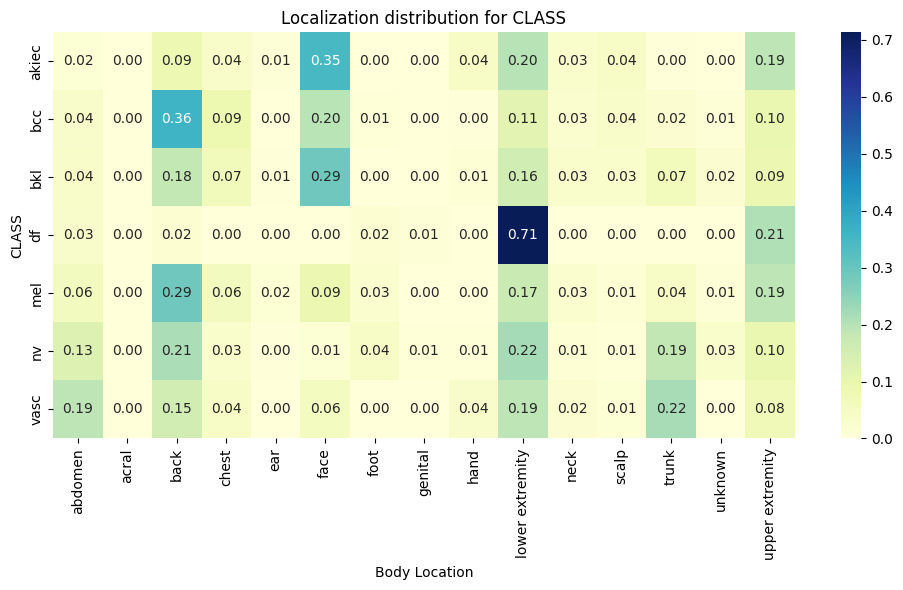

Chi2 statistic: 2821.9101978213816
p-value: 0.0
Degrees of freedom: 84


In [ ]:
ctab = pd.crosstab(df["CLASS"], df["localization"], normalize='index')  #percentages
plt.figure(figsize=(10, 6))
sns.heatmap(ctab, annot=True, fmt=".2f", cmap="YlGnBu")
plt.title("Localization distribution for CLASS")
plt.ylabel("CLASS")
plt.xlabel("Body Location")
plt.tight_layout()
plt.show()


#Table of frequencies
table = pd.crosstab(df["CLASS"], df["localization"])

#Chi-square test
chi2, p, dof, expected = chi2_contingency(table)

print("Chi2 statistic:", chi2)
print("p-value:", p)
print("Degrees of freedom:", dof)

Then are visualized the standardized residuals to check the most relevant couples that influence the results of the Chi-square test.

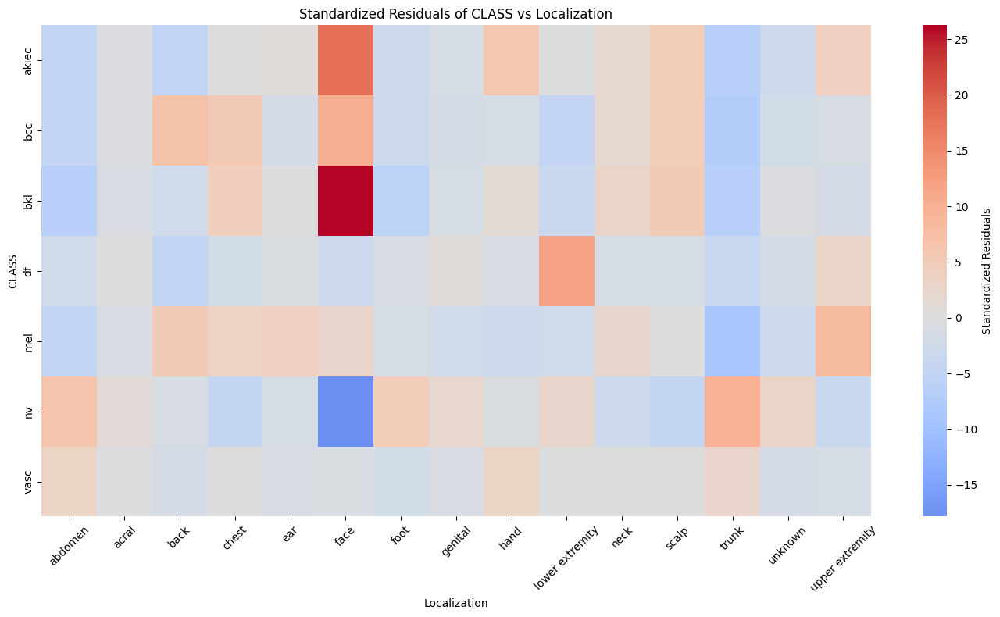

In [ ]:
#Standardized residuals
residuals = (table - expected) / np.sqrt(expected)
residuals_df = pd.DataFrame(residuals, index=table.index, columns=table.columns)


plt.figure(figsize=(14, 8))
sns.heatmap(residuals_df, annot=False, cmap="coolwarm", center=0, cbar_kws={'label': 'Standardized Residuals'})
plt.title("Standardized Residuals of CLASS vs Localization")
plt.ylabel("CLASS")
plt.xlabel("Localization")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



*Categorical vs Numerical*

We have already saw the relationship between classes and age, so we proceed with a further analysis.

# Data pre-processing

The images have 3 channels(RGB) and their size is 450x600.

In [ ]:
pip install tqdm

Note: you may need to restart the kernel to use updated packages.


In [ ]:
import cv2
from concurrent.futures import ThreadPoolExecutor, as_completed
from sklearn.preprocessing import LabelEncoder
import pickle
from tqdm import tqdm


Loading images path and applying a function to preprocess them using cv2 library. Then each image is read as an array, and it is created a 4 D array(X) with : N, C, H, W where N is the number of images. It is applied a one-hot encoding to the CLASS of lesions which will be the label of the classification problem.

In [ ]:
def load_and_preprocess(path, img_size = 64):
    img = cv2.imread(path)
    if img is None:
        return None
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (img_size, img_size))
    img = img / 255.0
    return img

image_paths = df['percorso_immagine'].values.tolist()

def load_with_index(idx_path, img_size = 64):
    idx, path = idx_path
    img = load_and_preprocess(path, img_size = img_size)
    return idx, img

In [ ]:
IMG_SIZE = 64
images_64 = [None] * len(image_paths)

with ThreadPoolExecutor(max_workers=8) as executor: #parallelizzo il lavoro
    futures = {executor.submit(load_with_index, (i, p),img_size=IMG_SIZE): i for i, p in enumerate(image_paths)}
    for future in tqdm(as_completed(futures), total=len(futures), desc="Uploading images"):
        i, img = future.result()
        images_64[i] = img

Uploading images: 100%|██████████| 10015/10015 [28:20<00:00,  5.89it/s]


In [ ]:
le = LabelEncoder()

In [ ]:
#Copying the dataframe to work indipendently with 64x64 images
df_64 = df.copy()
df_64['image_array'] = images_64 #each image into array
df_64 = df_64[df_64['image_array'].notnull()]

X_64 = np.stack(df_64['image_array'].values)
y_64 = le.fit_transform(df_64['CLASS'].values)

The X array has 4 dimensions : the total number of images, the height and the width, the 3 RGB channels.

In [ ]:
X.shape

(10015, 64, 64, 3)

It is possible to visually compare the original high-resolution images with the preprocessed versions. It becomes immediately clear that reducing the resolution significantly affects the clarity of the pigmented lesions — fine details are lost, and the lesion borders appear less defined. This degradation may impact the performance of downstream classification tasks. Therefore, increasing the target resolution during preprocessing (e.g., to 128×128) could help preserve more relevant visual information, while still balancing the computational cost.

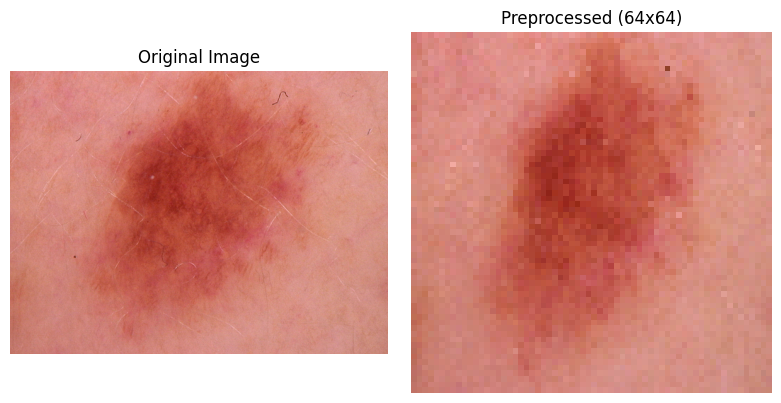

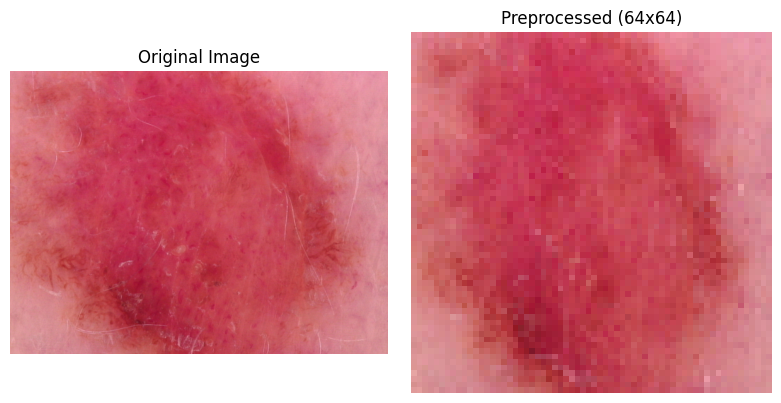

In [ ]:
n_imgs = 2 #image to show
ind = np.random.choice(df.index, size=n_imgs, replace=False)

for idx in ind:
    #image path
    path = df.loc[idx, 'percorso_immagine']

    #original image
    original_img = cv2.imread(path)
    original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

    preprocessed_img = X[idx]  #normalized and 64x64x3

    #scaling for security
    preprocessed_img_disp = (preprocessed_img * 255).astype(np.uint8)

    fig, axs = plt.subplots(1, 2, figsize=(8, 4))
    axs[0].imshow(original_img)
    axs[0].set_title("Original Image")

    axs[1].imshow(preprocessed_img_disp)
    axs[1].set_title("Preprocessed (64x64)")

    for ax in axs:
        ax.axis('off')
    plt.tight_layout()
    plt.show()


*Uploading preprocessed images at higher resolution: 128x128*

In [ ]:
le = LabelEncoder()
y = le.fit_transform(df['CLASS'].values)

In [ ]:
IMG_SIZE = 224

with ThreadPoolExecutor(max_workers=8) as executor:
    futures = {executor.submit(load_with_index, (i, p), img_size=IMG_SIZE): i for i, p in enumerate(image_paths)}
    images_224 = [None] * len(image_paths)
    for future in tqdm(as_completed(futures), total=len(futures), desc="Loading images 128x128"):
        i, img = future.result()
        images_224[i] = img

Loading images 128x128:  60%|█████▉    | 5969/10015 [10:37<1:26:15,  1.28s/it]

In [ ]:
 #Copying the dataframe to work indipendently with 128x128 images
df_224 = df.copy()
df_224['image_array'] = images_224
df_224 = df_224[df_224['image_array'].notnull()]


X_224 = np.stack(df_224['image_array'].values)
y_224 = le.transform(df_224['CLASS'].values)

It became evident that 224×224 offers a good trade-off between visual detail and computational efficiency. Unlike the 64×64 version—which tends to lose many important features such as sharp lesion borders, internal structures, and small-scale artifacts—the 128×128 resolution is able to preserve more meaningful morphological and structural details of the skin lesions.

At the same time, this resolution remains manageable from a computational perspective, making it suitable for dimensionality reduction techniques

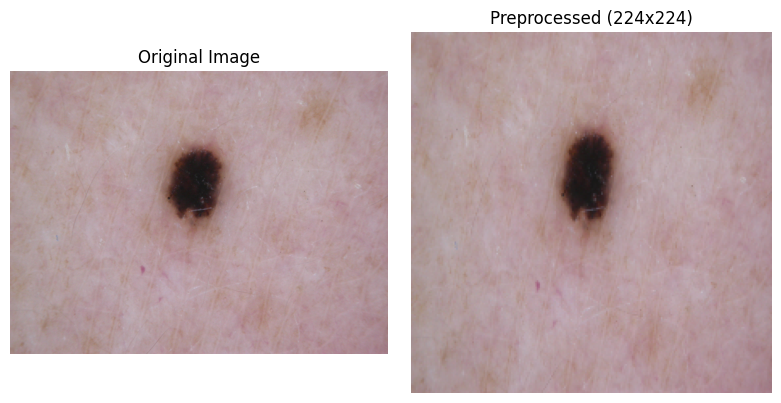

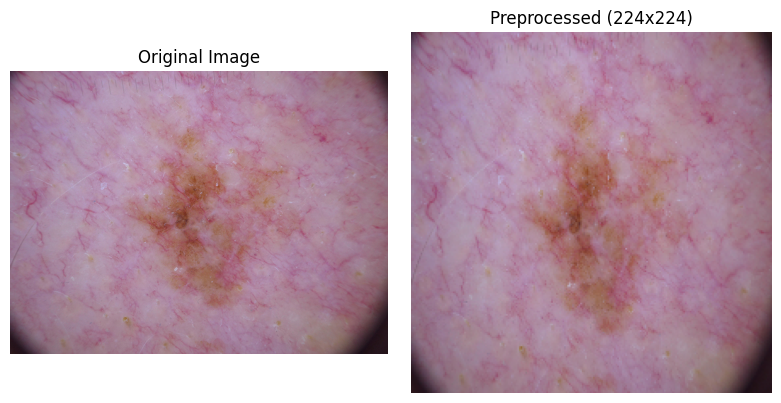

In [ ]:
n_imgs = 2 #image to show
ind = np.random.choice(df_224.index, size=n_imgs, replace=False)

for idx in ind:
    #image path
    path = df_224.loc[idx, 'percorso_immagine']

    #original image
    original_img = cv2.imread(path)
    original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

    preprocessed_img = X_224[idx]  #normalized and 64x64x3

    #scaling for security
    preprocessed_img_disp = (preprocessed_img * 255).astype(np.uint8)

    fig, axs = plt.subplots(1, 2, figsize=(8, 4))
    axs[0].imshow(original_img)
    axs[0].set_title("Original Image")

    axs[1].imshow(preprocessed_img_disp)
    axs[1].set_title("Preprocessed (128x128)")

    for ax in axs:
        ax.axis('off')
    plt.tight_layout()
    plt.show()

*Adjusting* brightness, sharpness, noise and hair removal

Hairs may obscure lesion borders or interfere with feature extraction, ultimately reducing the accuracy of classification or segmentation models. The dullrazor_strong function tackles this issue by implementing a robust image preprocessing pipeline for automated hair detection and removal, based on the principles of the classic DullRazor algorithm.

In [ ]:
def dullrazor_strong(img):

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply filter
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (9, 9))
    blackhat = cv2.morphologyEx(gray, cv2.MORPH_BLACKHAT, kernel)

    #Adjust Contrast
    _, hair_mask = cv2.threshold(blackhat, 10, 255, cv2.THRESH_BINARY)

    # Expand Mask
    kernel_dilate = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
    hair_mask = cv2.dilate(hair_mask, kernel_dilate, iterations=1)


    result = cv2.inpaint(img, hair_mask, 3, cv2.INPAINT_TELEA)

    return result, hair_mask

def process_folder(input_folder, output_folder):
    os.makedirs(output_folder, exist_ok=True)

    for filename in os.listdir(input_folder):
        if filename.lower().endswith('.jpg'):
            img_path = os.path.join(input_folder, filename)
            save_path = os.path.join(output_folder, filename)


            img = cv2.imread(img_path)
            if img is None:
                print(f"Errore nel caricamento di {filename}")
                continue


            result, hair_mask = dullrazor_strong(img)

            cv2.imwrite(save_path, result)
            print(f"Processed: {filename}")

In [ ]:
input_folder = r"D:\Desktop\Directory\IMG"
output_folder =r"D:\Desktop\Directory\Dull_razor"

process_folder(input_folder, output_folder)

To enhance the visual quality and the informative content of the images, we explored several combinations of preprocessing operations:

- **Denoising with `fastNlMeansDenoisingColored`**  
  → Discarded: it introduces loss of detail and was not useful on the original images.

- **Sharpening:**
  - *Soft sharpening* (kernel with center weight 3 and -0.5 off-center)
  - *Very soft sharpening* (kernel with center weight 2 and -0.25 off-center)  
  → The latter produced more natural results with fewer visual artifacts.

- **CLAHE (Contrast Limited Adaptive Histogram Equalization):**
  - `clipLimit = 1.0`: mild effect, sometimes barely noticeable
  - `clipLimit = 2.0`: balanced enhancement
  - `clipLimit = 3.0`: optimal result, improves local contrast without overexposing the image

---

###  Final Choice

We chose to apply:

- **Very soft sharpening**
- followed by **CLAHE with `clipLimit = 3.0`**

This configuration provided the best compromise between sharpness and visual naturalness.


In [ ]:
# Sharpening kernels
soft_kernel = np.array([[0, -0.5, 0],
                        [-0.5, 3, -0.5],
                        [0, -0.5, 0]])

very_soft_kernel = np.array([[0, -0.25, 0],
                             [-0.25, 2, -0.25],
                             [0, -0.25, 0]])

def apply_sharpen(img, kernel): #nitidezza
    return cv2.filter2D(img, -1, kernel)

def apply_clahe(img, clipLimit=2.0):  #contrasto
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=clipLimit, tileGridSize=(8,8))
    cl = clahe.apply(l)
    limg = cv2.merge((cl, a, b))
    return cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)


In [ ]:
idx = 9800
img_rgb = (X_128[idx] * 255).astype(np.uint8)


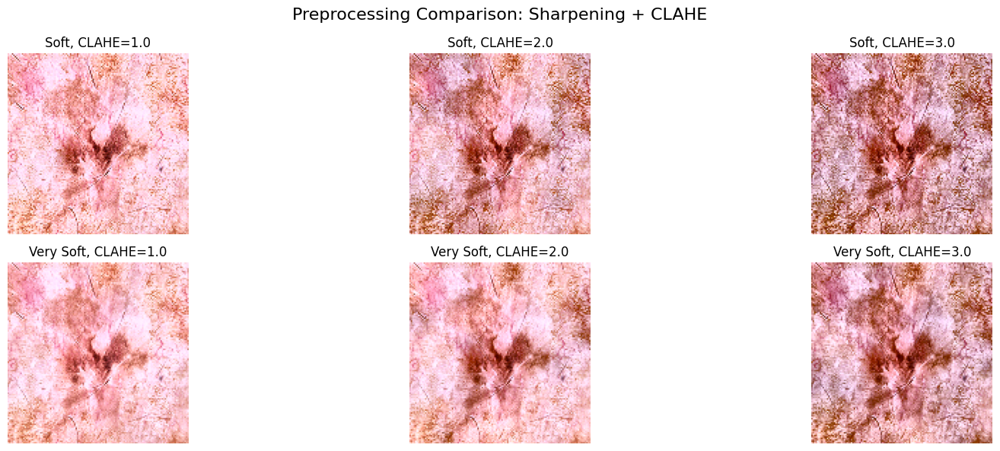

In [ ]:
clip_limits = [1.0, 2.0, 3.0]
kernels = {'Soft': soft_kernel, 'Very Soft': very_soft_kernel}

plt.figure(figsize=(18, 6))
i = 1

for kernel_name, kernel in kernels.items():
    for clip in clip_limits:
        sharpened = apply_sharpen(img_rgb, kernel)
        enhanced = apply_clahe(sharpened, clipLimit=clip)

        plt.subplot(2, 3, i)
        plt.imshow(enhanced)
        plt.title(f'{kernel_name}, CLAHE={clip}')
        plt.axis('off')
        i += 1

plt.suptitle('Preprocessing Comparison: Sharpening + CLAHE', fontsize=16)
plt.tight_layout()
plt.show()


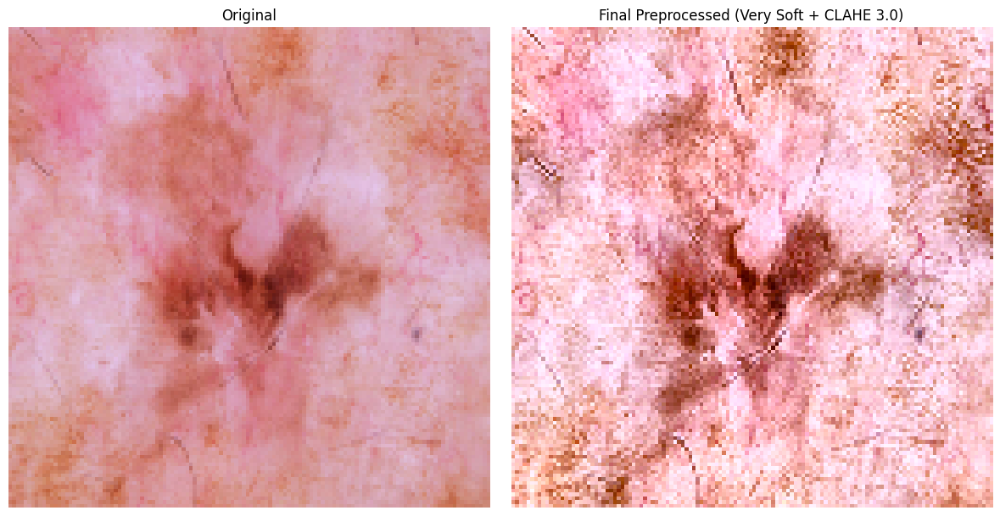

In [ ]:
def final_preprocessing(img):
    sharpened = apply_sharpen(img, very_soft_kernel)
    return apply_clahe(sharpened, clipLimit=2.0)

#Apply processing
img_final = final_preprocessing(img_rgb)

#Show side-by-side comparison
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(img_rgb)
plt.title("Original")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(img_final)
plt.title("Final Preprocessed (Very Soft + CLAHE 3.0)")
plt.axis('off')

plt.tight_layout()
plt.show()


After testing various parameters for Sharpening and CLAHE, we selected the most suitable ones and applied the method to the entire image folder.

In [ ]:
def resize_and_normalize_images(input_folder, output_folder, size=(224, 224)):
    os.makedirs(output_folder, exist_ok=True)

    image_files = [f for f in os.listdir(input_folder) if f.lower().endswith('.jpg')]

    for filename in tqdm(image_files, desc="Ridimensionamento e normalizzazione immagini"):
        img_path = os.path.join(input_folder, filename)
        save_path = os.path.join(output_folder, filename)

        try:
            with Image.open(img_path) as img:
                img = img.convert("RGB")
                img = img.resize(size, Image.LANCZOS)

                img_array = np.array(img).astype(np.float32) / 255.0  # valori in [0,1]

                img_to_save = (img_array * 255).astype(np.uint8)
                img_out = Image.fromarray(img_to_save)
                img_out.save(save_path)

        except Exception as e:
            print(f"Errore con file {filename}: {e}")


In [ ]:
resize_and_normalize_images(
    input_folder=r"D:\Desktop\Directory\Dull_Razor",
    output_folder=r"D:\Desktop\Directory\224X224",
    size=(224, 224)
)

In [ ]:
soft_kernel = np.array([[0, -0.5, 0],
                        [-0.5, 3, -0.5],
                        [0, -0.5, 0]])

def apply_sharpen(img, kernel):
    return cv2.filter2D(img, -1, kernel)

def apply_clahe(img, clipLimit=2.0):
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=clipLimit, tileGridSize=(8,8))
    cl = clahe.apply(l)
    limg = cv2.merge((cl, a, b))
    return cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)

def sharpen_and_clahe_folder(
    input_folder,
    output_folder,
    kernel=soft_kernel,
    clipLimit=2.0
):
    os.makedirs(output_folder, exist_ok=True)
    files = [f for f in os.listdir(input_folder) if f.lower().endswith('.jpg')]
    for f in tqdm(files, desc="Nitidezza + CLAHE"):
        path_in = os.path.join(input_folder, f)
        path_out = os.path.join(output_folder, f)
        img = cv2.imread(path_in)
        if img is None:
            print(f"Immagine non caricata: {f}")
            continue
        img = apply_sharpen(img, kernel)
        img = apply_clahe(img, clipLimit=clipLimit)
        cv2.imwrite(path_out, img)

In [ ]:
sharpen_and_clahe_folder(r"D:\Desktop\Directory\224X224",r"D:\Desktop\Directory\Pre-Processate" )

Nitidezza + CLAHE: 0it [00:00, ?it/s]


# *Using NMF to extract features*

To perform an initial and computationally affordable exploration, we applied Non-negative Matrix Factorization (NMF) on a balanced subset of the HAM10000 dataset, selecting 100 images per class. This approach allows us to evaluate the behavior and potential of NMF while keeping the analysis tractable and proportional across all lesion categories.

We started with a reduced resolution of 64×64 pixels to observe how well NMF preserves meaningful visual features, with the possibility of increasing resolution (e.g., 128×128) in future experiments to better capture fine-grained structures.

NMF is a linear, unsupervised dimensionality reduction technique that decomposes an input matrix into two non-negative matrices — one encoding the latent components (basis) and the other their activation in each sample. It is particularly suited for parts-based learning, meaning it tends to extract localized and interpretable features, which makes it an interesting choice for image analysis tasks involving complex visual patterns such as skin lesions.

This technique may later be compared with non-linear approaches, such as convolutional autoencoders, which can learn more flexible representations and may reconstruct images more accurately. These learned representations can then be used as compressed inputs to train classifiers, potentially improving performance by focusing on salient features while reducing input dimensionality.

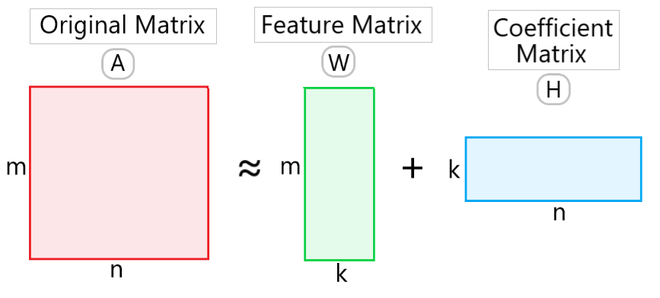

In [ ]:
from sklearn.decomposition import NMF

In [ ]:
df_subset = pd.DataFrame({
    'image': list(X_128),
    'label': y_128
})

#Grouping by label and taking 100 samples for each
df_sampled = df_subset.groupby('label', group_keys=False).apply(lambda x: x.sample(n=100, random_state=42))

X_balanced = np.stack(df_sampled['image'].values)
y_balanced = df_sampled['label'].values

/tmp/ipython-input-7-252139583.py:7: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df_sampled = df_subset.groupby('label', group_keys=False).apply(lambda x: x.sample(n=100, random_state=42))


In [ ]:
X_flat = X_balanced.reshape(X_balanced.shape[0],-1)

Applying NMF using a variable range of base components (20 to 30) and visualizing the respective reconstruction error of the image. It has been used the Coordinate Descent(more stable than the original Multiplicative Update of Lee). The initializer of W and H values is the "non-negative singular value decomposition average, which is an intelligent and much more stable way to use than a random initialization. The max iteration is set to 1000, which is the max number of iteration the algorithm to reach the convergence.

In [ ]:
components_range = range(20,30)
errors_nmf = []


for comp in components_range:
  nmf = NMF(n_components = comp, init='nndsvda', max_iter = 1000, random_state=42)
  W = nmf.fit_transform(X_flat)
  H = nmf.components_
  X_approx = np.dot(W, H)

  reconstruction_error_nmf = np.linalg.norm(X_flat - X_approx)
  errors_nmf.append(reconstruction_error_nmf)

print("Reconstruction error:", reconstruction_error_nmf)
print(W.shape) #matrix 400 x 10
print(H.shape) #10 x 4096


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/

Reconstruction error: 294.9998083701374
(700, 29)
(29, 49152)


The error is clearly decreasing with the addition of new nmf components. It seems there it is still going down, it may be necessary to reproduce a new nmf.

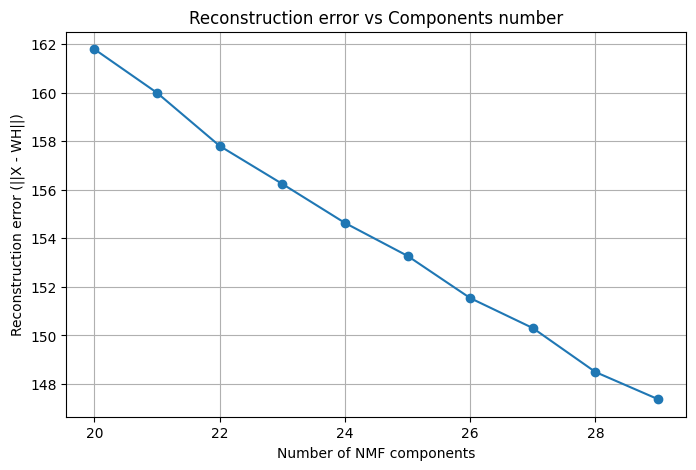

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(list(components_range), errors_nmf, marker='o')
plt.xlabel("Number of NMF components")
plt.ylabel("Reconstruction error (||X - WH||)")
plt.title("Reconstruction error vs Components number")
plt.grid(True)
plt.show()

A comparison was performed between the original images and their NMF-based reconstructions, accompanied by heatmaps visualizing the reconstruction error at the pixel level. Due to the significant downsampling from the original high resolution of 600×450 pixels to 64×64 pixels, a considerable loss of detail is evident, resulting in noticeably blurred images. Despite this loss in resolution, the central lesion generally remains visible and identifiable in the reconstructed images.

The application of NMF leads to a substantial reduction in feature dimensionality. The regions of normal skin—areas not affected by the pigmented lesion—are reconstructed with relatively high fidelity, showing minimal visual differences compared to the originals. Interestingly, common artifacts such as hair are not prominently captured or reproduced in the reconstructions, suggesting that NMF may implicitly filter out such noise.

The error heatmaps, computed as the absolute mean difference across RGB channels per pixel, reveal that the largest reconstruction errors are predominantly localized around the lesion borders. This observation aligns with the known limitation of NMF in modeling sharp edges and complex texture variations, as it tends to approximate images with additive, smooth basis components. Consequently, the reconstruction struggles to accurately represent fine structural details and boundary variations, leading to higher errors in these regions.

Overall, while NMF effectively captures the general appearance of healthy skin and provides a compressed representation, it has limited capacity to preserve intricate lesion boundaries and fine-grained texture, which are often crucial for clinical interpretation.

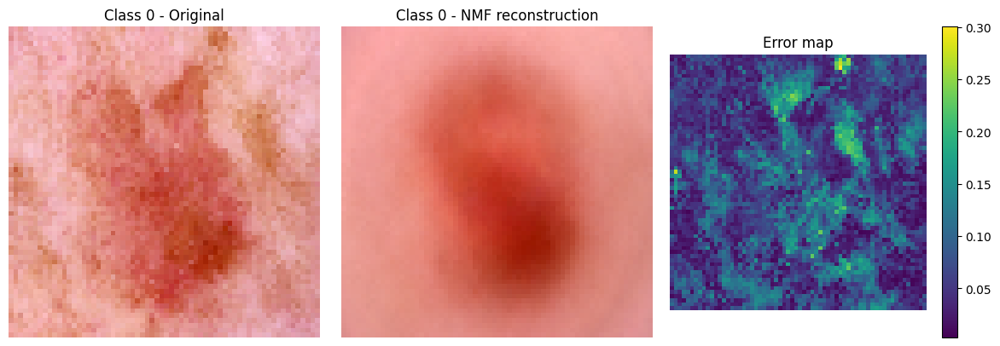

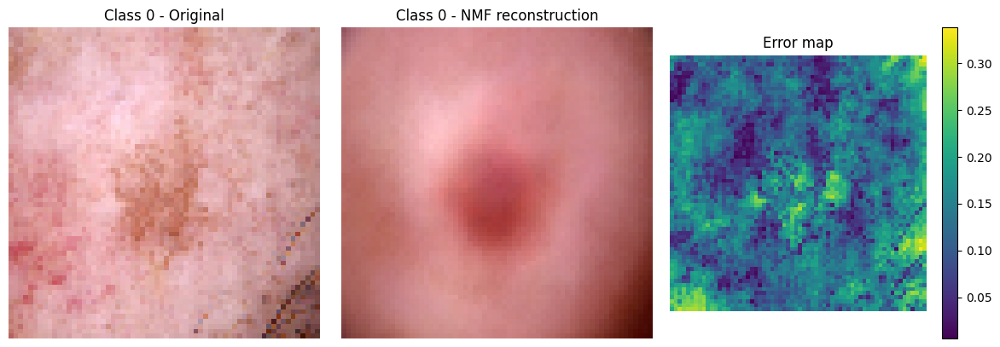

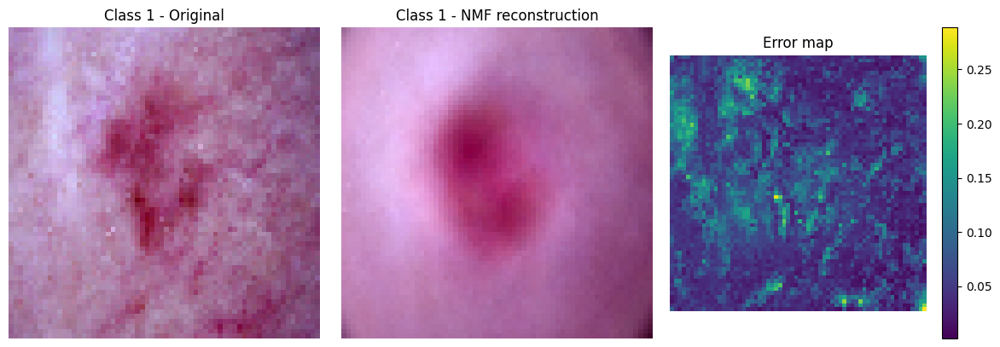

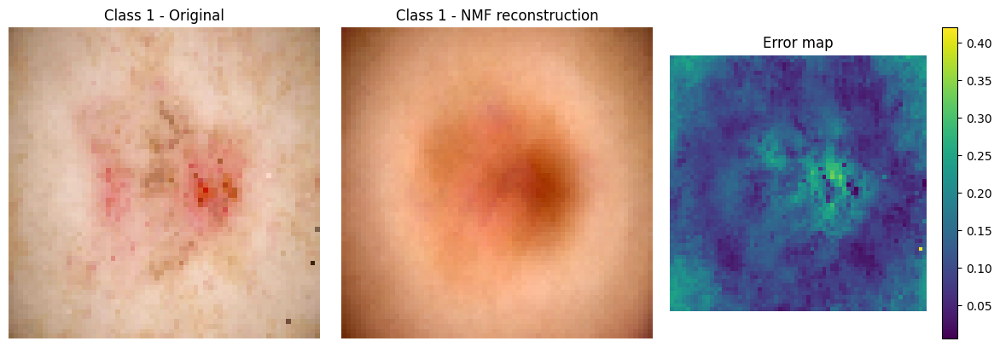

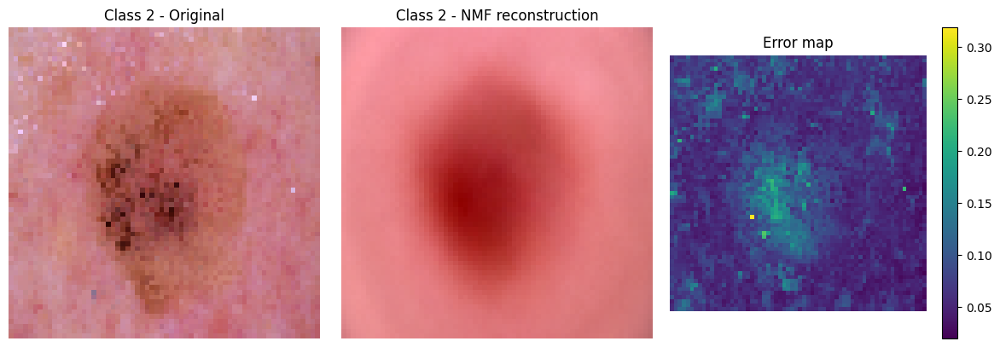

...

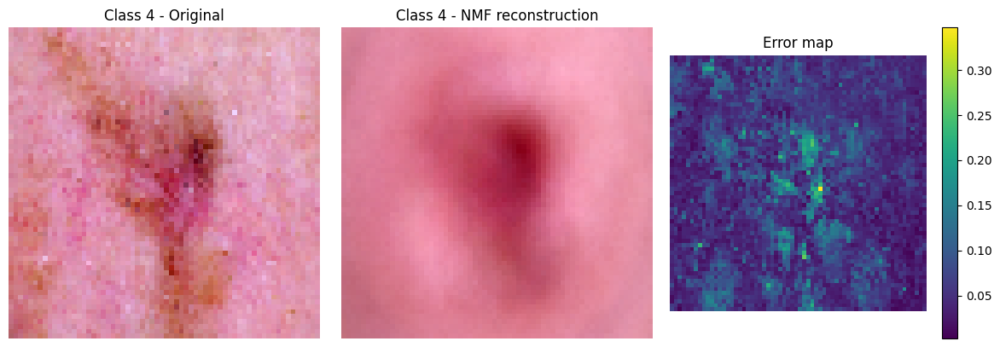

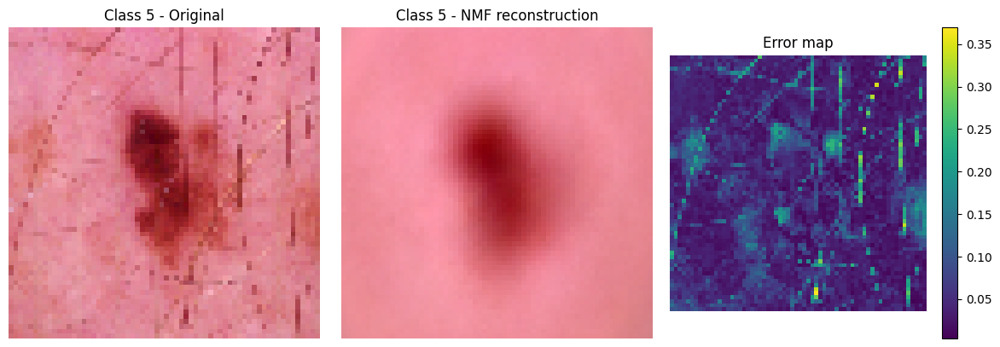

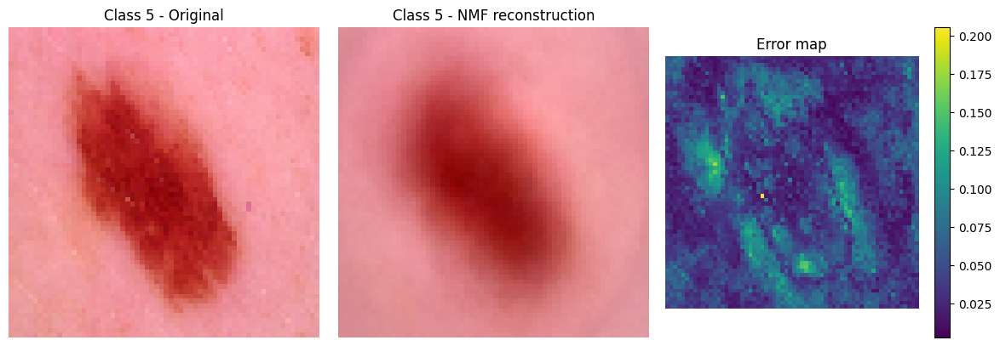

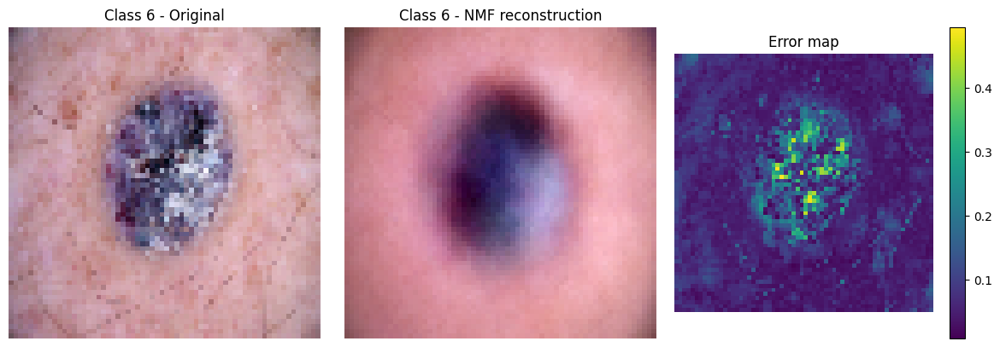

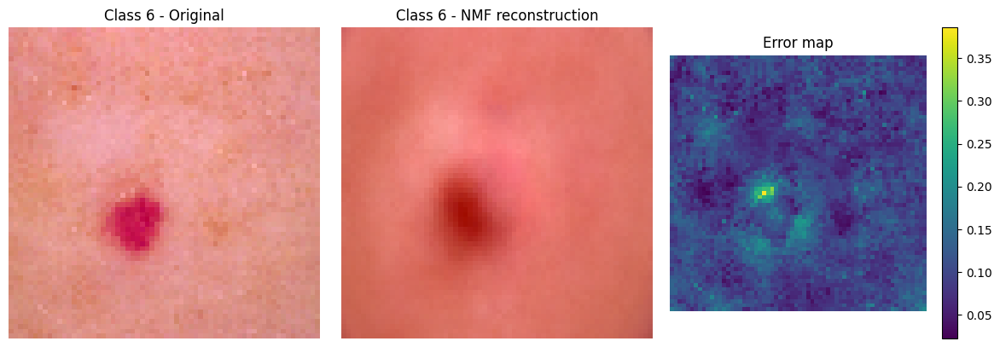

In [ ]:
num_per_class = 2
unique_classes = np.unique(y_balanced)

for cls in unique_classes:
    cls_indices = df_sampled[df_sampled['label'] == cls].index.tolist()
    selected = np.random.choice(cls_indices, size=min(num_per_class, len(cls_indices)), replace=False)

    for idx in selected:
        idx_flat = df_sampled.index.get_loc(idx)

        original = X_flat[idx_flat].reshape(64, 64, 3)
        reconstructed = X_approx[idx_flat].reshape(64, 64, 3)

        #Normalization
        original_norm = (original - original.min()) / (original.max() - original.min())
        reconstructed_norm = (reconstructed - reconstructed.min()) / (reconstructed.max() - reconstructed.min())

        #Absolute mean difference over the channel (map of the error)
        diff_map = np.abs(original_norm - reconstructed_norm).mean(axis=2)  #shape (64, 64)

        #Plot of original, reconstruced and map of the error
        fig, axs = plt.subplots(1, 3, figsize=(12, 4))
        axs[0].imshow(original_norm)
        axs[0].set_title(f"Class {cls} - Original")
        axs[1].imshow(reconstructed_norm)
        axs[1].set_title(f"Class {cls} - NMF reconstruction")
        im = axs[2].imshow(diff_map, cmap='viridis')
        axs[2].set_title("Error map")
        fig.colorbar(im, ax=axs[2])
        for ax in axs:
            ax.axis('off')
        plt.tight_layout()
        plt.show()


After applying NMF with 29 and 50 components, we observed a moderate reduction in reconstruction error (from approximately 148 to 129). However, the qualitative difference between the reconstructed images is limited. This suggests that, beyond a certain number of components, NMF yields diminishing returns in visual quality, especially when working with already downscaled images (64×64).
As a next step, increasing the image resolution (e.g., 96×96 or 128×128) could help preserve more structural detail and improve reconstruction fidelity.

In [ ]:
n_components = 50
nmf_50 = NMF(n_components=n_components, init='nndsvda', max_iter=1000, random_state=42)
W_50 = nmf_50.fit_transform(X_flat)
H_50 = nmf_50.components_
X_approx_50 = np.dot(W_50, H_50)

print(f"Calculated NMF with {n_components} components.")

Calculated NMF with 50 components.


Reconstruction error with 50 components: 129.17


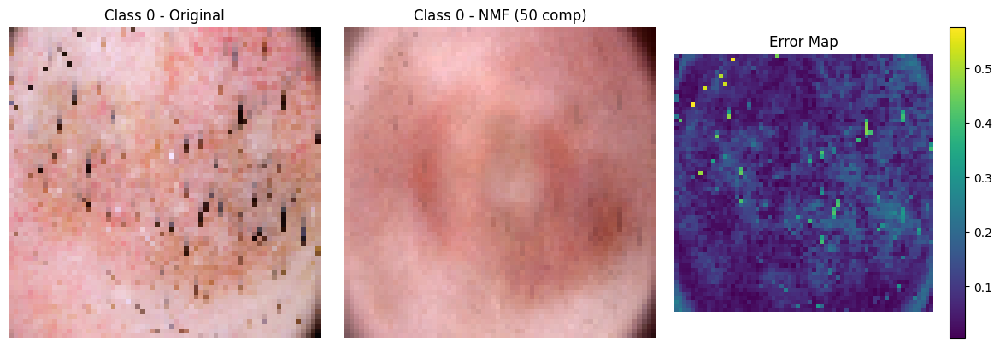

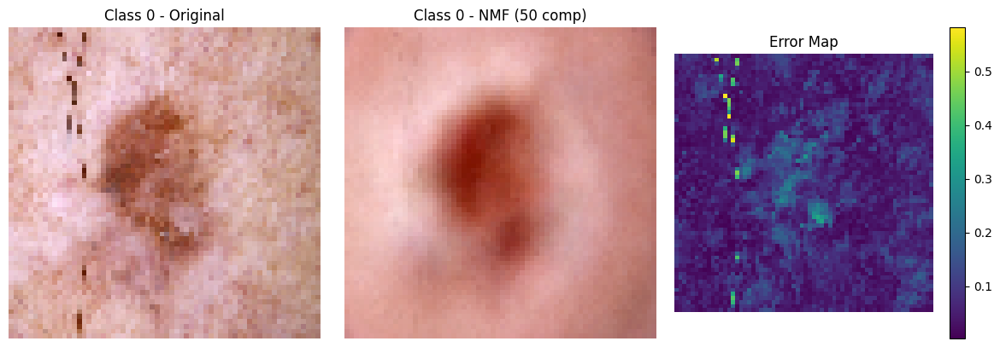

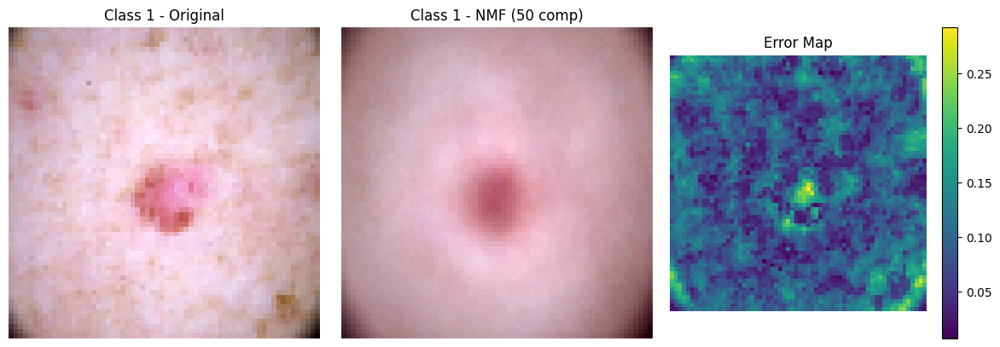

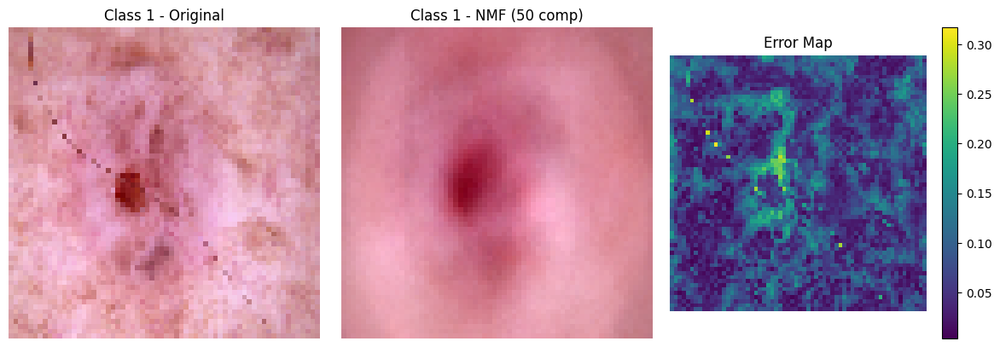

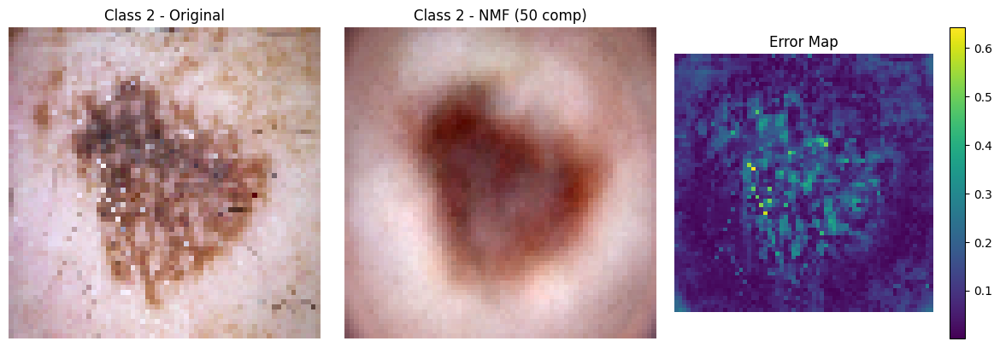

...

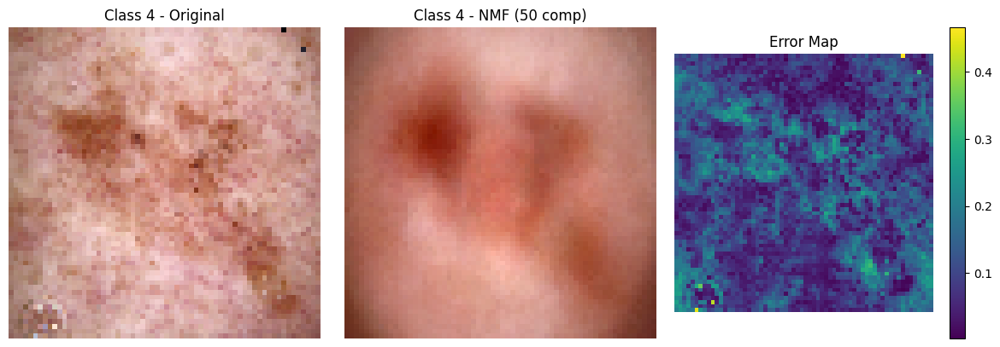

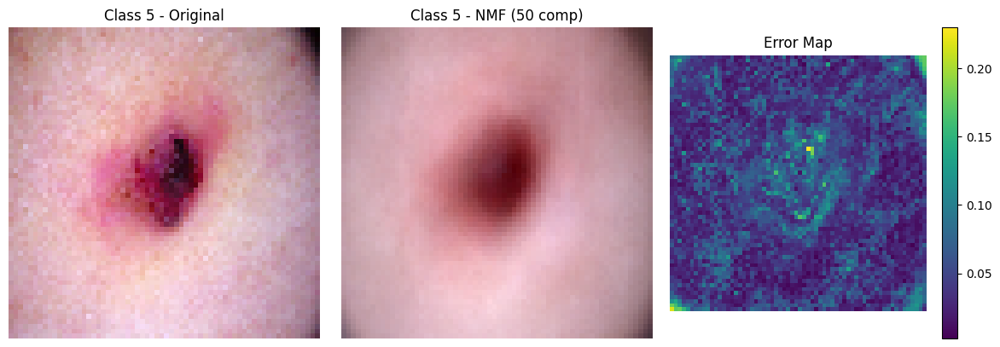

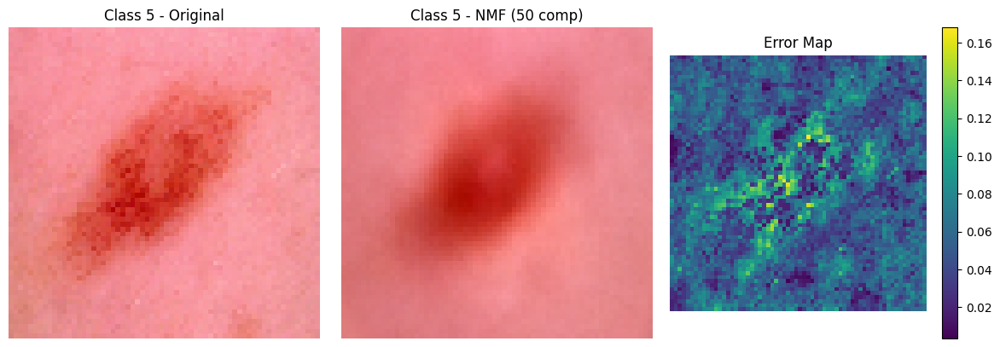

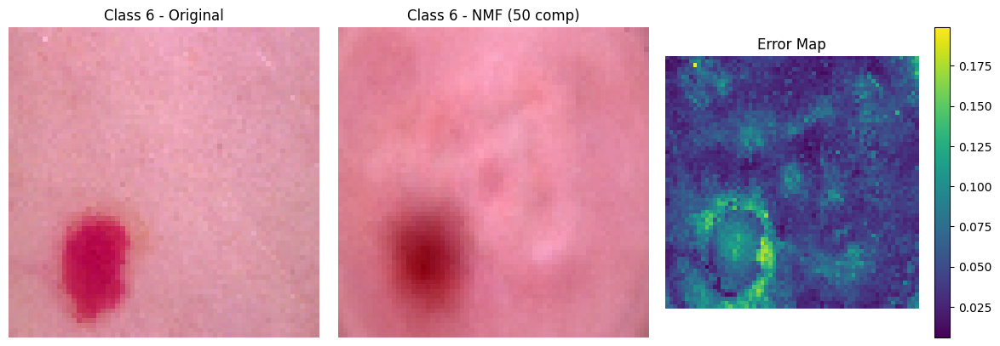

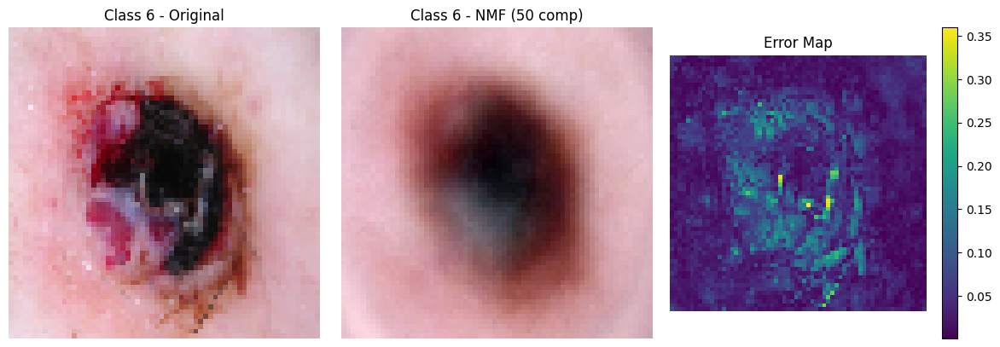

In [ ]:
reconstruction_error_50 = np.linalg.norm(X_flat - X_approx_50)
print(f"Reconstruction error with 50 components: {reconstruction_error_50:.2f}")


for cls in unique_classes:
    cls_indices = df_sampled[df_sampled['label'] == cls].index.tolist()
    selected = np.random.choice(cls_indices, size=min(num_per_class, len(cls_indices)), replace=False)

    for idx in selected:
        idx_flat = df_sampled.index.get_loc(idx)

        original = X_flat[idx_flat].reshape(64, 64, 3)
        reconstructed = X_approx_50[idx_flat].reshape(64, 64, 3)  # <-- usa X_approx_50

        original_norm = (original - original.min()) / (original.max() - original.min())
        reconstructed_norm = (reconstructed - reconstructed.min()) / (reconstructed.max() - reconstructed.min())
        diff_map = np.abs(original_norm - reconstructed_norm).mean(axis=2)

        fig, axs = plt.subplots(1, 3, figsize=(12, 4))
        axs[0].imshow(original_norm)
        axs[0].set_title(f"Class {cls} - Original")
        axs[1].imshow(reconstructed_norm)
        axs[1].set_title(f"Class {cls} - NMF (50 comp)")
        im = axs[2].imshow(diff_map, cmap='viridis')
        axs[2].set_title("Error Map")
        fig.colorbar(im, ax=axs[2])
        for ax in axs:
            ax.axis('off')
        plt.tight_layout()
        plt.show()


*NMF on 128x128 images*

In [ ]:
pip install tqdm_joblib

In [ ]:
from joblib import Parallel, delayed
from tqdm import tqdm
from tqdm_joblib import tqdm_joblib

In [ ]:
df_subset_128 = pd.DataFrame({
    'image': list(X_128),
    'label': y_128
})

#Balanced samples(100 for each class)
df_sampled = df_subset_128.groupby('label', group_keys=False).apply(
    lambda x: x.sample(n=100, random_state=42)
)

#Balanced arrays
X_balanced_128 = np.stack(df_sampled['image'].values)
y_balanced_128 = df_sampled['label'].values



In [ ]:
X_flat_128 = X_balanced_128.reshape((X_balanced_128.shape[0], -1))  # shape: (N, 128×128×3 = 49152) flattening the images
X_flat_128.shape

(700, 49152)

In [ ]:
def run_nmf(n_comp, X):
    nmf = NMF(n_components=n_comp, init='nndsvda', max_iter=1000, random_state=42)
    W_128 = nmf.fit_transform(X)
    H_128 = nmf.components_
    X_approx_128 = np.dot(W_128, H_128)
    error_128 = np.linalg.norm(X - X_approx_128)
    return n_comp, error_128, W_128, H_128

components_range = range(30, 41)

with tqdm_joblib(tqdm(desc="NMF Parallel 128x128", total=len(components_range))) as progress_bar:
    results_128 = Parallel(n_jobs=-1)(
        delayed(run_nmf)(n, X_flat_128) for n in components_range
    )

nmf_results_128 = {
    n: {
        'reconstruction_error': err,
        'W': W,
        'H': H
    }
    for n, err, W, H in results_128
}


From the analysis of the reconstruction error trend, it is clear that the reconstructed images exhibit a higher error when using higher resolution inputs. This phenomenon is primarily due to the increased dimensionality of the data—images resized to 128×128 pixels contain four times more features than those at 64×64 resolution. Consequently, a significantly larger number of components is required in the NMF decomposition to adequately capture the increased complexity and detail of the images. If the number of components is not scaled accordingly, the model’s ability to reconstruct fine details diminishes, resulting in more blurred reconstructions. This effect is expected given the additive and part-based nature of NMF, which tends to approximate global features rather than high-frequency local details.


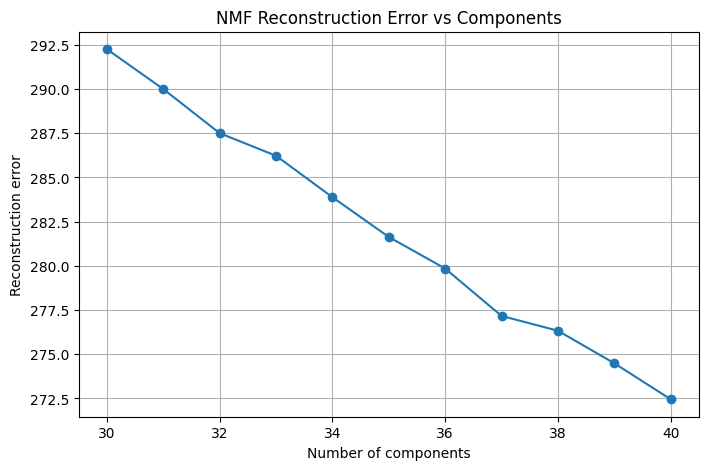

In [ ]:
components = sorted(nmf_results_128.keys())
errors = [nmf_results_128[n]['reconstruction_error'] for n in components]

plt.figure(figsize=(8, 5))
plt.plot(components, errors, marker='o')
plt.xlabel('Number of components')
plt.ylabel('Reconstruction error')
plt.title('NMF Reconstruction Error vs Components')
plt.grid(True)
plt.show()


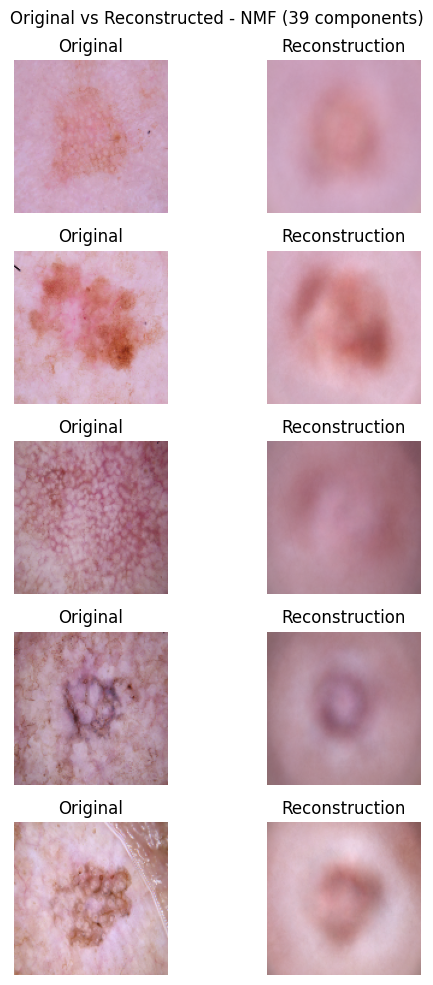

In [ ]:
#Take W e H for a specific number of components
n_components_to_show = 39
W = nmf_results_128[n_components_to_show]['W']
H = nmf_results_128[n_components_to_show]['H']
X_approx_128 = np.dot(W, H)


num_images = 5
indices = [0, 1, 2, 3, 4]

fig, axes = plt.subplots(num_images, 2, figsize=(6, 10))

for i, idx in enumerate(indices):
    # Reshape to the original 3D shape (height, width, channels)
    original = X_flat_128[idx].reshape(128, 128, 3)
    reconstructed = X_approx_128[idx].reshape(128, 128, 3)

    axes[i, 0].imshow(original) #imshow can handle 3D arrays directly
    axes[i, 0].set_title("Original")
    axes[i, 0].axis('off')

    axes[i, 1].imshow(reconstructed)
    axes[i, 1].set_title("Reconstruction")
    axes[i, 1].axis('off')

plt.suptitle(f"Original vs Reconstructed - NMF ({n_components_to_show} components)")
plt.tight_layout()
plt.show()


From the results, it is evident that the reconstruction error decreases significantly in the range of 90 to 100 components. The decline in error appears consistent and steady, indicating that increasing the number of components improves the approximation quality.

Qualitatively, the reconstructed images at this resolution are noticeably better compared to lower component counts. However, the reconstruction error does not seem to reach a clear minimum within this range, suggesting that further improvements would require substantially higher computational resources.

Given this trade-off between computational cost and reconstruction quality, it is reasonable to consider alternative modeling approaches, such as autoencoders, which may achieve better performance or efficiency for this task.


In [ ]:
components_range = range(90, 101)

with tqdm_joblib(tqdm(desc="NMF 128x128 (90–100)", total=len(components_range))) as progress_bar:
    results_128_ext = Parallel(n_jobs=-1)(
        delayed(run_nmf)(n, X_flat_128) for n in components_range
    )

# Aggiunge i nuovi risultati mantenendo quelli vecchi
for n, err, W, H in results_128_ext:
    nmf_results_128[n] = {
        'reconstruction_error': err,
        'W': W,
        'H': H
    }


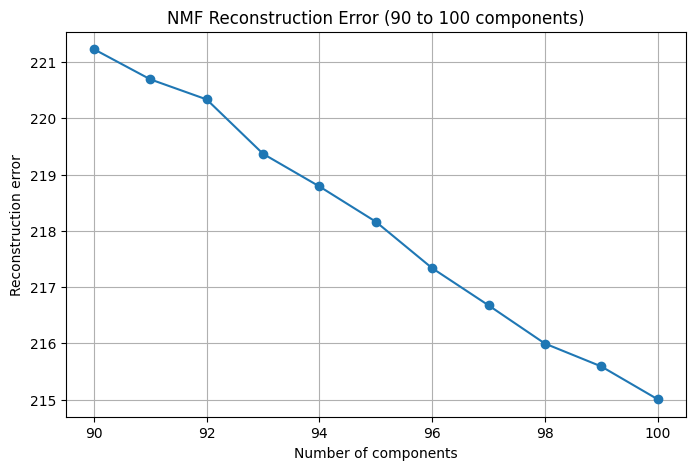

In [ ]:
components = [n for n in sorted(nmf_results_128.keys()) if 90 <= n <= 100]
errors = [nmf_results_128[n]['reconstruction_error'] for n in components]

plt.figure(figsize=(8,5))
plt.plot(components, errors, marker='o')
plt.xlabel('Number of components')
plt.ylabel('Reconstruction error')
plt.title('NMF Reconstruction Error (90 to 100 components)')
plt.grid(True)
plt.show()



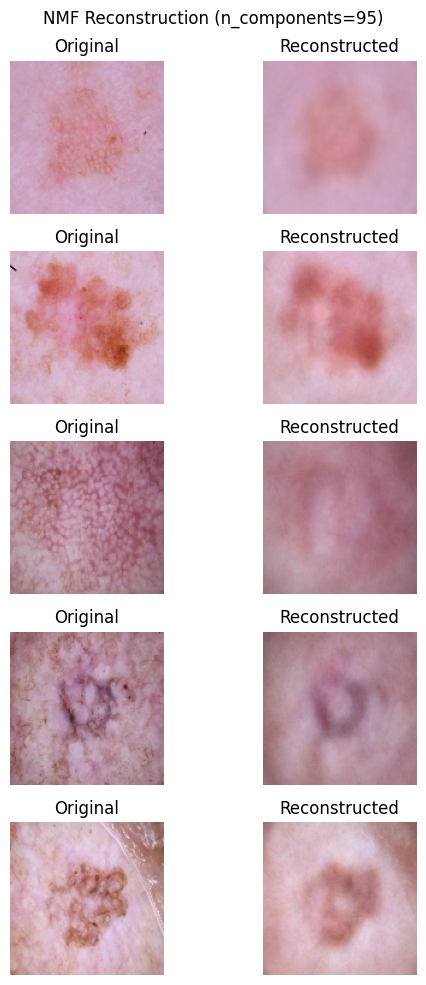

In [ ]:
n_components_show = 95  # o 100

W = nmf_results_128[n_components_show]['W']
H = nmf_results_128[n_components_show]['H']
X_approx = np.dot(W, H)

num_images = 5
indices = [0,1,2,3,4]

fig, axes = plt.subplots(num_images, 2, figsize=(6,10))

for i, idx in enumerate(indices):
    # Reshape to the original 3D shape (height, width, channels)
    original = X_flat_128[idx].reshape(128, 128, 3) # Reshape to include 3 channels
    reconstructed = X_approx[idx].reshape(128, 128, 3)

    axes[i,0].imshow(original) # imshow can handle 3D arrays directly
    axes[i,0].set_title('Original')
    axes[i,0].axis('off')

    axes[i,1].imshow(reconstructed)
    axes[i,1].set_title('Reconstructed')
    axes[i,1].axis('off')

plt.suptitle(f'NMF Reconstruction (n_components={n_components_show})')
plt.tight_layout()
plt.show()

 We decided to work with 224×224 images, also considering the use of transfer learning models for classification. In this context, NNF proved to be an effective technique for reconstructing images. However, using higher-resolution images would be computationally expensive and not efficient. An alternative could be the implementation of a convolutional autoencoder to achieve a nonlinear reconstruction of the image. Nevertheless, we prefer to proceed with an approach based on image segmentation and the extraction of features from the segmented regions.

## Segmentation using U-Net

This code implements a complete semantic segmentation pipeline for the identification of skin lesions in dermatoscopic images. The masks are first resized and normalized to ensure alignment with the corresponding input images, and the images themselves are normalized using standard ImageNet statistics to allow for effective use of pretrained backbones. Data augmentation is applied using Albumentations and includes random horizontal and vertical flips, rotations, and scaling, which help improve generalization and robustness. The dataset is managed through a custom PyTorch Dataset class, and loaded efficiently using a DataLoader with batching and shuffling. During training, a model such as U-Net is optimized using a combination of binary cross-entropy loss and Dice loss, with Adam optimizer. Evaluation is performed using metrics like Intersection over Union (IoU), Dice coefficient. Predicted masks can be visualized by overlaying them on the original images to qualitatively assess segmentation quality.

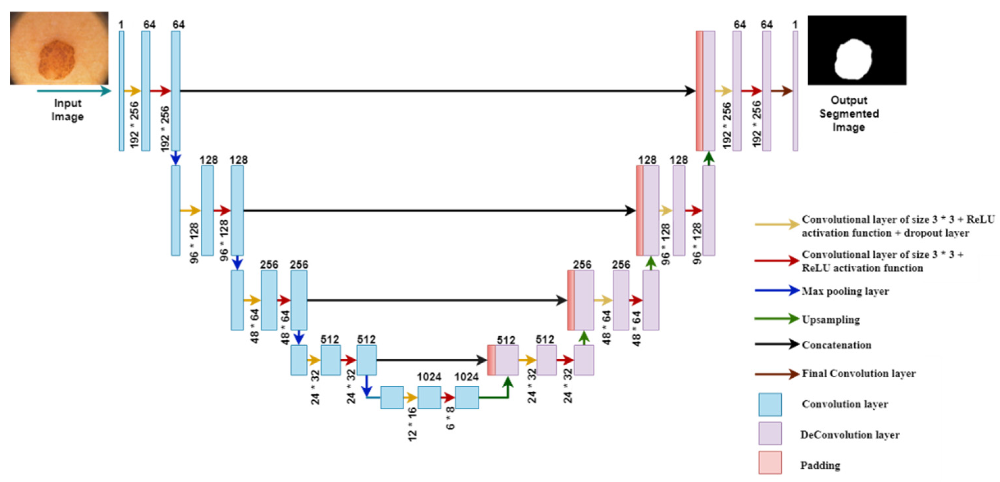

In [ ]:
import os
import pandas as pd
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import albumentations as A
from albumentations.pytorch import ToTensorV2
import segmentation_models_pytorch as smp
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from torch.cuda.amp import autocast, GradScaler
from PIL import Image
from tqdm import tqdm

In [ ]:
df=pd.read_csv('/notebooks/HAM10000_metadata.csv')

In [ ]:
df

,lesion_id,image_id,dx,dx_type,age,sex,localization,dataset
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,vidir_modern
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,vidir_modern
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,vidir_modern
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,vidir_modern
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,vidir_modern
...,...,...,...,...,...,...,...,...
10010,HAM_0002867,ISIC_0033084,akiec,histo,40.0,male,abdomen,vidir_modern
10011,HAM_0002867,ISIC_0033550,akiec,histo,40.0,male,abdomen,vidir_modern
10012,HAM_0002867,ISIC_0033536,akiec,histo,40.0,male,abdomen,vidir_modern
10013,HAM_0000239,ISIC_0032854,akiec,histo,80.0,male,face,vidir_modern


In [ ]:
img_folder = '/notebooks/Pre-Processate/Pre-Processate'
mask_folder = '/notebooks/Segmentations/segmentations_resized'

df['image_path'] = df['image_id'].apply(lambda x: os.path.join(img_folder, x + ".jpg"))
df['mask_path'] = df['image_id'].apply(lambda x: os.path.join(mask_folder, x + "_segmentation.png"))

In [ ]:
from sklearn.model_selection import train_test_split

df_sampled, df_test = train_test_split(
    df,
    test_size=0.2,
    stratify=df['dx'],
    random_state=42
)

df_train, df_val = train_test_split(
    df_sampled,
    test_size=0.2,
    stratify=df_sampled['dx'],
    random_state=42
)

In [ ]:
class MoleSegmentationDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        img_path = self.df.loc[idx, 'image_path']
        mask_path = self.df.loc[idx, 'mask_path']

        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

        mask = mask.astype('float32')
        mask = mask / mask.max() if mask.max() > 0 else mask  # scala a [0,1]
        mask = (mask > 0.5).astype('float32')  # binarizza

        if self.transform:
            augmented = self.transform(image=image, mask=mask)
            image = augmented['image']
            mask = augmented['mask']

        mask = torch.tensor(mask).unsqueeze(0)  # CxHxW

        return image, mask

Augmentation phase, flipping, rotating and shifting images.

In [ ]:
train_transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2(),
])

val_transform = A.Compose([
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2(),
])

test_transform = val_transform

In [ ]:
train_dataset = MoleSegmentationDataset(df_train, transform=train_transform)
val_dataset = MoleSegmentationDataset(df_val, transform=val_transform)
test_dataset = MoleSegmentationDataset(df_test, transform=test_transform)

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, num_workers=2, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False, num_workers=2, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, num_workers=2, pin_memory=True)


The model used is a U-Net with a ResNet34 encoder, pre-trained on ImageNet. And it outputs a single-channel segmentation map.

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = smp.Unet(
    encoder_name="resnet34",
    encoder_weights="imagenet",
    in_channels=3,
    classes=1,
    activation=None,
)

model.to(device)

The encoder is frozen during the initial training epochs to retain learned features. And it's unfrozen after a few epochs to fine-tune the entire model.

In [ ]:
def freeze_encoder(model):
    for param in model.encoder.parameters():
        param.requires_grad = False
    print("Encoder freezed")

def unfreeze_encoder(model):
    for param in model.encoder.parameters():
        param.requires_grad = True
    print("Encoder unfreezed")

A combined loss function is used, averaging Binary Cross Entropy and Dice Loss to balance pixel-wise accuracy and mask overlap.

In [ ]:
class DiceLoss(nn.Module):
    def __init__(self):
        super(DiceLoss, self).__init__()

    def forward(self, inputs, targets, smooth=1):
        inputs = torch.sigmoid(inputs)
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        intersection = (inputs * targets).sum()
        dice = (2. * intersection + smooth) / (inputs.sum() + targets.sum() + smooth)
        return 1 - dice

bce_loss = nn.BCEWithLogitsLoss()
dice_loss = DiceLoss()

def combined_loss(preds, targets):
    return 0.5 * bce_loss(preds, targets) + 0.5 * dice_loss(preds, targets)

In [ ]:
optimizer = optim.Adam(model.parameters(), lr=1e-4)
scaler = GradScaler()

Training is done using mixed-precision to optimize performance and memory use.
After each epoch, validation metrics such as:

**-Dice Score
-IoU
-Sensitivity
-Specificity**   are computed to assess model performance.
Best-performing model (based on validation loss) is saved.
Intermediate checkpoints are stored every few epochs.

In [ ]:
def dice_score(preds, targets, threshold=0.5):
    preds = torch.sigmoid(preds)
    preds = (preds > threshold).float()
    intersection = (preds * targets).sum()
    return (2. * intersection) / (preds.sum() + targets.sum() + 1e-8)

def iou_score(preds, targets, threshold=0.5):
    preds = torch.sigmoid(preds)
    preds = (preds > threshold).float()

    intersection = (preds * targets).sum()
    union = preds.sum() + targets.sum() - intersection
    return (intersection + 1e-8) / (union + 1e-8)

def sensitivity_score(preds, targets, threshold=0.5):
    preds = torch.sigmoid(preds)
    preds = (preds > threshold).float()

    tp = (preds * targets).sum()
    fn = ((1 - preds) * targets).sum()
    return (tp + 1e-8) / (tp + fn + 1e-8)

def specificity_score(preds, targets, threshold=0.5):
    preds = torch.sigmoid(preds)
    preds = (preds > threshold).float()

    tn = ((1 - preds) * (1 - targets)).sum()
    fp = (preds * (1 - targets)).sum()
    return (tn + 1e-8) / (tn + fp + 1e-8)



In [ ]:
def train_one_epoch(model, dataloader, optimizer, device, scaler):
    model.train()
    running_loss = 0
    for images, masks in dataloader:
        images = images.to(device, non_blocking=True)
        masks = masks.to(device, non_blocking=True)

        optimizer.zero_grad()
        with autocast():
            outputs = model(images)
            loss = combined_loss(outputs, masks)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        running_loss += loss.item() * images.size(0)
    return running_loss / len(dataloader.dataset)

def validate(model, dataloader, device):
    model.eval()
    running_loss = 0
    running_dice = 0
    running_iou = 0
    running_sensitivity = 0
    running_specificity = 0

    with torch.no_grad():
        for images, masks in dataloader:
            images = images.to(device, non_blocking=True)
            masks = masks.to(device, non_blocking=True)

            outputs = model(images)
            loss = combined_loss(outputs, masks)
            dice = dice_score(outputs, masks)
            iou = iou_score(outputs, masks)
            sensitivity = sensitivity_score(outputs, masks)
            specificity = specificity_score(outputs, masks)

            bs = images.size(0)
            running_loss += loss.item() * bs
            running_dice += dice.item() * bs
            running_iou += iou.item() * bs
            running_sensitivity += sensitivity.item() * bs
            running_specificity += specificity.item() * bs

    val_loss = running_loss / len(dataloader.dataset)
    val_dice = running_dice / len(dataloader.dataset)
    val_iou = running_iou / len(dataloader.dataset)
    val_sensitivity = running_sensitivity / len(dataloader.dataset)
    val_specificity = running_specificity / len(dataloader.dataset)

    return val_loss, val_dice, val_iou, val_sensitivity, val_specificity

In [ ]:
freeze_encoder(model)  # congeliamo encoder all'inizio

num_epochs = 25
unfreeze_at = 5  # epoca in cui sbloccare encoder
checkpoint_dir = "/notebooks/checkpoints"
os.makedirs(checkpoint_dir, exist_ok=True)
best_val_loss = float('inf')

for epoch in range(num_epochs):
    if epoch == unfreeze_at:
        unfreeze_encoder(model)
        optimizer = optim.Adam(model.parameters(), lr=1e-4)

    train_loss = train_one_epoch(model, train_loader, optimizer, device, scaler)
    val_loss, val_dice, val_iou, val_sensitivity, val_specificity = validate(model, val_loader, device)

    print(f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f} - "
          f"Val Loss: {val_loss:.4f} - Val Dice: {val_dice:.4f} - "
          f"Val IoU: {val_iou:.4f} - Val Sensitivity: {val_sensitivity:.4f} - "
          f"Val Specificity: {val_specificity:.4f}")

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        best_model_path = os.path.join(checkpoint_dir, "best_model.pth")
        torch.save(model.state_dict(), best_model_path)
        print(f"🔧 Miglior modello salvato: {best_model_path}")

    if (epoch + 1) % 5 == 0:
        checkpoint_path = os.path.join(checkpoint_dir, f"model_epoch_{epoch+1}.pth")
        torch.save(model.state_dict(), checkpoint_path)
        print(f"Checkpoint salvato: {checkpoint_path}")

final_model_path = os.path.join(checkpoint_dir, "unet.pth")
torch.save(model.state_dict(), final_model_path)
print(f"Modello finale salvato: {final_model_path}")


Encoder congelato


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 1/25 - Train Loss: 0.2323 - Val Loss: 0.1479 - Val Dice: 0.8949 - Val IoU: 0.8125 - Val Sensitivity: 0.8895 - Val Specificity: 0.9674
🔧 Miglior modello salvato: /notebooks/checkpoints/best_model.pth


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 2/25 - Train Loss: 0.1537 - Val Loss: 0.1291 - Val Dice: 0.9057 - Val IoU: 0.8302 - Val Sensitivity: 0.8998 - Val Specificity: 0.9707
🔧 Miglior modello salvato: /notebooks/checkpoints/best_model.pth


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 3/25 - Train Loss: 0.1322 - Val Loss: 0.1284 - Val Dice: 0.9059 - Val IoU: 0.8302 - Val Sensitivity: 0.9258 - Val Specificity: 0.9594
🔧 Miglior modello salvato: /notebooks/checkpoints/best_model.pth


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 4/25 - Train Loss: 0.1245 - Val Loss: 0.1171 - Val Dice: 0.9119 - Val IoU: 0.8406 - Val Sensitivity: 0.8943 - Val Specificity: 0.9780
🔧 Miglior modello salvato: /notebooks/checkpoints/best_model.pth


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 5/25 - Train Loss: 0.1185 - Val Loss: 0.1196 - Val Dice: 0.9111 - Val IoU: 0.8392 - Val Sensitivity: 0.9112 - Val Specificity: 0.9694
Checkpoint salvato: /notebooks/checkpoints/model_epoch_5.pth
Encoder sbloccato


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 6/25 - Train Loss: 0.1151 - Val Loss: 0.0987 - Val Dice: 0.9267 - Val IoU: 0.8654 - Val Sensitivity: 0.9296 - Val Specificity: 0.9728
🔧 Miglior modello salvato: /notebooks/checkpoints/best_model.pth


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 7/25 - Train Loss: 0.0999 - Val Loss: 0.0956 - Val Dice: 0.9272 - Val IoU: 0.8664 - Val Sensitivity: 0.9176 - Val Specificity: 0.9786
🔧 Miglior modello salvato: /notebooks/checkpoints/best_model.pth


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 8/25 - Train Loss: 0.0958 - Val Loss: 0.0954 - Val Dice: 0.9278 - Val IoU: 0.8676 - Val Sensitivity: 0.9117 - Val Specificity: 0.9815
🔧 Miglior modello salvato: /notebooks/checkpoints/best_model.pth


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 9/25 - Train Loss: 0.0914 - Val Loss: 0.0890 - Val Dice: 0.9331 - Val IoU: 0.8765 - Val Sensitivity: 0.9339 - Val Specificity: 0.9763
🔧 Miglior modello salvato: /notebooks/checkpoints/best_model.pth


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 10/25 - Train Loss: 0.0861 - Val Loss: 0.0873 - Val Dice: 0.9342 - Val IoU: 0.8784 - Val Sensitivity: 0.9385 - Val Specificity: 0.9752
🔧 Miglior modello salvato: /notebooks/checkpoints/best_model.pth
Checkpoint salvato: /notebooks/checkpoints/model_epoch_10.pth


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 11/25 - Train Loss: 0.0835 - Val Loss: 0.0900 - Val Dice: 0.9322 - Val IoU: 0.8753 - Val Sensitivity: 0.9324 - Val Specificity: 0.9759


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 12/25 - Train Loss: 0.0836 - Val Loss: 0.0947 - Val Dice: 0.9301 - Val IoU: 0.8717 - Val Sensitivity: 0.9112 - Val Specificity: 0.9835


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 13/25 - Train Loss: 0.0776 - Val Loss: 0.0878 - Val Dice: 0.9347 - Val IoU: 0.8793 - Val Sensitivity: 0.9223 - Val Specificity: 0.9821


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 14/25 - Train Loss: 0.0765 - Val Loss: 0.0881 - Val Dice: 0.9346 - Val IoU: 0.8793 - Val Sensitivity: 0.9398 - Val Specificity: 0.9750


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 15/25 - Train Loss: 0.0759 - Val Loss: 0.0924 - Val Dice: 0.9311 - Val IoU: 0.8736 - Val Sensitivity: 0.9308 - Val Specificity: 0.9751
Checkpoint salvato: /notebooks/checkpoints/model_epoch_15.pth


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW


Epoch 17/25 - Train Loss: 0.0715 - Val Loss: 0.0893 - Val Dice: 0.9332 - Val IoU: 0.8767 - Val Sensitivity: 0.9295 - Val Specificity: 0.9783


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 18/25 - Train Loss: 0.0701 - Val Loss: 0.0957 - Val Dice: 0.9302 - Val IoU: 0.8717 - Val Sensitivity: 0.9014 - Val Specificity: 0.9876


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 19/25 - Train Loss: 0.0688 - Val Loss: 0.0911 - Val Dice: 0.9320 - Val IoU: 0.8747 - Val Sensitivity: 0.9171 - Val Specificity: 0.9827


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 20/25 - Train Loss: 0.0679 - Val Loss: 0.0882 - Val Dice: 0.9345 - Val IoU: 0.8794 - Val Sensitivity: 0.9223 - Val Specificity: 0.9820
Checkpoint salvato: /notebooks/checkpoints/model_epoch_20.pth


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 21/25 - Train Loss: 0.0656 - Val Loss: 0.1051 - Val Dice: 0.9252 - Val IoU: 0.8635 - Val Sensitivity: 0.9560 - Val Specificity: 0.9601


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 22/25 - Train Loss: 0.0651 - Val Loss: 0.0897 - Val Dice: 0.9351 - Val IoU: 0.8803 - Val Sensitivity: 0.9268 - Val Specificity: 0.9800


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 23/25 - Train Loss: 0.0642 - Val Loss: 0.0896 - Val Dice: 0.9347 - Val IoU: 0.8793 - Val Sensitivity: 0.9259 - Val Specificity: 0.9804


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 24/25 - Train Loss: 0.0629 - Val Loss: 0.0866 - Val Dice: 0.9367 - Val IoU: 0.8831 - Val Sensitivity: 0.9356 - Val Specificity: 0.9782
🔧 Miglior modello salvato: /notebooks/checkpoints/best_model.pth


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW
/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.c

Epoch 25/25 - Train Loss: 0.0599 - Val Loss: 0.0912 - Val Dice: 0.9340 - Val IoU: 0.8784 - Val Sensitivity: 0.9297 - Val Specificity: 0.9783
Checkpoint salvato: /notebooks/checkpoints/model_epoch_25.pth
Modello finale salvato: /notebooks/checkpoints/unet.pth


/tmp/ipykernel_36/2232037140.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask).unsqueeze(0)  # CxHxW


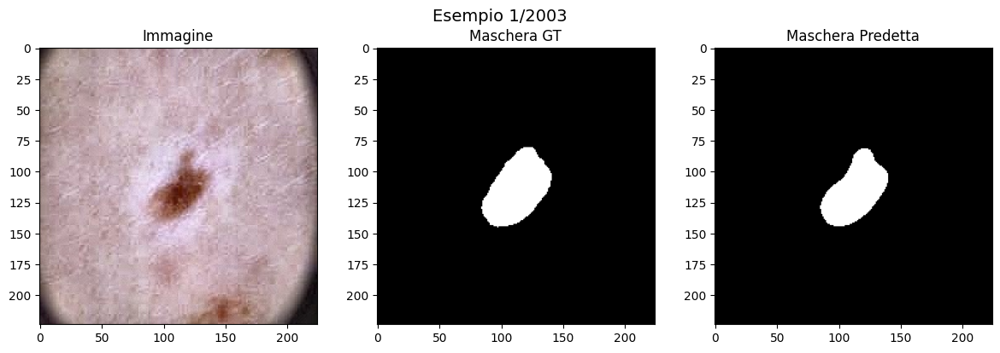

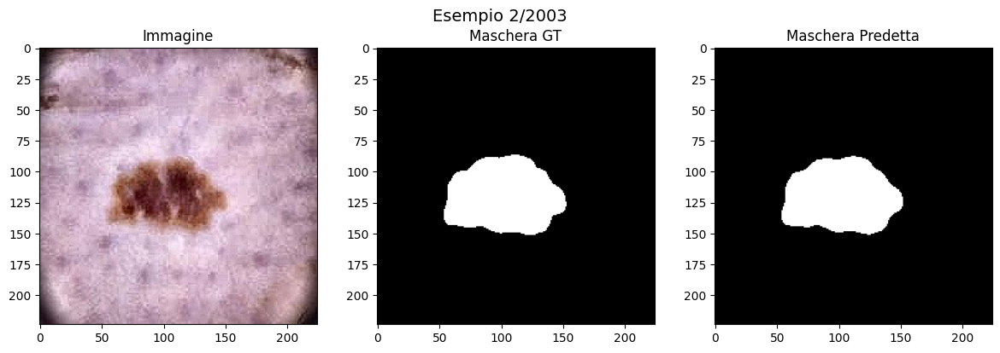

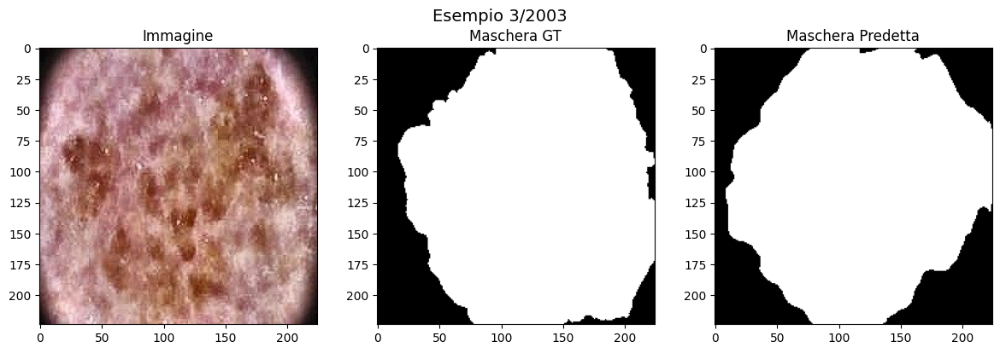

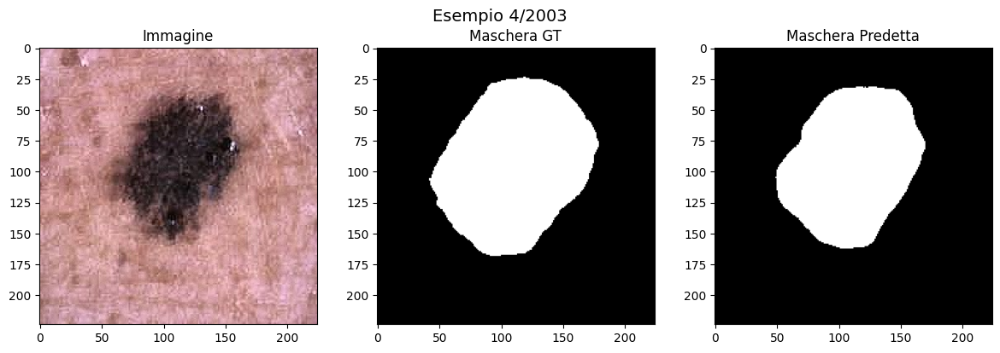

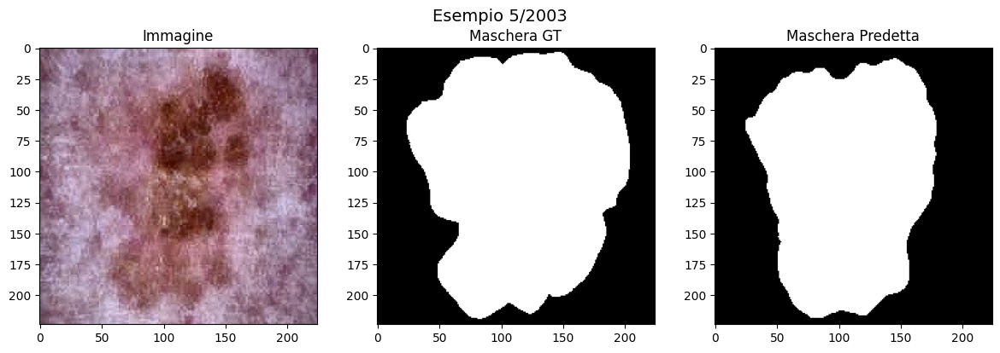

...

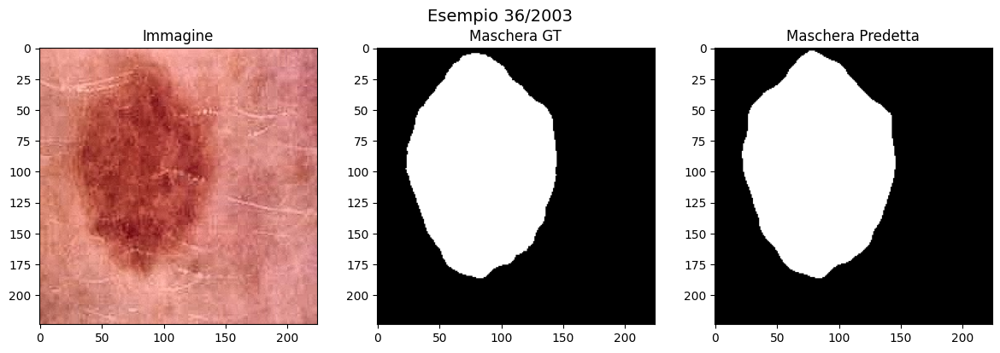

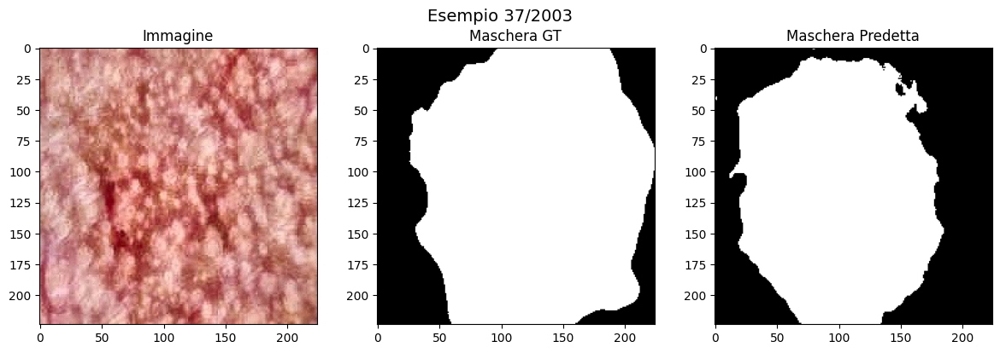

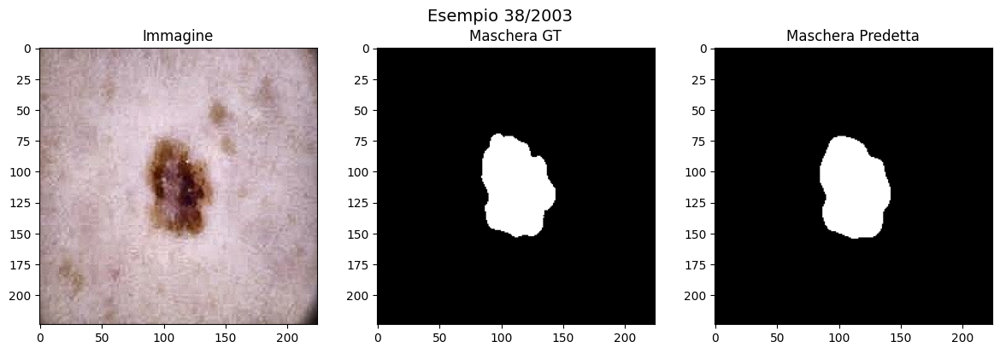

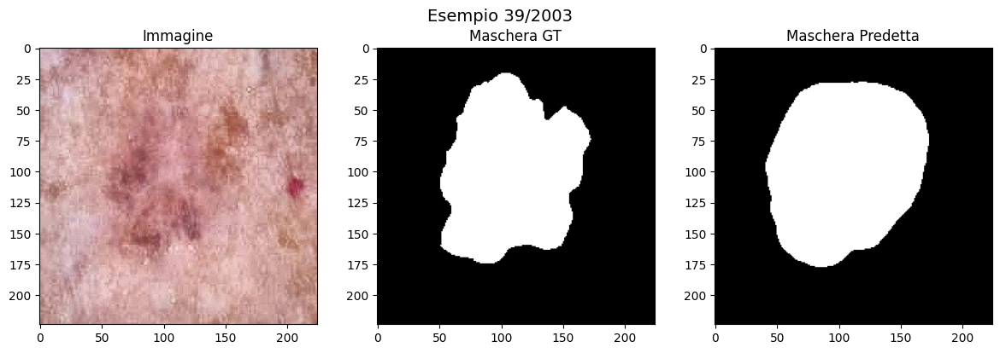

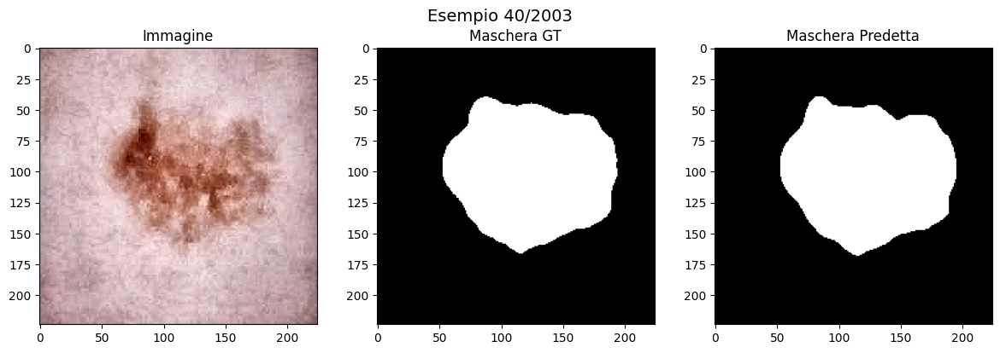

Dice medio: 0.9384
IoU medio: 0.8930
Sensitivity media: 0.9415
Specificity media: 0.9742


In [ ]:
def compute_metrics(pred, gt):
    pred = pred.astype(bool)
    gt = gt.astype(bool)

    TP = np.logical_and(pred, gt).sum()
    FP = np.logical_and(pred, ~gt).sum()
    FN = np.logical_and(~pred, gt).sum()
    TN = np.logical_and(~pred, ~gt).sum()

    dice = 2 * TP / (2 * TP + FP + FN + 1e-8)
    iou = TP / (TP + FP + FN + 1e-8)
    sensitivity = TP / (TP + FN + 1e-8)
    specificity = TN / (TN + FP + 1e-8)

    return dice, iou, sensitivity, specificity


def denormalize(tensor, mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)):
    for t, m, s in zip(tensor, mean, std):
        t.mul_(s).add_(m)
    return tensor


best_model_path = os.path.join(checkpoint_dir, "best_model.pth")
model.load_state_dict(torch.load(best_model_path, map_location=device))
model.to(device)
model.eval()


dice_scores, ious, sens_list, spec_list = [], [], [], []
num_samples = len(test_dataset)
max_vis = 40

for idx in range(num_samples):
    image, mask_gt = test_dataset[idx]
    input_tensor = image.unsqueeze(0).to(device)

    with torch.no_grad():
        output = model(input_tensor)
        pred_mask = torch.sigmoid(output).cpu().squeeze().numpy()

    pred_mask_bin = (pred_mask > 0.5).astype(np.uint8)
    mask_gt_np = mask_gt.squeeze().numpy().astype(np.uint8)


    dice, iou, sens, spec = compute_metrics(pred_mask_bin, mask_gt_np)
    dice_scores.append(dice)
    ious.append(iou)
    sens_list.append(sens)
    spec_list.append(spec)


    if idx < max_vis:
        image_denorm = denormalize(image.clone().cpu())
        img_np = image_denorm.permute(1, 2, 0).numpy()
        img_np = img_np.clip(0, 1)

        plt.figure(figsize=(12, 4))
        plt.suptitle(f'Esempio {idx+1}/{num_samples}', fontsize=14)

        plt.subplot(1, 3, 1)
        plt.title("Immagine")
        plt.imshow(img_np)

        plt.subplot(1, 3, 2)
        plt.title("Maschera GT")
        plt.imshow(mask_gt_np, cmap='gray')

        plt.subplot(1, 3, 3)
        plt.title("Maschera Predetta")
        plt.imshow(pred_mask_bin, cmap='gray')

        plt.tight_layout()
        plt.show()


print(f"Dice medio: {np.mean(dice_scores):.4f}")
print(f"IoU medio: {np.mean(ious):.4f}")
print(f"Sensitivity media: {np.mean(sens_list):.4f}")
print(f"Specificity media: {np.mean(spec_list):.4f}")


These metrics suggest the model has strong generalization and is well-balanced, making it suitable for real-world mole segmentation tasks.

We can apply the U-Net model to test images, later it will be useful. Pre-processing test images as the training samples.

In [ ]:
def dullrazor_strong(img):
    # Converti in scala di grigi
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Applica un filtro top-hat (peli sono strutture scure sottili)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (9, 9))
    blackhat = cv2.morphologyEx(gray, cv2.MORPH_BLACKHAT, kernel)

    # Migliora il contrasto del blackhat per far risaltare i peli
    _, hair_mask = cv2.threshold(blackhat, 10, 255, cv2.THRESH_BINARY)

    # Espandi la maschera (dilatazione leggera)
    kernel_dilate = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
    hair_mask = cv2.dilate(hair_mask, kernel_dilate, iterations=1)

    # Inpainting per rimuovere i peli
    result = cv2.inpaint(img, hair_mask, 3, cv2.INPAINT_TELEA)

    return result, hair_mask

def process_folder(input_folder, output_folder):
    os.makedirs(output_folder, exist_ok=True)

    for filename in os.listdir(input_folder):
        if filename.lower().endswith('.jpg'):
            img_path = os.path.join(input_folder, filename)
            save_path = os.path.join(output_folder, filename)

            # Carica immagine
            img = cv2.imread(img_path)
            if img is None:
                print(f"Errore nel caricamento di {filename}")
                continue

            # Applica dullrazor
            result, hair_mask = dullrazor_strong(img)

            # Salva risultato
            cv2.imwrite(save_path, result)

            print(f"Processed: {filename}")

We create first the test images without hairs.

In [ ]:
input_folder = "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/ISIC2018_Task3_Test_Images"
output_folder ="/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Test_Images_senza_peli"

process_folder(input_folder, output_folder)

Ther we can resize them

In [ ]:
def resize_and_normalize_images(input_folder, output_folder, size=(224, 224)):
    os.makedirs(output_folder, exist_ok=True)

    image_files = [f for f in os.listdir(input_folder) if f.lower().endswith('.jpg')]

    for filename in tqdm(image_files, desc="Ridimensionamento e normalizzazione immagini"):
        img_path = os.path.join(input_folder, filename)
        save_path = os.path.join(output_folder, filename)

        try:
            with Image.open(img_path) as img:
                img = img.convert("RGB")
                img = img.resize(size, Image.LANCZOS)

                img_array = np.array(img).astype(np.float32) / 255.0  # valori in [0,1]

                img_to_save = (img_array * 255).astype(np.uint8)
                img_out = Image.fromarray(img_to_save)
                img_out.save(save_path)

        except Exception as e:
            print(f"Errore con file {filename}: {e}")


In [ ]:
resize_and_normalize_images(
    input_folder="/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Test_Images_senza_peli",
    output_folder="/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Test_senza_peli_224",
    size=(224, 224)
)

The same preprocessing make on the images used to train the UNet has to be done here so:

In [ ]:
soft_kernel = np.array([[0, -0.5, 0],
                        [-0.5, 3, -0.5],
                        [0, -0.5, 0]])

def apply_sharpen(img, kernel):
    return cv2.filter2D(img, -1, kernel)

def apply_clahe(img, clipLimit=2.0):
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=clipLimit, tileGridSize=(8,8))
    cl = clahe.apply(l)
    limg = cv2.merge((cl, a, b))
    return cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)

def sharpen_and_clahe_folder(
    input_folder,
    output_folder,
    kernel=soft_kernel,
    clipLimit=2.0
):
    os.makedirs(output_folder, exist_ok=True)
    files = [f for f in os.listdir(input_folder) if f.lower().endswith('.jpg')]
    for f in tqdm(files, desc="Nitidezza + CLAHE"):
        path_in = os.path.join(input_folder, f)
        path_out = os.path.join(output_folder, f)
        img = cv2.imread(path_in)
        if img is None:
            print(f"Immagine non caricata: {f}")
            continue
        img = apply_sharpen(img, kernel)
        img = apply_clahe(img, clipLimit=clipLimit)
        cv2.imwrite(path_out, img)

In [ ]:
sharpen_and_clahe_folder("/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Test_senza_peli_224",
                        "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Test_pre_processate")

Now the model can be used

In [ ]:
import os
import torch
from PIL import Image
from torchvision.utils import save_image
import segmentation_models_pytorch as smp
import albumentations as A
from albumentations.pytorch import ToTensorV2
import numpy as np

In [ ]:
input_dir = "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Test_pre_processate"
output_dir = "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Test_mask"
model_path = "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/final_unet.pth"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

os.makedirs(output_dir, exist_ok=True)

#Transformatation over the test images
test_transform = A.Compose([
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2(),
])


def transform_image(image):
    image_np = np.array(image)
    augmented = test_transform(image=image_np)
    return augmented['image']

#Loading the model
model = smp.Unet(
    encoder_name="resnet34",
    encoder_weights="imagenet",
    in_channels=3,
    classes=1,
    activation=None,
)
model.load_state_dict(torch.load(model_path, map_location=device))
model.to(device)
model.eval()

#over all the images
for filename in os.listdir(input_dir):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        img_path = os.path.join(input_dir, filename)
        img = Image.open(img_path).convert("RGB")
        input_tensor = transform_image(img).unsqueeze(0).to(device)

        with torch.no_grad():
            output = model(input_tensor)
            output = torch.sigmoid(output)
            mask = (output > 0.5).float()  #binarizing the mask

        mask_image = mask.squeeze().cpu()
        save_path = os.path.join(output_dir, f"mask_{filename}")
        save_image(mask_image, save_path)

print("Segmentazioni salvate in:", output_dir)


Then we can combine the test images with the masks obtained.

In [ ]:
import os
from PIL import Image
import numpy as np

# Cartelle input/output
img_dir = "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Test_pre_processate"
mask_dir = "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Test_mask"
output_dir = "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Test_isolate"
os.makedirs(output_dir, exist_ok=True)

# Dimensione desiderata (se diversa dalle immagini originali)
target_size = (224, 224)

for mask_filename in os.listdir(mask_dir):
    if not mask_filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        continue

    if not mask_filename.startswith("mask_"):
        print(f"Nome maschera non valido: {mask_filename}, salto.")
        continue

    # Ricavo il nome originale dell'immagine
    img_name = mask_filename.replace("mask_", "")
    img_name = os.path.splitext(img_name)[0] + ".jpg"  # Estensione fissa a .jpg
    img_path = os.path.join(img_dir, img_name)
    mask_path = os.path.join(mask_dir, mask_filename)

    if not os.path.exists(img_path):
        print(f"Immagine non trovata per: {img_name}, salto.")
        continue

    # Carica immagine e maschera
    img = Image.open(img_path).convert("RGB")
    mask = Image.open(mask_path).convert("L")  # Scala di grigi

    # Resize se necessario
    if img.size != target_size:
        img = img.resize(target_size, resample=Image.BILINEAR)
    if mask.size != target_size:
        mask = mask.resize(target_size, resample=Image.NEAREST)

    # Applica maschera binaria
    mask_np = np.array(mask)
    mask_bin = (mask_np >= 128).astype(bool)

    img_np = np.array(img)
    img_np[~mask_bin] = 0  # Settiamo a nero dove la maschera è 0

    # Salva l'immagine segmentata
    segmented_img = Image.fromarray(img_np)
    save_path = os.path.join(output_dir, img_name)
    segmented_img.save(save_path)

    print(f"Salvata immagine segmentata: {img_name}")

print("Tutte le immagini segmentate salvate in:", output_dir)


## Feature Extraction

The extraction of characteristics of the mole is made according to the ABCD method, which stands for Asymmetry, Border, Color, and Diameter.
These criteria help in assessing the likelihood of a mole being malignant by evaluating its shape irregularity, edge definition, color variation, and size.

However, since the images are not standardized in terms of distance between the skin and the camera, lighting conditions, and angles, directly comparing the diameters of moles across different images is unreliable.
Variations in how close the camera is to the skin can cause the apparent size of the mole to differ significantly, making diameter measurements inconsistent and unsuitable for direct comparison without proper normalization or scaling.

Asymmetry

To compute the asymmetry characteristic, the shape of the mole is first approximated by fitting an ellipse around its external contour. This allows us to identify the main orientation of the lesion.

A rotation matrix is then computed to align the major axis of the ellipse with the horizontal axis. The image is rotated around the center of the ellipse using the negative of the estimated angle, ensuring that the lesion is properly aligned along its principal direction.

Once the lesion is aligned, the image is cropped using a bounding box and divided into four equal quadrants. The asymmetry is analyzed by comparing pairs of opposite or adjacent quadrants using the bitwise XOR operation:

- $C_1$: Difference between left and right upper quadrants  
- $C_2$: Difference between left upper and left lower quadrants  
- $C_3$: Difference between right upper and right lower quadrants  
- $C_4$: Difference between left and right lower quadrants

Each C highlights the differences between the corresponding regions. The asymmetry descriptor for each pair is calculated as the normalized count of differing pixels:

$$
dif_i = \frac{1}{N} \sum_{x,y} C_i(x, y)
$$

where $N$ is the number of pixels in a quadrant.

Finally, the **total asymmetry** is obtained by summing the four individual descriptors:

$$
\text{Asymmetry}_{\text{total}} = dif_1 + dif_2 + dif_3 + dif_4
$$

A lower total value indicates a higher degree of symmetry, while higher values suggest increased asymmetry, which can be an important indicator in lesion analysis.


The following code describes the pipeline used to compute the asymmetry value, starting from the segmented mole. The image is first loaded in grayscale. Then, a binarization process is applied: all pixels with an intensity greater than 10 are set to white (255), while all others are set to black (0).

In [ ]:
img = cv2.imread(r"D:\\Desktop\\Project\\HAM10000_segmentations_lesion_tschandl\\ISIC_0024334_segmentation.png", cv2.IMREAD_GRAYSCALE)
_, bin_img = cv2.threshold(img, 10, 255, cv2.THRESH_BINARY)

To assess the asymmetry of the mole, we begin by identifying its main contour, which corresponds to the outer boundary of the lesion. This contour is then approximated by fitting an ellipse, to represent the general shape and orientation.

From the fitted ellipse, we extract the center (which indicates the location of the lesion) and the angle of rotation, which tells us the orientation of the ellipse's major axis.

Next, we construct a rotation matrix that will allow us to rotate the image around the ellipse's center. We apply this rotation in the opposite direction of the angle provided by the ellipse.

(-0.5, 599.5, 449.5, -0.5)

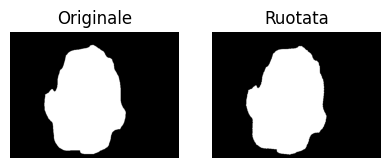

In [ ]:
contours, _ = cv2.findContours(bin_img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnt = max(contours, key=cv2.contourArea)
ellipse = cv2.fitEllipse(cnt)
(center_x, center_y), _, angle = ellipse

(h, w) = bin_img.shape
M = cv2.getRotationMatrix2D((center_x, center_y), -angle, 1.0)
rotated = cv2.warpAffine(bin_img, M, (w, h), flags=cv2.INTER_NEAREST, borderValue=0)

plt.figure(figsize=(10, 6))
plt.subplot(2, 4, 1)
plt.imshow(bin_img, cmap='gray')
plt.title("Originale")
plt.axis("off")

plt.subplot(2, 4, 2)
plt.imshow(rotated, cmap='gray')
plt.title("Ruotata")
plt.axis("off")

After the image is rotated, the contour of the mole is detected again to reflect its new orientation. A rectangular bounding box is then computed around the rotated contour to tightly enclose the mole.

To ensure symmetry in the subsequent analysis, the cropped image is placed at the center of a new square. Centering guarantees that the mole is properly aligned and symmetrically positioned, which is essential for accurately dividing the image into the four quadrants used in the asymmetry analysis.

(-0.5, 285.5, 384.5, -0.5)

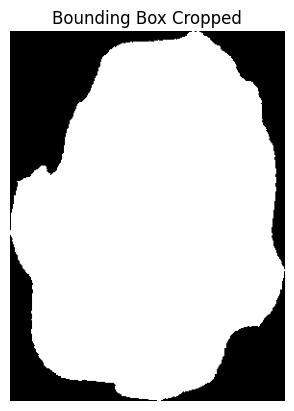

In [ ]:
rotated_contours, _ = cv2.findContours(rotated, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnt_rotated = max(rotated_contours, key=cv2.contourArea)
x, y, w_box, h_box = cv2.boundingRect(cnt_rotated)
cropped = rotated[y:y+h_box, x:x+w_box]

square_size = max(cropped.shape)
square = np.zeros((square_size, square_size), dtype=np.uint8)
y_off = (square_size - cropped.shape[0]) // 2
x_off = (square_size - cropped.shape[1]) // 2
square[y_off:y_off + cropped.shape[0], x_off:x_off + cropped.shape[1]] = cropped

plt.imshow(cropped, cmap='gray')
plt.title("Bounding Box Cropped")
plt.axis("off")

Now the image is divided into four quadrants, and each pair is compared using the XOR operation. Then, the number of white pixels (representing differences) is counted for each comparison result C, and divided by N, the total number of pixels in a quadrant, to obtain normalized asymmetry values.

Descrittori di asimmetria:
dif_1 (FLU vs FRU): 0.7415
dif_2 (FLU vs FLD): 0.3350
dif_3 (FRD vs FRU): 0.2419
dif_4 (FRD vs FLD): 0.6935


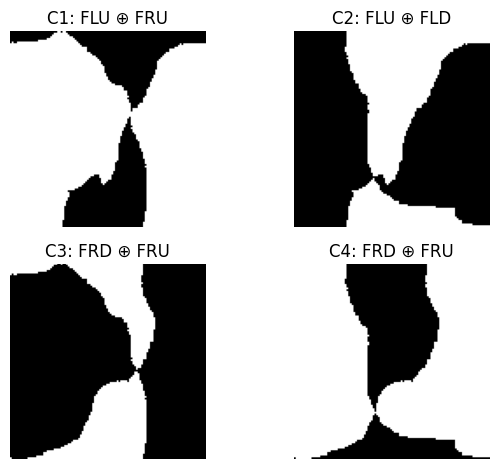

In [ ]:
resized = cv2.resize(square, (224, 224), interpolation=cv2.INTER_NEAREST)

half = 112
FLU = resized[:half, :half]
FRU = resized[:half, half:]
FLD = resized[half:, :half]
FRD = resized[half:, half:]

C1 = cv2.bitwise_xor(FLU, FRU)
C2 = cv2.bitwise_xor(FLU, FLD)
C3 = cv2.bitwise_xor(FRD, FRU)
C4 = cv2.bitwise_xor(FRD, FLD)

N = half * half
d1 = np.sum(C1 == 255) / N
d2 = np.sum(C2 == 255) / N
d3 = np.sum(C3 == 255) / N
d4 = np.sum(C4 == 255) / N

print("Descrittori di asimmetria:")
print(f"dif_1 (FLU vs FRU): {d1:.4f}")
print(f"dif_2 (FLU vs FLD): {d2:.4f}")
print(f"dif_3 (FRD vs FRU): {d3:.4f}")
print(f"dif_4 (FRD vs FLD): {d4:.4f}")

plt.subplot(2, 2, 1)
plt.imshow(C1, cmap='gray')
plt.title("C1: FLU ⊕ FRU")
plt.axis("off")

plt.subplot(2, 2, 2)
plt.imshow(C2, cmap='gray')
plt.title("C2: FLU ⊕ FLD")
plt.axis("off")

plt.subplot(2, 2, 3)
plt.imshow(C3, cmap='gray')
plt.title("C3: FRD ⊕ FRU")
plt.axis("off")

plt.subplot(2, 2, 4)
plt.imshow(C4, cmap='gray')
plt.title("C4: FRD ⊕ FRU")
plt.axis("off")

plt.tight_layout()
plt.show()

In [ ]:
asymmetry_total = d1 + d2 + d3 + d4
print(f"Asimmetria totale: {asymmetry_total:.4f}")

Asimmetria totale: 2.0120


Border
The NEF (Normalized Edge Factor) is a shape descriptor used to quantify the irregularity of a mole’s border.
NEF compares the actual perimeter of the mole to the perimeter of a reference shape (like a square or circle) with the same area or number of pixels.

$$
\text{NEF} = \frac{P_{\text{mole}}}{4 \sqrt{n}}
$$

* $P_{\text{mole}}$: the perimeter (length of the mole’s border)
* $n$: number of pixels (area of the mole)
* $4\sqrt{n}$: perimeter of a square with the same area

A perfectly regular shape (like a circle or square) has a low NEF. An irregular mole has a higher NEF.
[We use the same image used for the asymmetry analysis.]

First, we select the contour with the maximum area found in the binary mask previously created for asymmetry analysis. Then, we compute the area and perimeter of the lesion and use these values to calculate the NEF (Normalized Edge Factor)

In [ ]:
area = cv2.contourArea(cnt)
perimeter = cv2.arcLength(cnt, True)
nef = perimeter / (4 * np.sqrt(area))

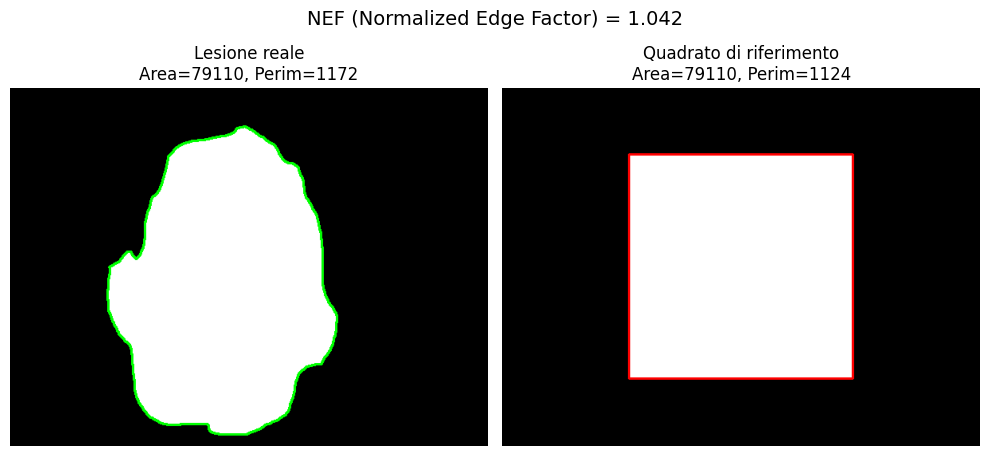

In [ ]:
side = int(np.sqrt(area))
square = np.zeros_like(bin_img)
start_x = (square.shape[1] - side) // 2
start_y = (square.shape[0] - side) // 2
cv2.rectangle(square, (start_x, start_y), (start_x + side, start_y + side), 255, -1)

ref_contours, _ = cv2.findContours(square, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
ref_cnt = ref_contours[0]
ref_perimeter = cv2.arcLength(ref_cnt, True)

fig, axs = plt.subplots(1, 2, figsize=(10, 5))

img_color = cv2.cvtColor(bin_img, cv2.COLOR_GRAY2BGR)
cv2.drawContours(img_color, [cnt], -1, (0, 255, 0), 2)
axs[0].imshow(img_color)
axs[0].set_title(f"Lesione reale\nArea={int(area)}, Perim={int(perimeter)}")
axs[0].axis('off')

square_color = cv2.cvtColor(square, cv2.COLOR_GRAY2BGR)
cv2.drawContours(square_color, [ref_cnt], -1, (255, 0, 0), 2)
axs[1].imshow(square_color)
axs[1].set_title(f"Quadrato di riferimento\nArea={int(area)}, Perim={int(ref_perimeter)}")
axs[1].axis('off')

plt.suptitle(f"NEF (Normalized Edge Factor) = {nef:.3f}", fontsize=14)
plt.tight_layout()

*Color*

Using the Hue channel from the HSV color space is an effective way to standardize color measurements of skin moles across images taken under different lighting conditions and angles.
Unlike raw RGB values, Hue represents the pure color tone independently from brightness and saturation, making it more robust to variations in illumination and shadows. By extracting statistics such as the mean Hue value only within the segmented mole area, we obtain a color feature that is less sensitive to external factors and more representative of the mole’s actual pigmentation.

However, Hue values can be unreliable when saturation is very low (i.e., colors close to gray or washed out). To address this, saturation can be used to weight the contribution of each pixel’s Hue value, so that pixels with higher saturation have a greater influence on the calculated color feature.

We obtain a color feature that is less sensitive to external factors and more representative of the mole’s actual pigmentation.

[Now we use the segmented img with the colored mole inside]

In [ ]:
img_color = cv2.imread(r"D:\Desktop\Project\Isolated_Giuste\Segmentations\ISIC_0024334.jpg")

gray = cv2.cvtColor(img_color, cv2.COLOR_BGR2GRAY)
_, bin_mask = cv2.threshold(gray, 10, 255, cv2.THRESH_BINARY)


First we convert the input image from RGB to HSV color space and separates the Hue, Saturation, and Value channels. HSV makes it easier to analyze color properties like tone and intensity. Next, we use a binary mask to select only the pixels belonging to the mole. This focuses the color analysis strictly on the lesion area, ignoring the background.

In [ ]:
hsv = cv2.cvtColor(img_color, cv2.COLOR_BGR2HSV)
h, s, v = cv2.split(hsv)

mask_valid = (bin_mask == 255)

Finally, we calculate a weighted average of the Hue values, using the Saturation as weights.
This means pixels with stronger color have more influence, producing a more reliable and representative color feature for the mole.

In [ ]:
weighted_hue_sum = np.sum(h[mask_valid] * s[mask_valid])
weight_sum = np.sum(s[mask_valid])
mean_hue_weighted = weighted_hue_sum / weight_sum if weight_sum != 0 else 0

print(f"Weighted Mean Hue: {mean_hue_weighted:.2f}")

Weighted Mean Hue: 0.72


#Classification Models

**MLP and SVM on feature extracted**

So, after testing the validity of the methods used, we will implement them on the entire dataset with the goal of trying to predict the classes using an MLP or SVM. Since the classes are imbalanced, we will apply augmentation to the training set.

In [ ]:
import pandas as pd

metadata=pd.read_csv("D:\Desktop\Project\HAM10000_metadata.csv")

<>:3: SyntaxWarning: invalid escape sequence '\D'
<>:3: SyntaxWarning: invalid escape sequence '\D'
C:\Users\giovi\AppData\Local\Temp\ipykernel_26264\1621491257.py:3: SyntaxWarning: invalid escape sequence '\D'
  metadata=pd.read_csv("D:\Desktop\Project\HAM10000_metadata.csv")


In [ ]:
metadata['image_num'] = metadata['image_id'].str.extract(r'ISIC_(\d{7})').astype(int)
metadata = metadata.sort_values('image_num').reset_index(drop=True)
metadata = metadata.drop(columns=['image_num'])

metadata=metadata.drop(columns=["lesion_id","dx_type","dataset"])

In [ ]:
import os

img_dir = r"D:\Desktop\Project\Isolated_Giuste\Segmentations"

metadata["image_path_iso"] = metadata["image_id"].apply(
    lambda x: os.path.join(img_dir, f"{x}.jpg")
)

print(metadata[["image_id", "image_path_iso"]].head())

In [ ]:
img_dir = r"D:\Desktop\Project\segmentations_resized"

metadata["image_path_seg"] = metadata["image_id"].apply(
    lambda x: os.path.join(img_dir, f"{x}_segmentation.png")
)

print(metadata[["image_id", "image_path_seg"]].head())

Splitting data into train(70%) and test set(30%).

In [ ]:
from sklearn.model_selection import train_test_split

train_df, test_df = train_test_split(
    metadata,
    test_size=0.3,
    random_state=42,
    stratify=metadata['dx']
)

print("Distribuzione nel train:")
print(train_df['dx'].value_counts())

print("\nDistribuzione nel test:")
print(test_df['dx'].value_counts())


Distribuzione nel train:
dx
nv       4693
mel       779
bkl       769
bcc       360
akiec     229
vasc       99
df         81
Name: count, dtype: int64

Distribuzione nel test:
dx
nv       2012
mel       334
bkl       330
bcc       154
akiec      98
vasc       43
df         34
Name: count, dtype: int64


Applying augmentation to generalize better the model and to solve the unbalanced classes applying rotation and flip to original images.

In [ ]:
import os
from PIL import Image
from torchvision import transforms
import pandas as pd


In [ ]:
#Defining augmentation function
augment = transforms.Compose([
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomRotation(20),
])

output_dir = "augmented"
os.makedirs(output_dir, exist_ok=True)

def augment_and_save(image_path, id_str, img_num):
    img = Image.open(image_path).convert('RGB')
    img_aug = augment(img)

    base_name = os.path.basename(image_path)
    new_name = f"aug_{id_str}_{img_num}_{base_name}"
    save_path = os.path.join(output_dir, new_name)

    img_aug.save(save_path)
    return save_path


counts = train_df['dx'].value_counts()
max_count = counts.max()

new_rows = []

for cls in counts.index:
    df_cls = train_df[train_df['dx'] == cls]
    n_to_augment = max_count - counts[cls]


    if n_to_augment <= 0:
        new_rows.append(df_cls)
        continue

    augmented_cls_rows = []
    idx_cycle = 0

    for i in range(n_to_augment):
        row = df_cls.iloc[idx_cycle].copy()

        new_path1 = augment_and_save(row['image_path_iso'], f"{cls}_{i}", 1)
        new_path2 = augment_and_save(row['image_path_seg'], f"{cls}_{i}", 2)

        row['image_path_iso'] = new_path1
        row['image_path_seg'] = new_path2

        augmented_cls_rows.append(row)

        idx_cycle = (idx_cycle + 1) % len(df_cls)

    new_rows.append(pd.concat([df_cls, pd.DataFrame(augmented_cls_rows)], ignore_index=True))

train_df_balanced = pd.concat(new_rows, ignore_index=True)

print(f"Original train shape: {train_df.shape}")
print(f"Balanced train shape: {train_df_balanced.shape}")



Original train shape: (7010, 7)
Balanced train shape: (32851, 7)


In [ ]:
train_df_balanced.to_csv('train_df_balanced.csv',index=False)
test_df.to_csv('test_df.csv',index=False)


In [ ]:
import os
import cv2
import numpy as np
import pandas as pd

results = []

def compute_features(img_path_seg):
    img = cv2.imread(img_path_seg, cv2.IMREAD_GRAYSCALE)
    if img is None:
        return None

    _, bin_img = cv2.threshold(img, 10, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(bin_img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        return None

    cnt = max(contours, key=cv2.contourArea)
    x, y, w_box, h_box = cv2.boundingRect(cnt)
    cropped = bin_img[y:y + h_box, x:x + w_box]

    square_size = max(cropped.shape)
    square = np.zeros((square_size, square_size), dtype=np.uint8)
    y_off = (square_size - cropped.shape[0]) // 2
    x_off = (square_size - cropped.shape[1]) // 2
    square[y_off:y_off + cropped.shape[0], x_off:x_off + cropped.shape[1]] = cropped
    resized = cv2.resize(square, (224, 224), interpolation=cv2.INTER_NEAREST)

    half = 112
    FLU = resized[:half, :half]
    FRU = resized[:half, half:]
    FLD = resized[half:, :half]
    FRD = resized[half:, half:]

    C1 = cv2.bitwise_xor(FLU, FRU)
    C2 = cv2.bitwise_xor(FLU, FLD)
    C3 = cv2.bitwise_xor(FRD, FRU)
    C4 = cv2.bitwise_xor(FRD, FLD)

    N = half * half
    d1 = np.sum(C1 == 255) / N
    d2 = np.sum(C2 == 255) / N
    d3 = np.sum(C3 == 255) / N
    d4 = np.sum(C4 == 255) / N

    area = cv2.contourArea(cnt)
    if area == 0:
        return None
    perimeter = cv2.arcLength(cnt, True)
    nef = perimeter / (4 * np.sqrt(area))

    return d1, d2, d3, d4, nef


for img_path_seg in train_df_balanced['image_path_seg']:
    if not os.path.isfile(img_path_seg):
        continue

    features = compute_features(img_path_seg)
    if features is not None:
        d1, d2, d3, d4, nef = features
        results.append({
            "image_path": img_path_seg,
            "d1": d1,
            "d2": d2,
            "d3": d3,
            "d4": d4,
            "nef": nef
        })

df = pd.DataFrame(results)
df.to_csv("lesion_features_train.csv", index=False)
print("CSV created: lesion_features_train.csv")

CSV created: lesion_features_train.csv


In [ ]:
results = []

for img_path_iso in train_df_balanced['image_path_iso']:
    if not img_path_iso.lower().endswith(".jpg"):
        continue

    if not os.path.isfile(img_path_iso):
        continue

    img_color = cv2.imread(img_path_iso)

    if img_color is None:
        continue

    gray = cv2.cvtColor(img_color, cv2.COLOR_BGR2GRAY)
    _, bin_mask = cv2.threshold(gray, 10, 255, cv2.THRESH_BINARY)

    hsv = cv2.cvtColor(img_color, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)

    mask_valid = (bin_mask == 255)
    weighted_hue_sum = np.sum(h[mask_valid] * s[mask_valid])
    weight_sum = np.sum(s[mask_valid])
    mean_hue_weighted = weighted_hue_sum / weight_sum if weight_sum != 0 else 0

    results.append({
        "image_path": img_path_iso,
        "weighted_mean_hue": mean_hue_weighted
    })

df = pd.DataFrame(results)
df.to_csv("weighted_mean_hue_train.csv", index=False)
print("CSV saved as 'weighted_mean_hue_train.csv'")


CSV saved as 'weighted_mean_hue_train.csv'


In [ ]:
results = []

def compute_features(img_path_seg):
    img = cv2.imread(img_path_seg, cv2.IMREAD_GRAYSCALE)
    if img is None:
        return None

    _, bin_img = cv2.threshold(img, 10, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(bin_img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        return None

    cnt = max(contours, key=cv2.contourArea)
    x, y, w_box, h_box = cv2.boundingRect(cnt)
    cropped = bin_img[y:y + h_box, x:x + w_box]

    square_size = max(cropped.shape)
    square = np.zeros((square_size, square_size), dtype=np.uint8)
    y_off = (square_size - cropped.shape[0]) // 2
    x_off = (square_size - cropped.shape[1]) // 2
    square[y_off:y_off + cropped.shape[0], x_off:x_off + cropped.shape[1]] = cropped
    resized = cv2.resize(square, (224, 224), interpolation=cv2.INTER_NEAREST)

    half = 112
    FLU = resized[:half, :half]
    FRU = resized[:half, half:]
    FLD = resized[half:, :half]
    FRD = resized[half:, half:]

    C1 = cv2.bitwise_xor(FLU, FRU)
    C2 = cv2.bitwise_xor(FLU, FLD)
    C3 = cv2.bitwise_xor(FRD, FRU)
    C4 = cv2.bitwise_xor(FRD, FLD)

    N = half * half
    d1 = np.sum(C1 == 255) / N
    d2 = np.sum(C2 == 255) / N
    d3 = np.sum(C3 == 255) / N
    d4 = np.sum(C4 == 255) / N

    area = cv2.contourArea(cnt)
    if area == 0:
        return None
    perimeter = cv2.arcLength(cnt, True)
    nef = perimeter / (4 * np.sqrt(area))

    return d1, d2, d3, d4, nef


for img_path_seg in test_df['image_path_seg']:
    if not os.path.isfile(img_path_seg):
        continue

    features = compute_features(img_path_seg)
    if features is not None:
        d1, d2, d3, d4, nef = features
        results.append({
            "image_path": img_path_seg,
            "d1": d1,
            "d2": d2,
            "d3": d3,
            "d4": d4,
            "nef": nef
        })

df = pd.DataFrame(results)
df.to_csv("lesion_features_test.csv", index=False)
print("CSV created: lesion_features_test.csv")

CSV created: lesion_features_test.csv


In [ ]:
results = []

for img_path_iso in test_df['image_path_iso']:
    if not img_path_iso.lower().endswith(".jpg"):
        continue

    if not os.path.isfile(img_path_iso):
        continue

    img_color = cv2.imread(img_path_iso)

    if img_color is None:
        continue

    gray = cv2.cvtColor(img_color, cv2.COLOR_BGR2GRAY)
    _, bin_mask = cv2.threshold(gray, 10, 255, cv2.THRESH_BINARY)

    hsv = cv2.cvtColor(img_color, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)

    mask_valid = (bin_mask == 255)
    weighted_hue_sum = np.sum(h[mask_valid] * s[mask_valid])
    weight_sum = np.sum(s[mask_valid])
    mean_hue_weighted = weighted_hue_sum / weight_sum if weight_sum != 0 else 0

    results.append({
        "image_path": img_path_iso,
        "weighted_mean_hue": mean_hue_weighted
    })

df = pd.DataFrame(results)
df.to_csv("weighted_mean_hue_test.csv", index=False)
print("CSV saved as 'weighted_mean_hue_test.csv'")

CSV saved as 'weighted_mean_hue_test.csv'


In [ ]:
lesion_train=pd.read_csv(r"C:\Users\giovi\Desktop\lesion_features_train.csv")
col_train=pd.read_csv(r"C:\Users\giovi\Desktop\weighted_mean_hue_train.csv")

In [ ]:
train = train_df_balanced.merge(
    lesion_train,
    left_on="image_path_seg",
    right_on="image_path",
    how="left"
)

train = train.merge(
    col_train,
    left_on="image_path_iso",
    right_on="image_path",
    how="left"
)

In [ ]:
train.columns

Index(['image_id', 'dx', 'age', 'sex', 'localization', 'image_path_iso',
       'image_path_seg', 'image_path_x', 'd1', 'd2', 'd3', 'd4', 'nef',
       'image_path_y', 'weighted_mean_hue'],
      dtype='object')

In [ ]:
train=train.drop(columns=["image_id","image_path_iso","image_path_seg","image_path_x","image_path_y",'age','sex','localization'])

In [ ]:
train

,dx,d1,d2,d3,d4,nef,weighted_mean_hue
0,nv,0.822066,0.346221,0.179209,0.731585,1.081071,1.075332
1,nv,0.752312,0.224330,0.114078,0.873406,1.062934,1.179411
2,nv,0.783801,0.180246,0.227997,0.715003,1.064377,0.788831
3,nv,0.738441,0.526547,0.336097,0.557717,1.077309,1.158026
4,nv,0.795759,0.284200,0.263154,0.802934,1.037576,0.686085
...,...,...,...,...,...,...,...
32846,df,0.176738,0.390944,0.324219,0.255102,1.121317,1.168491
32847,df,0.661751,0.391582,0.370695,0.757892,1.241337,1.258012
32848,df,0.596381,0.354114,0.288345,0.610810,1.058002,1.065589
32849,df,0.409917,0.488999,0.555166,0.321907,1.065314,1.288739


In [ ]:
lesion_test=pd.read_csv(r"C:\Users\giovi\Desktop\lesion_features_test.csv")
col_test=pd.read_csv(r"C:\Users\giovi\Desktop\weighted_mean_hue_test.csv")

In [ ]:
test = test_df.merge(
    lesion_test,
    left_on="image_path_seg",
    right_on="image_path",
    how="left"
)

test = test.merge(
    col_test,
    left_on="image_path_iso",
    right_on="image_path",
    how="left"
)


In [ ]:
test.columns

Index(['image_id', 'dx', 'age', 'sex', 'localization', 'image_path_iso',
       'image_path_seg', 'image_path_x', 'd1', 'd2', 'd3', 'd4', 'nef',
       'image_path_y', 'weighted_mean_hue'],
      dtype='object')

In [ ]:
test=test.drop(columns=["image_id","image_path_iso","image_path_seg","image_path_x","image_path_y",'sex','age','localization'])

In [ ]:
test

,dx,d1,d2,d3,d4,nef,weighted_mean_hue
0,mel,0.585858,0.275989,0.321030,0.709981,0.977923,0.929846
1,nv,0.582510,0.311783,0.288186,0.541374,0.964811,1.489268
2,nv,0.572146,0.360571,0.362643,0.570552,0.976497,1.025374
3,nv,0.854911,0.096062,0.199458,0.830596,1.026474,0.756924
4,nv,0.744021,0.230788,0.254225,0.632892,1.081073,0.873963
...,...,...,...,...,...,...,...
3000,nv,0.360252,0.698262,0.739078,0.247688,1.029561,0.818653
3001,nv,0.665338,0.255182,0.297513,0.743224,0.974961,1.224705
3002,bcc,0.404895,0.281649,0.406728,0.643495,1.004827,1.240888
3003,nv,0.541135,0.345265,0.275590,0.648916,0.966328,0.765497


In [ ]:
train.to_csv('train.csv', index=False)
test.to_csv("test.csv",index=False)

To use GPU in order to fasten the train we change the kernel

In [ ]:
import pandas as pd

test=pd.read_csv('/notebooks/FEAT/test.csv')
train=pd.read_csv('/notebooks/FEAT/train.csv')

print("Train shape:", train.shape)
print("Test shape:", test.shape)

Train shape: (32851, 7)
Test shape: (3005, 7)


In [ ]:
from sklearn.model_selection import train_test_split

val_df, test_df = train_test_split(
    test,               # dividi il test originale
    test_size=0.5,      # metà validation, metà test
    random_state=42,
    stratify=test['dx']  # stratifica per target
)


In [ ]:
test=test_df.copy()
val=val_df.copy()

In [ ]:
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.compose import ColumnTransformer
import pandas as pd
import numpy as np

#Target column
target_col = "dx"

#Feature columns
feature_cols = train.drop(columns=[target_col]).columns.tolist()

numerical_cols = feature_cols

preprocessor = ColumnTransformer([
    ("num", StandardScaler(), numerical_cols)
])

#Encoding target variable
le = LabelEncoder()
train[target_col] = le.fit_transform(train[target_col])
val[target_col] = le.transform(val[target_col])
test[target_col] = le.transform(test[target_col])


X_train = preprocessor.fit_transform(train.drop(columns=[target_col]))
X_val = preprocessor.transform(val.drop(columns=[target_col]))
X_test = preprocessor.transform(test.drop(columns=[target_col]))

y_train = train[target_col].values
y_val = val[target_col].values
y_test = test[target_col].values

#Converting if necessary into numpy array
X_train = X_train if isinstance(X_train, np.ndarray) else X_train.toarray()
X_val = X_val if isinstance(X_val, np.ndarray) else X_val.toarray()
X_test = X_test if isinstance(X_test, np.ndarray) else X_test.toarray()


Applying the model to the test set.

Best MLP params: {'hidden_layers': [100], 'activation': 'relu', 'lr': 0.001, 'weight_decay': 0.01}
Validation Accuracy: 0.5146
MLP Test Report:
               precision    recall  f1-score   support

           0       0.15      0.22      0.18        49
           1       0.19      0.27      0.22        77
           2       0.53      0.10      0.17       165
           3       0.03      0.24      0.05        17
           4       0.24      0.16      0.19       167
           5       0.85      0.70      0.77      1006
           6       0.01      0.09      0.02        22

    accuracy                           0.52      1503
   macro avg       0.29      0.26      0.23      1503
weighted avg       0.67      0.52      0.57      1503



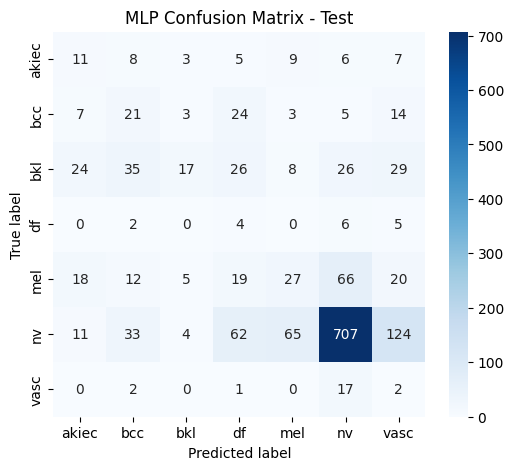

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from itertools import product


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
X_train_torch = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train_torch = torch.tensor(y_train, dtype=torch.long).to(device)
X_val_torch = torch.tensor(X_val, dtype=torch.float32).to(device)
y_val_torch = torch.tensor(y_val, dtype=torch.long).to(device)
X_test_torch = torch.tensor(X_test, dtype=torch.float32).to(device)
y_test_torch = torch.tensor(y_test, dtype=torch.long).to(device)


class MLP(nn.Module):
    def __init__(self, input_size, hidden_layers, output_size, activation):
        super().__init__()
        layers = []
        in_dim = input_size
        act_fn = nn.ReLU() if activation == 'relu' else nn.Tanh()
        for h in hidden_layers:
            layers += [nn.Linear(in_dim, h), act_fn]
            in_dim = h
        layers.append(nn.Linear(in_dim, output_size))
        self.model = nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)


param_grid = {
    'hidden_layers': [[50], [100], [100, 50]],
    'activation': ['relu', 'tanh'],
    'lr': [0.001, 0.01],
    'weight_decay': [0.0001, 0.001, 0.01]
}

best_acc = 0
best_model = None
best_params = None
num_classes = len(np.unique(y_train))

for hl, act, lr, wd in product(*param_grid.values()):
    model = MLP(X_train.shape[1], hl, num_classes, act).to(device)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=wd)

    for epoch in range(100):
        model.train()
        optimizer.zero_grad()
        output = model(X_train_torch)
        loss = criterion(output, y_train_torch)
        loss.backward()
        optimizer.step()

    model.eval()
    with torch.no_grad():
        y_val_pred = torch.argmax(model(X_val_torch), dim=1).cpu().numpy()
        acc = accuracy_score(y_val, y_val_pred)
        if acc > best_acc:
            best_acc = acc
            best_model = model
            best_params = (hl, act, lr, wd)

print("Best MLP params:", {
    'hidden_layers': best_params[0],
    'activation': best_params[1],
    'lr': best_params[2],
    'weight_decay': best_params[3]
})
print(f"Validation Accuracy: {best_acc:.4f}")

best_model.eval()
with torch.no_grad():
    y_test_pred = torch.argmax(best_model(X_test_torch), dim=1).cpu().numpy()
print("MLP Test Report:\n", classification_report(y_test, y_test_pred))

def plot_confusion_matrix(y_true, y_pred, classes, title):
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6,5))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.title(title)
    plt.show()

plot_confusion_matrix(y_test, y_test_pred, classes=le.classes_, title="MLP Confusion Matrix - Test")


The best-performing MLP model was configured with one hidden layer of 100 neurons, ReLU activation, a learning rate of 0.001, and a weight decay of 0.01. On the validation set, it achieved an accuracy of 51.5%, and on the test set, an overall accuracy of 52.0%.

However, performance across classes is highly unbalanced. Class 5 (presumably melanocytic nevi) dominates the predictions, with a high precision (0.85) and recall (0.70), indicating that the model is biased toward this majority class. In contrast, minority or malignant classes such as 0, 1, 3, and 6 show very low performance, with F1-scores below 0.22 and recall often under 0.25, highlighting poor sensitivity to underrepresented or more challenging categories.

The macro average F1-score is only 0.23, reflecting the model's inability to generalize across all classes equally, while the weighted average F1-score is 0.57, driven by the strong performance on the dominant class. These results confirm the presence of class imbalance and suggest the need for techniques such as data balancing, cost-sensitive learning, or architecture changes to improve recognition of minority classes.

**SVM to classify using feature extracted by the images using ABC method**

The main objective is to identify the best-performing SVM configuration through a manual grid search over selected hyperparameters: the regularization parameter C, the kernel type (restricted to 'rbf'), and the kernel coefficient gamma (set to 'scale'). For each combination of these parameters, the model is trained on the training set and evaluated on the validation set, using classification accuracy as the selection metric. The configuration that yields the highest validation accuracy is retained and then applied to the test set for final performance evaluation. After predictions are made on the test set, a detailed classification report is generated, including precision, recall, and F1-score for each of the seven lesion classes. To further analyze model behavior, a confusion matrix is visualized as a heatmap, helping to reveal which classes are frequently misclassified. This pipeline provides both quantitative metrics and visual diagnostics, offering valuable insight into how well the SVM model generalizes to unseen dermoscopic images and where it struggles, particularly with underrepresented or visually similar lesion types.

In [ ]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from itertools import product
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
#Grid-search parameter
svm_param_grid = {
    'C': [0.1, 1, 10],
    'kernel': ['rbf'],
    'gamma': ['scale']
}

best_acc_svm = 0
best_model_svm = None
best_params_svm = None

#SVM model
for C, kernel, gamma in product(*svm_param_grid.values()):
    model = SVC(C=C, kernel=kernel, gamma=gamma, random_state=42)
    model.fit(X_train, y_train)
    y_val_pred = model.predict(X_val)
    acc = accuracy_score(y_val, y_val_pred)
    if acc > best_acc_svm:
        best_acc_svm = acc
        best_model_svm = model
        best_params_svm = (C, kernel, gamma)

Best SVM params: {'C': 0.1, 'kernel': 'rbf', 'gamma': 'scale'}
Validation Accuracy: 0.4860
SVM Test Report:
               precision    recall  f1-score   support

           0       0.16      0.27      0.20        49
           1       0.19      0.36      0.25        77
           2       0.52      0.13      0.21       165
           3       0.04      0.41      0.08        17
           4       0.25      0.19      0.21       167
           5       0.84      0.63      0.72      1006
           6       0.02      0.18      0.04        22

    accuracy                           0.49      1503
   macro avg       0.29      0.31      0.24      1503
weighted avg       0.67      0.49      0.55      1503



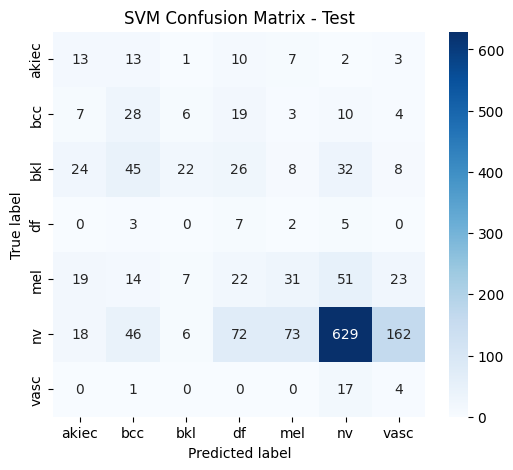

In [ ]:
print("Best SVM params:", {
    'C': best_params_svm[0],
    'kernel': best_params_svm[1],
    'gamma': best_params_svm[2]
})
print(f"Validation Accuracy: {best_acc_svm:.4f}")


y_test_pred_svm = best_model_svm.predict(X_test)
print("SVM Test Report:\n", classification_report(y_test, y_test_pred_svm))


def plot_confusion_matrix(y_true, y_pred, classes, title):
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6,5))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.title(title)
    plt.show()

plot_confusion_matrix(y_test, y_test_pred_svm, classes=le.classes_, title="SVM Confusion Matrix - Test")


These results reflect the performance of the best SVM model selected, using an RBF kernel with C=0.1 and gamma='scale'. The model achieved a validation accuracy of 48.6% and a similar test accuracy of 49.0%, indicating moderate generalization ability. However, a deeper look into the class-wise performance reveals significant imbalances.

Class 5—most likely representing melanocytic nevi, the majority class in the dataset—dominates the model's predictions, achieving the highest precision (0.84), recall (0.63), and F1-score (0.72). This strong performance heavily influences the weighted average metrics, with a weighted F1-score of 0.55.

In contrast, the minority and more clinically critical classes such as melanoma (class 4), basal cell carcinoma (class 1), and akiec (class 0) exhibit poor performance, with F1-scores below 0.25 and low recall values. Notably, class 3, which likely represents dermatofibroma, shows an unusual pattern: despite a very low precision (0.04), its recall is relatively high (0.41), indicating that the model over-predicts this class, often incorrectly.

The macro average F1-score is just 0.24, which confirms the model's difficulty in handling class imbalance and recognizing rare lesions. These results suggest that, while the SVM captures patterns related to the most frequent class, it fails to generalize effectively to less common and more clinically relevant lesion types, highlighting the need for data balancing or more expressive models in future work.

Both MLP and SVM show moderate performance, with test accuracies around 52% and 49% respectively. MLP slightly outperforms SVM overall, especially on the dominant class (class 5), while SVM performs marginally better on some minority classes. However, both models struggle significantly with class imbalance — minority classes have very low recall and F1-scores, making predictions unreliable for them.

## Neural Networks

In this section, we describe the process of training deep learning models to classify skin lesions into multiple diagnostic categories. Leveraging transfer learning, we utilize pre-trained convolutional neural networks (CNNs) as feature extractors and fine-tune them on our dataset. Our objective is to achieve accurate and robust classification performance while minimizing overfitting, especially given the class imbalance commonly found in medical imaging datasets. Several architectures were explored and optimized through hyperparameter tuning, with performance evaluated using standard metrics such as accuracy, precision, recall, and F1-score.

First we are going to import keras, a library which can allow us to train our Deep Neural Networks.

In [ ]:
import tensorflow as tf
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.applications.efficientnet import EfficientNetB0, preprocess_input
from tensorflow.keras.layers import Input, GlobalAveragePooling2D, Dropout, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.utils import resample
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.callbacks import EarlyStopping
import pandas as pd
import os
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
from PIL import Image
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report


Then we can upload our metadata for each image.

In [ ]:
base_path = "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing"

#Metadata CSV
df = pd.read_csv(os.path.join(base_path, "HAM10000_metadata.csv"))
df.rename(columns={
    "dx": "CLASS",
    "dx_type": "Ground truth type"
}, inplace=True)

df

,lesion_id,image_id,CLASS,Ground truth type,age,sex,localization
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear
...,...,...,...,...,...,...,...
10010,HAM_0002867,ISIC_0033084,akiec,histo,40.0,male,abdomen
10011,HAM_0002867,ISIC_0033550,akiec,histo,40.0,male,abdomen
10012,HAM_0002867,ISIC_0033536,akiec,histo,40.0,male,abdomen
10013,HAM_0000239,ISIC_0032854,akiec,histo,80.0,male,face


It can be defined a function to put in a column the path in which each image is saved

In [ ]:
def get_image_path(image_id):
    base_images = os.path.join(base_path, "Training_crop")
    path = os.path.join(base_images, f"crop_{image_id}.jpg")
    return path


In [ ]:
#Image path
df["percorso_immagine"] = df["image_id"].apply(get_image_path)

#Counting the number of images(check)
image_files = df["percorso_immagine"].tolist()

print(f"Total number of images: {len(image_files)}")

Total number of images: 10015


In [ ]:
df

,lesion_id,image_id,CLASS,Ground truth type,age,sex,localization,Cell_type,percorso_immagine
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,Benign keratosis-like lesions,/tf/OneDrive/Desktop/Università/Data_Science/D...
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,Benign keratosis-like lesions,/tf/OneDrive/Desktop/Università/Data_Science/D...
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,Benign keratosis-like lesions,/tf/OneDrive/Desktop/Università/Data_Science/D...
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,Benign keratosis-like lesions,/tf/OneDrive/Desktop/Università/Data_Science/D...
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,Benign keratosis-like lesions,/tf/OneDrive/Desktop/Università/Data_Science/D...
...,...,...,...,...,...,...,...,...,...
10010,HAM_0002867,ISIC_0033084,akiec,histo,40.0,male,abdomen,Actinic keratoses,/tf/OneDrive/Desktop/Università/Data_Science/D...
10011,HAM_0002867,ISIC_0033550,akiec,histo,40.0,male,abdomen,Actinic keratoses,/tf/OneDrive/Desktop/Università/Data_Science/D...
10012,HAM_0002867,ISIC_0033536,akiec,histo,40.0,male,abdomen,Actinic keratoses,/tf/OneDrive/Desktop/Università/Data_Science/D...
10013,HAM_0000239,ISIC_0032854,akiec,histo,80.0,male,face,Actinic keratoses,/tf/OneDrive/Desktop/Università/Data_Science/D...


Then it can be built a code which prepares the dataset to train a skin lesion classification model. First, it resizes the images to 224×224 and defines the input shape. The lesion class labels are encoded as categorical values, and a numerical label (label_encoded) is assigned to each class. The dataset is then splitted into training and validation sets using stratified sampling to maintain class balance. The load_images function reads and resizes each image in the given subset and converts it to a NumPy array. It also collects the corresponding encoded labels. Finally, the training and validation image arrays (X_train_raw, X_val) and their labels (y_train_raw, y_val) are created.

In [ ]:
IMG_SIZE = (224, 224)
input_shape = (*IMG_SIZE, 3)

# Encode le classi (se non già numeriche)
df['label'] = df['CLASS'].astype('category')
class_names = df['label'].cat.categories
df['label_encoded'] = df['label'].cat.codes
num_classes = df['label_encoded'].nunique()

# Split train/val
df_train, df_val = train_test_split(df, test_size=0.2, stratify=df['label_encoded'], random_state=42)

def load_images(df_subset):
    X = []
    y = []
    for _, row in df_subset.iterrows():
        img = load_img(row['percorso_immagine'], target_size=IMG_SIZE)
        img = img_to_array(img)
        X.append(img)
        y.append(row['label_encoded'])
    return np.array(X), np.array(y)

X_train_raw, y_train_raw = load_images(df_train)
X_val, y_val = load_images(df_val)


Next step is to balance the dataset because there is a huge difference in the number of occurences for each class, first it was thought to use an oversampling technique but the computational cost of training such an enormous dataset was too high, so it was used an Hybrid Sampling, which makes the mean of all class occurences and if a class has a number of occurences over the mean it is performed undersamplin, while if it is below the mean it is performed oversampling

In [ ]:
from collections import Counter
from sklearn.utils import resample
import numpy as np

# === 1. Calcola la distribuzione delle classi
class_counts = Counter(y_train_raw)
mean_count = int(np.mean(list(class_counts.values())))  # soglia centrale

print("Distribuzione originale:", class_counts)
print("Media classi:", mean_count)

X_balanced = []
y_balanced = []

for class_label in np.unique(y_train_raw):
    idx = np.where(y_train_raw == class_label)[0]
    X_class = X_train_raw[idx]
    y_class = y_train_raw[idx]
    count = len(X_class)

    # --- Undersample se sopra la media del dataset
    if count > mean_count:
        X_sampled, y_sampled = resample(
            X_class, y_class,
            replace=False,
            n_samples=mean_count,
            random_state=42
        )

    # --- Oversample se sotto la media del dataset
    elif count < mean_count:
        X_sampled, y_sampled = resample(
            X_class, y_class,
            replace=True,
            n_samples=mean_count,
            random_state=42
        )

    else:
        X_sampled, y_sampled = X_class, y_class

    X_balanced.append(X_sampled)
    y_balanced.append(y_sampled)

# === 4. Concatenazione finale
X_train = np.concatenate(X_balanced)
y_train = np.concatenate(y_balanced)

print("Distribuzione dopo hybrid sampling:", Counter(y_train))


Distribuzione originale: Counter({5: 5364, 4: 890, 2: 879, 1: 411, 0: 262, 6: 114, 3: 92})
Media classi: 1144
Distribuzione dopo hybrid sampling: Counter({0: 1144, 1: 1144, 2: 1144, 3: 1144, 4: 1144, 5: 1144, 6: 1144})


In this way the dataset is balanced with more than 1000 images for each class

In [ ]:
import gc
del X_balanced, y_balanced, X_train_raw, y_train_raw
gc.collect()

0

This code sets up data preprocessing and augmentation for training a skin lesion classification model. An ImageDataGenerator is defined to apply random transformations—such as rotation, shifts, zoom, and horizontal flipping—to augment the training images, helping the model generalize better. The preprocess_input function (specific to the base model which is EfficientNet) is applied to normalize the images. The class labels for training and validation sets are one-hot encoded. A data generator (train_generator) is created for feeding augmented training images and labels in batches. Finally, the validation images are preprocessed (without augmentation) for evaluation.

In [ ]:
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    preprocessing_function=preprocess_input
)

# One-hot encoding
y_train_cat = to_categorical(y_train, num_classes)
y_val_cat = to_categorical(y_val, num_classes)

# Generatore training
batch_size = 32
train_generator = datagen.flow(X_train, y_train_cat, batch_size=batch_size)

# Preprocessing validation (senza augment)
X_val_pre = preprocess_input(X_val.astype('float32'))


In [ ]:
del y_train, y_val, X_val, df_train, df_val
gc.collect()

0

Then it is built a Convolutional Neural Network (CNN) using Keras for multi-class classification of skin lesions. The model consists of three convolutional blocks, each composed of a Conv2D layer followed by BatchNormalization and MaxPooling2D to progressively extract features and reduce spatial dimensions. After flattening the output, a fully connected (Dense) layer with 256 units and ReLU activation is added, followed by a Dropout layer to prevent overfitting. The final output layer uses a softmax activation function to classify the input into one of the predefined skin lesion classes. The model is compiled using the Adam optimizer and categorical cross-entropy loss, suitable for multi-class classification tasks.

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization

model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Conv2D(64, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Conv2D(128, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(num_classes, activation='softmax')  # multi-class classification
])

model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])


Then the model is trained for 25 epochs with an earlystopping of patience 5.

In [ ]:
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=5,
    restore_best_weights=True,
    verbose=1
)

history = model.fit(
    train_generator,
    epochs=25,
    validation_data=(X_val_pre, y_val_cat),
    steps_per_epoch=len(X_train) // batch_size,
    callbacks=[early_stopping]
)


Epoch 1/25
250/250 [==============================] - 91s 330ms/step - loss: 5.0540 - accuracy: 0.1778 - val_loss: 1.8944 - val_accuracy: 0.0739
Epoch 2/25
250/250 [==============================] - 56s 223ms/step - loss: 2.1432 - accuracy: 0.1774 - val_loss: 2.0431 - val_accuracy: 0.0569
Epoch 3/25
250/250 [==============================] - 57s 227ms/step - loss: 1.9787 - accuracy: 0.2029 - val_loss: 2.2865 - val_accuracy: 0.0339
Epoch 4/25
250/250 [==============================] - 56s 224ms/step - loss: 1.9078 - accuracy: 0.2006 - val_loss: 1.9157 - val_accuracy: 0.0554
Epoch 5/25
250/250 [==============================] - 56s 222ms/step - loss: 1.8370 - accuracy: 0.2141 - val_loss: 1.7252 - val_accuracy: 0.2961
Epoch 6/25
250/250 [==============================] - 57s 226ms/step - loss: 1.8510 - accuracy: 0.2298 - val_loss: 2.1513 - val_accuracy: 0.0399
Epoch 7/25
250/250 [==============================] - 56s 226ms/step - loss: 1.8204 - accuracy: 0.2294 - val_loss: 1.4378 - val_ac

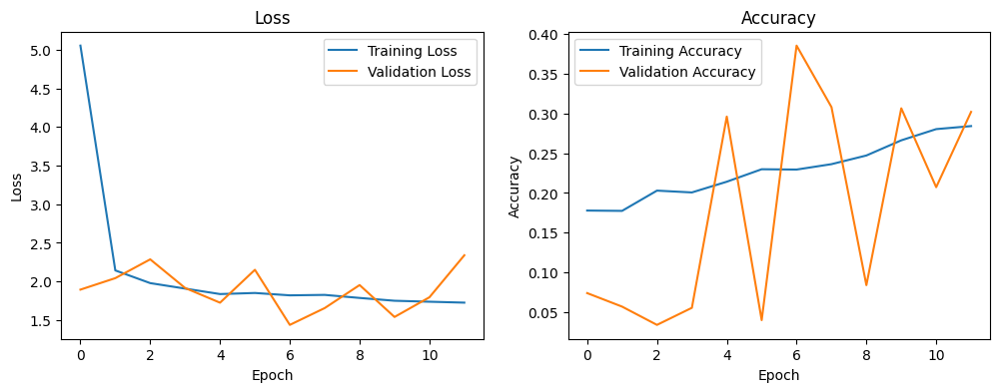

In [ ]:
import matplotlib.pyplot as plt

# Dati raccolti manualmente dal log
history_dict = {
    'loss': [
        5.0540, 2.1432, 1.9787, 1.9078, 1.8370, 1.8510, 1.8204, 1.8262, 1.7868, 1.7503, 1.7378, 1.7259
    ],
    'val_loss': [
        1.8944, 2.0431, 2.2865, 1.9157, 1.7252, 2.1513, 1.4378, 1.6557, 1.9537, 1.5404, 1.7954, 2.3391
    ],
    'accuracy': [
        0.1778, 0.1774, 0.2029, 0.2006, 0.2141, 0.2298, 0.2294, 0.2362, 0.2471, 0.2662, 0.2803, 0.2841
    ],
    'val_accuracy': [
        0.0739, 0.0569, 0.0339, 0.0554, 0.2961, 0.0399, 0.3854, 0.3080, 0.0839, 0.3065, 0.2072, 0.3020
    ]
}

# Epochs
epochs = range(1, len(history_dict['loss']) + 1)

# Plot Loss
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history_dict['loss'], label='Training Loss')
plt.plot(history_dict['val_loss'], label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history_dict['accuracy'], label='Training Accuracy')
plt.plot(history_dict['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.show()


It can be seen that validation loss remains high and volatile, showing no clear downward trend

To evaluate the model we should use test images which our model has never seen, so we can use the UNet trained before to do it

48/48 ━━━━━━━━━━━━━━━━━━━━ 8s 174ms/step
Classification report:
              precision    recall  f1-score   support

       akiec       0.01      0.02      0.01        43
         bcc       0.24      0.04      0.07        93
         bkl       0.30      0.03      0.05       217
          df       0.22      0.05      0.08        44
         mel       0.18      0.06      0.09       171
          nv       0.63      0.48      0.55       908
        vasc       0.04      0.71      0.08        35

    accuracy                           0.32      1511
   macro avg       0.23      0.20      0.13      1511
weighted avg       0.46      0.32      0.36      1511



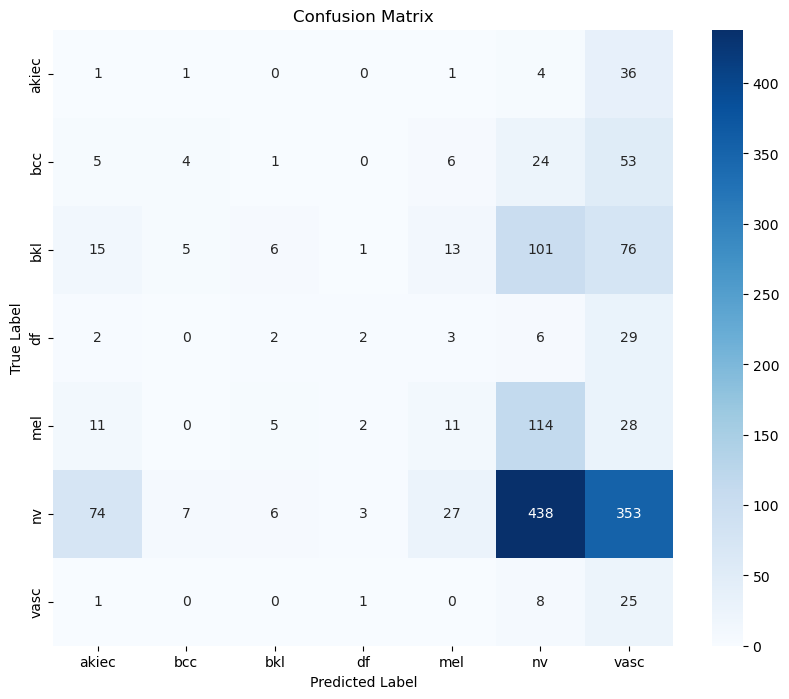

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.applications.resnet50 import preprocess_input
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import pandas as pd

# === 1. Carica immagini e label dal dataframe
IMG_SIZE = (224, 224)
X_test = []
y_true = []

for _, row in df.iterrows():
    img_path = row['percorso_immagine']
    img = load_img(img_path, target_size=IMG_SIZE)
    img_array = img_to_array(img)
    img_array = preprocess_input(img_array)

    X_test.append(img_array)
    y_true.append(row['label_encoded'])  # o 'label' se è già numerico

X_test = np.array(X_test)
y_true = np.array(y_true)

# === 2. Predizione
pred_probs = model.predict(X_test)
y_pred = np.argmax(pred_probs, axis=1)

# === 3. Valutazione testuale
print("Classification report:")
print(classification_report(y_true, y_pred, target_names=class_names))


# === 4. Visualizzazione confusion matrix con seaborn
cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()


We can print also the Precision-Recall curve and ROC curve.

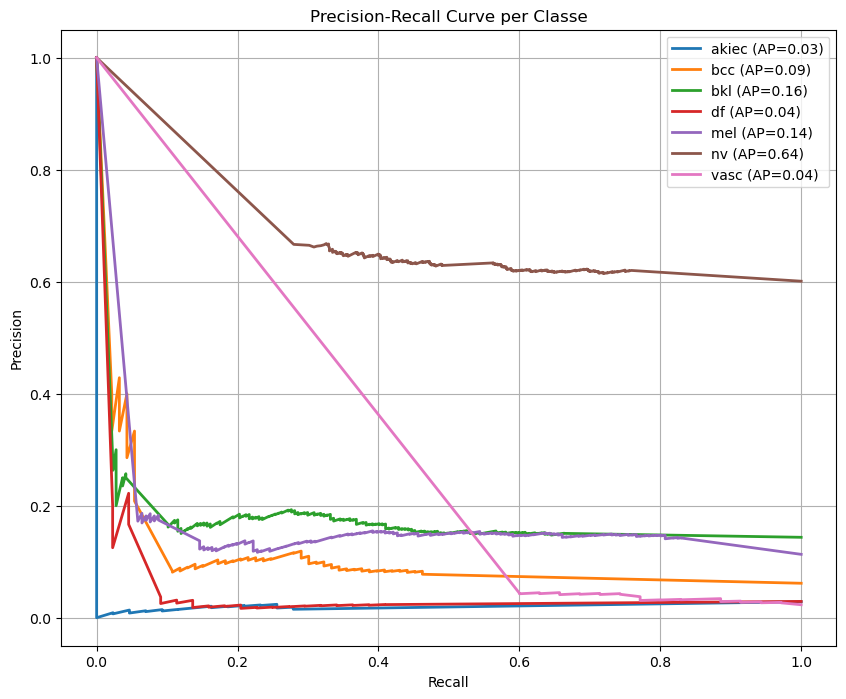

In [ ]:
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.preprocessing import label_binarize
import matplotlib.pyplot as plt

# Binarizza le etichette vere
n_classes = len(class_names)
y_true_bin = label_binarize(y_true, classes=range(n_classes))

# Precision-Recall per classe
precision = dict()
recall = dict()
avg_precision = dict()

for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_true_bin[:, i], pred_probs[:, i])
    avg_precision[i] = average_precision_score(y_true_bin[:, i], pred_probs[:, i])

# Micro-average PR
precision["micro"], recall["micro"], _ = precision_recall_curve(y_true_bin.ravel(), pred_probs.ravel())
avg_precision["micro"] = average_precision_score(y_true_bin, pred_probs, average="micro")

# Plot Precision-Recall
plt.figure(figsize=(10, 8))
for i in range(n_classes):
    plt.plot(recall[i], precision[i], lw=2, label=f'{class_names[i]} (AP={avg_precision[i]:.2f})')
#plt.plot(recall["micro"], precision["micro"], linestyle='--', color='black', label=f'micro-average (AP={avg_precision["micro"]:.2f})')

plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-Recall Curve per Classe")
plt.legend(loc='best')
plt.grid(True)
plt.show()


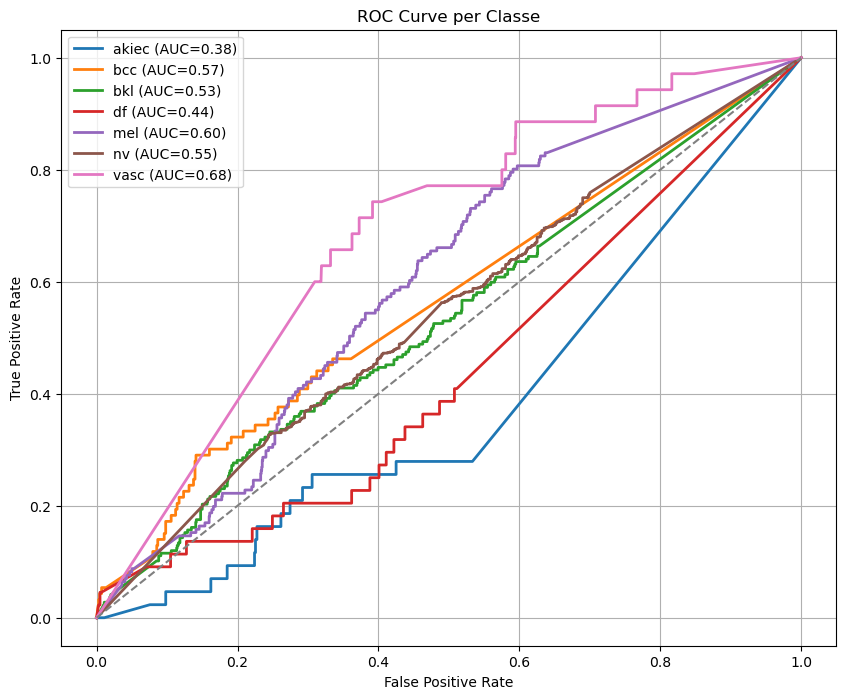

In [ ]:
from sklearn.metrics import roc_curve, auc, roc_auc_score

# ROC per classe
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], pred_probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Micro-average ROC
fpr["micro"], tpr["micro"], _ = roc_curve(y_true_bin.ravel(), pred_probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Macro-average ROC
# Unifica tutti i FPR
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)

for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])

mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot ROC
plt.figure(figsize=(10, 8))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], lw=2, label=f'{class_names[i]} (AUC={roc_auc[i]:.2f})')

#plt.plot(fpr["micro"], tpr["micro"], linestyle='--', color='black', label=f'micro-average (AUC={roc_auc["micro"]:.2f})')
#plt.plot(fpr["macro"], tpr["macro"], linestyle=':', color='navy', label=f'macro-average (AUC={roc_auc["macro"]:.2f})')

plt.plot([0, 1], [0, 1], color='gray', linestyle='--')  # Linea diagonale
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve per Classe")
plt.legend(loc='best')
plt.grid(True)
plt.show()


The model doesn't perform quite well especially on malign skin cancer like melanoma where the recall is 6%, also the general accuracy performs quite bad.

Since train a model from scratch can be very computational expencive, it is used a pretrained model, EfficientNet trained on ImageNet, with tranfer learning.

To have a baseline we build a model and train it on images without segmentation, so we can see if using segmentations we can improve it.

In [ ]:

base_model = EfficientNetB0(include_top=False, weights='imagenet', input_shape=input_shape)
base_model.trainable = False  # Freezing

inputs = Input(shape=input_shape)
x = base_model(inputs, training=False)
x = GlobalAveragePooling2D()(x)
x = Dropout(0.2)(x)
outputs = Dense(num_classes, activation='softmax')(x)

model = Model(inputs, outputs)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


2025-07-04 15:51:38.854558: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-07-04 15:51:39.164324: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-07-04 15:51:39.164591: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

16705208/16705208 [==============================] - 0s 0us/step


In [ ]:
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True,
    verbose=1
)

history = model.fit(
    train_generator,
    epochs=40,
    validation_data=(X_val_pre, y_val_cat),
    steps_per_epoch=len(X_train) // batch_size,
    callbacks=[early_stopping]
)


Epoch 1/40


2025-07-04 15:51:52.175263: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8907
2025-07-04 15:51:55.074465: I external/local_xla/xla/service/service.cc:168] XLA service 0x7ff4bd1841a0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2025-07-04 15:51:55.074532: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): Quadro RTX 5000, Compute Capability 7.5
2025-07-04 15:51:55.119531: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.


  1/250 [..............................] - ETA: 41:33 - loss: 1.9670 - accuracy: 0.2188

I0000 00:00:1751644315.307767    1070 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


250/250 [==============================] - ETA: 0s - loss: 1.3861 - accuracy: 0.4809

2025-07-04 15:53:10.781702: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 1206030336 exceeds 10% of free system memory.
2025-07-04 15:53:12.334144: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 1206030336 exceeds 10% of free system memory.


250/250 [==============================] - 94s 337ms/step - loss: 1.3861 - accuracy: 0.4809 - val_loss: 1.0877 - val_accuracy: 0.6311
Epoch 2/40
250/250 [==============================] - 73s 293ms/step - loss: 1.0741 - accuracy: 0.6120 - val_loss: 0.9948 - val_accuracy: 0.6460
Epoch 3/40
250/250 [==============================] - 74s 295ms/step - loss: 0.9851 - accuracy: 0.6422 - val_loss: 1.1228 - val_accuracy: 0.5956
Epoch 4/40
250/250 [==============================] - 74s 297ms/step - loss: 0.9196 - accuracy: 0.6708 - val_loss: 1.0255 - val_accuracy: 0.6370
Epoch 5/40
250/250 [==============================] - 73s 291ms/step - loss: 0.8771 - accuracy: 0.6846 - val_loss: 0.9872 - val_accuracy: 0.6465
Epoch 6/40
250/250 [==============================] - 73s 290ms/step - loss: 0.8547 - accuracy: 0.6889 - val_loss: 1.0113 - val_accuracy: 0.6311
Epoch 7/40
250/250 [==============================] - 73s 290ms/step - loss: 0.8298 - accuracy: 0.7012 - val_loss: 0.9064 - val_accuracy: 0.6

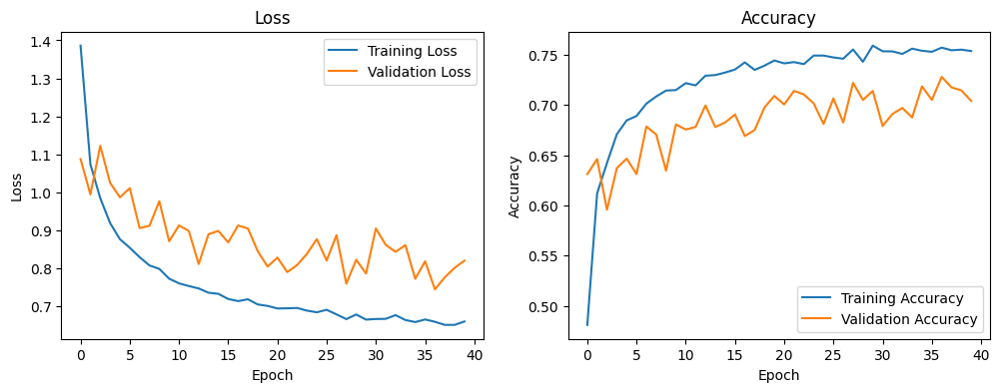

In [ ]:
#printa history del loss e accuracy
import matplotlib.pyplot as plt


plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.show()

We can evaluate it on test images without segmentations

48/48 ━━━━━━━━━━━━━━━━━━━━ 25s 481ms/step
Classification report:
              precision    recall  f1-score   support

       akiec       0.31      0.09      0.14        43
         bcc       0.31      0.04      0.08        93
         bkl       0.36      0.43      0.39       217
          df       0.67      0.05      0.09        44
         mel       0.24      0.02      0.04       171
          nv       0.76      0.72      0.74       908
        vasc       0.04      0.37      0.07        35

    accuracy                           0.51      1511
   macro avg       0.38      0.25      0.22      1511
weighted avg       0.58      0.51      0.52      1511



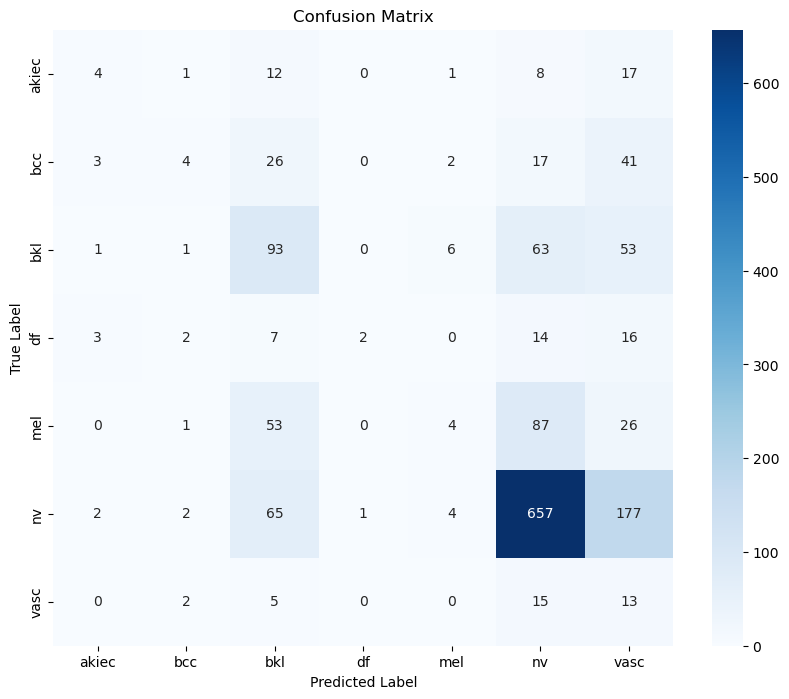

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.applications.resnet50 import preprocess_input
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import pandas as pd

# === 1. Carica immagini e label dal dataframe
IMG_SIZE = (224, 224)
X_test = []
y_true = []

for _, row in df.iterrows():
    img_path = row['percorso_immagine']
    img = load_img(img_path, target_size=IMG_SIZE)
    img_array = img_to_array(img)
    img_array = preprocess_input(img_array)

    X_test.append(img_array)
    y_true.append(row['label_encoded'])  # o 'label' se è già numerico

X_test = np.array(X_test)
y_true = np.array(y_true)

# === 2. Predizione
pred_probs = model.predict(X_test)
y_pred = np.argmax(pred_probs, axis=1)

# === 3. Valutazione testuale
print("Classification report:")
print(classification_report(y_true, y_pred, target_names=class_names))


# === 4. Visualizzazione confusion matrix con seaborn
cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()


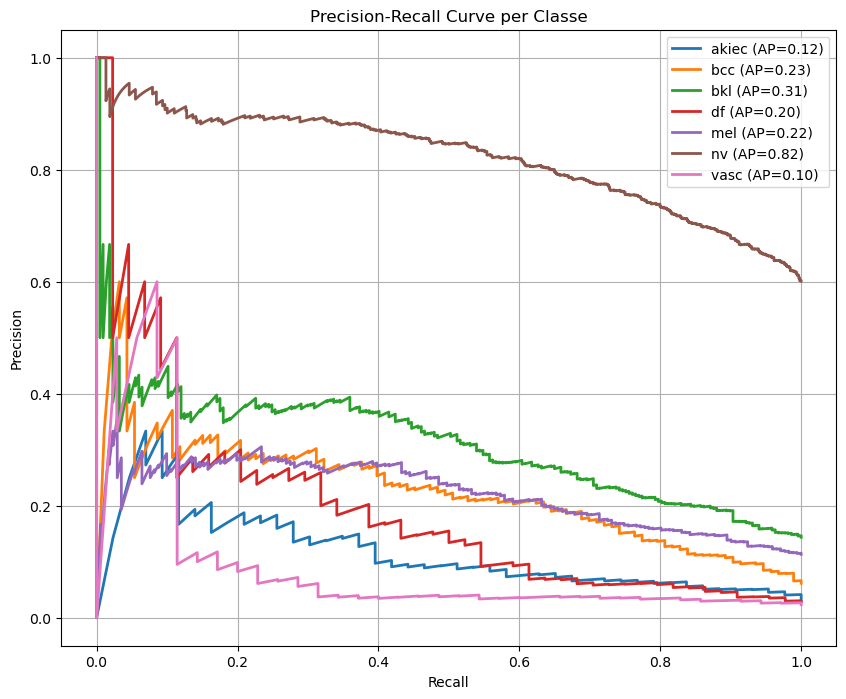

In [ ]:
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.preprocessing import label_binarize
import matplotlib.pyplot as plt

# Binarizza le etichette vere
n_classes = len(class_names)
y_true_bin = label_binarize(y_true, classes=range(n_classes))

# Precision-Recall per classe
precision = dict()
recall = dict()
avg_precision = dict()

for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_true_bin[:, i], pred_probs[:, i])
    avg_precision[i] = average_precision_score(y_true_bin[:, i], pred_probs[:, i])

# Micro-average PR
precision["micro"], recall["micro"], _ = precision_recall_curve(y_true_bin.ravel(), pred_probs.ravel())
avg_precision["micro"] = average_precision_score(y_true_bin, pred_probs, average="micro")

# Plot Precision-Recall
plt.figure(figsize=(10, 8))
for i in range(n_classes):
    plt.plot(recall[i], precision[i], lw=2, label=f'{class_names[i]} (AP={avg_precision[i]:.2f})')
#plt.plot(recall["micro"], precision["micro"], linestyle='--', color='black', label=f'micro-average (AP={avg_precision["micro"]:.2f})')

plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-Recall Curve per Classe")
plt.legend(loc='best')
plt.grid(True)
plt.show()


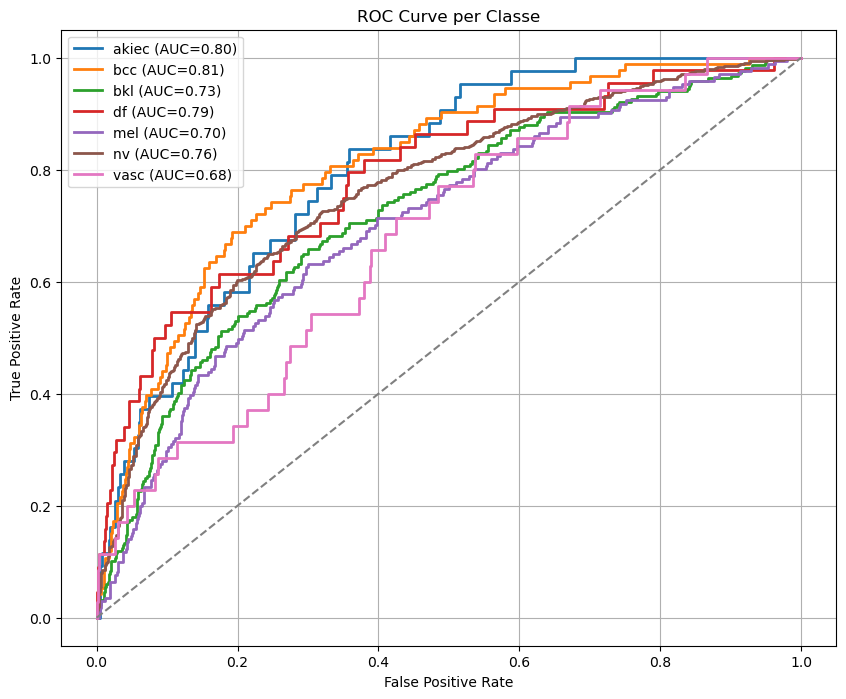

In [ ]:
from sklearn.metrics import roc_curve, auc, roc_auc_score

# ROC per classe
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], pred_probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Micro-average ROC
fpr["micro"], tpr["micro"], _ = roc_curve(y_true_bin.ravel(), pred_probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Macro-average ROC
# Unifica tutti i FPR
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)

for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])

mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot ROC
plt.figure(figsize=(10, 8))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], lw=2, label=f'{class_names[i]} (AUC={roc_auc[i]:.2f})')

#plt.plot(fpr["micro"], tpr["micro"], linestyle='--', color='black', label=f'micro-average (AUC={roc_auc["micro"]:.2f})')
#plt.plot(fpr["macro"], tpr["macro"], linestyle=':', color='navy', label=f'macro-average (AUC={roc_auc["macro"]:.2f})')

plt.plot([0, 1], [0, 1], color='gray', linestyle='--')  # Linea diagonale
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve per Classe")
plt.legend(loc='best')
plt.grid(True)
plt.show()


Now we can train the model on segmented images.

In [ ]:

base_model = EfficientNetB0(include_top=False, weights='imagenet', input_shape=input_shape)
base_model.trainable = False  # Freezing

inputs = Input(shape=input_shape)
x = base_model(inputs, training=False)
x = GlobalAveragePooling2D()(x)
x = Dropout(0.2)(x)
outputs = Dense(num_classes, activation='softmax')(x)

model = Model(inputs, outputs)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


2025-07-04 10:26:21.010632: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-07-04 10:26:21.011061: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-07-04 10:26:21.011231: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

In [ ]:
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True,
    verbose=1
)

history = model.fit(
    train_generator,
    epochs=50,
    validation_data=(X_val_pre, y_val_cat),
    steps_per_epoch=len(X_train) // batch_size,
    callbacks=[early_stopping]
)


Epoch 1/50


2025-07-04 10:26:36.198517: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8907
2025-07-04 10:26:39.408818: I external/local_xla/xla/service/service.cc:168] XLA service 0x7ef77fb09ca0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2025-07-04 10:26:39.408890: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): Quadro RTX 5000, Compute Capability 7.5
2025-07-04 10:26:39.433126: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1751624799.592416    2129 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


250/250 [==============================] - ETA: 0s - loss: 1.4310 - accuracy: 0.4590

2025-07-04 10:27:59.535614: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 1206030336 exceeds 10% of free system memory.
2025-07-04 10:28:01.479145: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 1206030336 exceeds 10% of free system memory.


250/250 [==============================] - 99s 355ms/step - loss: 1.4310 - accuracy: 0.4590 - val_loss: 1.5162 - val_accuracy: 0.4383
Epoch 2/50
250/250 [==============================] - 85s 337ms/step - loss: 1.1260 - accuracy: 0.5911 - val_loss: 1.2733 - val_accuracy: 0.5462
Epoch 3/50
250/250 [==============================] - 84s 335ms/step - loss: 1.0319 - accuracy: 0.6293 - val_loss: 1.2982 - val_accuracy: 0.5477
Epoch 4/50
250/250 [==============================] - 83s 331ms/step - loss: 0.9728 - accuracy: 0.6515 - val_loss: 1.1991 - val_accuracy: 0.5816
Epoch 5/50
250/250 [==============================] - 82s 327ms/step - loss: 0.9381 - accuracy: 0.6632 - val_loss: 1.1223 - val_accuracy: 0.5936
Epoch 6/50
250/250 [==============================] - 80s 321ms/step - loss: 0.9020 - accuracy: 0.6750 - val_loss: 1.1449 - val_accuracy: 0.5961
Epoch 7/50
250/250 [==============================] - 83s 331ms/step - loss: 0.8775 - accuracy: 0.6828 - val_loss: 1.1404 - val_accuracy: 0.5

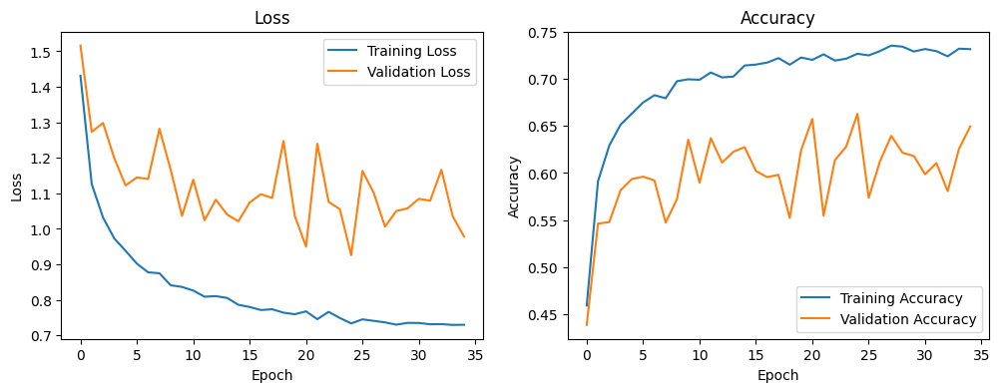

In [ ]:
#printa history del loss e accuracy
import matplotlib.pyplot as plt


plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.show()

And evaluate over the test

48/48 [==============================] - 11s 65ms/step
Classification report:
              precision    recall  f1-score   support

       akiec       0.05      0.05      0.05        43
         bcc       0.17      0.01      0.02        93
         bkl       0.00      0.00      0.00       217
          df       0.04      0.14      0.06        44
         mel       0.11      0.13      0.12       171
          nv       0.65      0.59      0.62       908
        vasc       0.06      0.49      0.11        35

    accuracy                           0.39      1511
   macro avg       0.15      0.20      0.14      1511
weighted avg       0.41      0.39      0.39      1511



/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


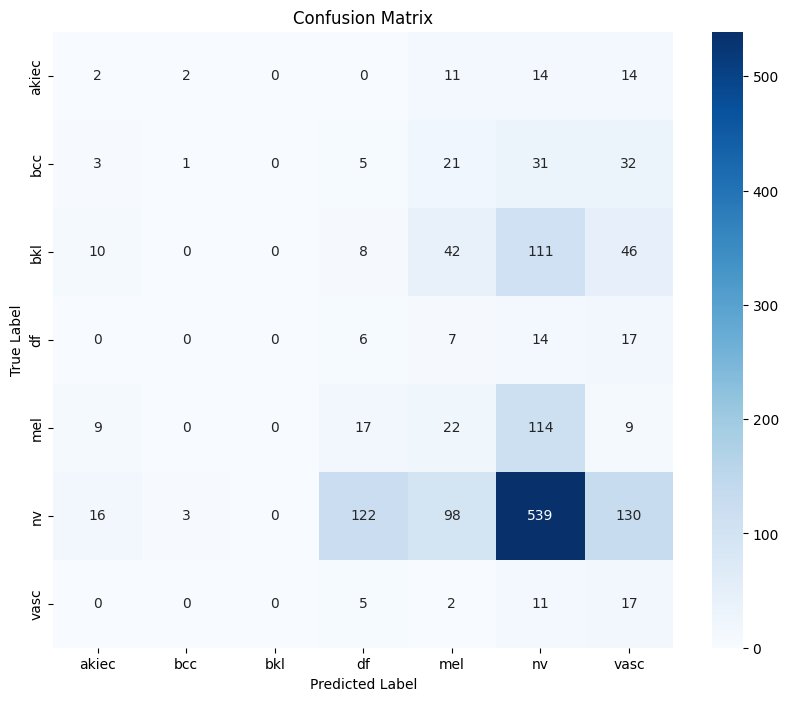

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.applications.resnet50 import preprocess_input
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import pandas as pd

# === 1. Carica immagini e label dal dataframe
IMG_SIZE = (224, 224)
X_test = []
y_true = []

for _, row in df.iterrows():
    img_path = row['percorso_immagine']
    img = load_img(img_path, target_size=IMG_SIZE)
    img_array = img_to_array(img)
    img_array = preprocess_input(img_array)

    X_test.append(img_array)
    y_true.append(row['label_encoded'])  # o 'label' se è già numerico

X_test = np.array(X_test)
y_true = np.array(y_true)

# === 2. Predizione
pred_probs = model.predict(X_test)
y_pred = np.argmax(pred_probs, axis=1)

# === 3. Valutazione testuale
print("Classification report:")
print(classification_report(y_true, y_pred, target_names=class_names))


# === 4. Visualizzazione confusion matrix con seaborn
cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()


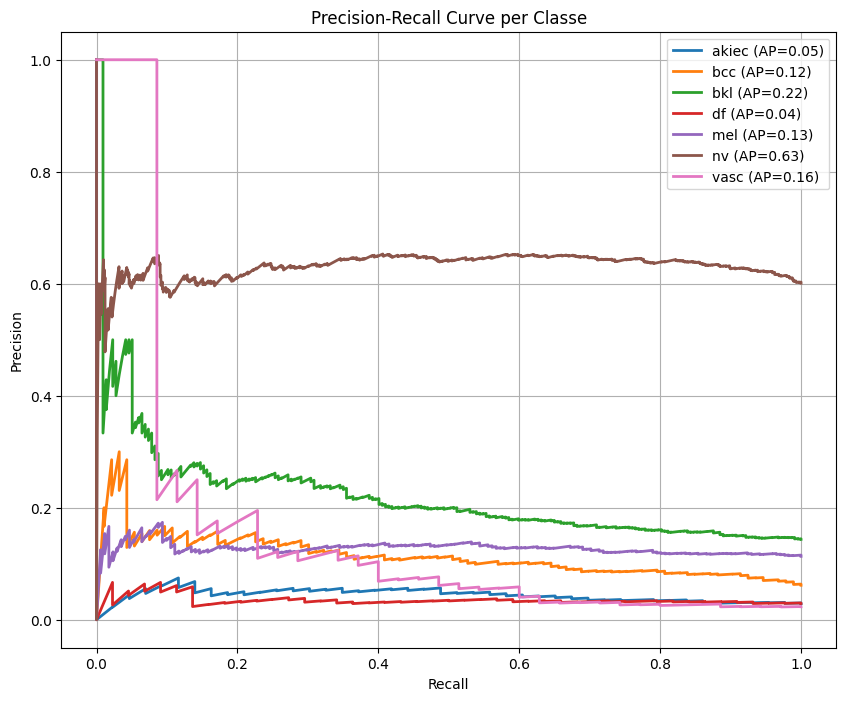

In [ ]:
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.preprocessing import label_binarize
import matplotlib.pyplot as plt

# Binarizza le etichette vere
n_classes = len(class_names)
y_true_bin = label_binarize(y_true, classes=range(n_classes))

# Precision-Recall per classe
precision = dict()
recall = dict()
avg_precision = dict()

for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_true_bin[:, i], pred_probs[:, i])
    avg_precision[i] = average_precision_score(y_true_bin[:, i], pred_probs[:, i])

# Micro-average PR
precision["micro"], recall["micro"], _ = precision_recall_curve(y_true_bin.ravel(), pred_probs.ravel())
avg_precision["micro"] = average_precision_score(y_true_bin, pred_probs, average="micro")

# Plot Precision-Recall
plt.figure(figsize=(10, 8))
for i in range(n_classes):
    plt.plot(recall[i], precision[i], lw=2, label=f'{class_names[i]} (AP={avg_precision[i]:.2f})')
#plt.plot(recall["micro"], precision["micro"], linestyle='--', color='black', label=f'micro-average (AP={avg_precision["micro"]:.2f})')

plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-Recall Curve per Classe")
plt.legend(loc='best')
plt.grid(True)
plt.show()


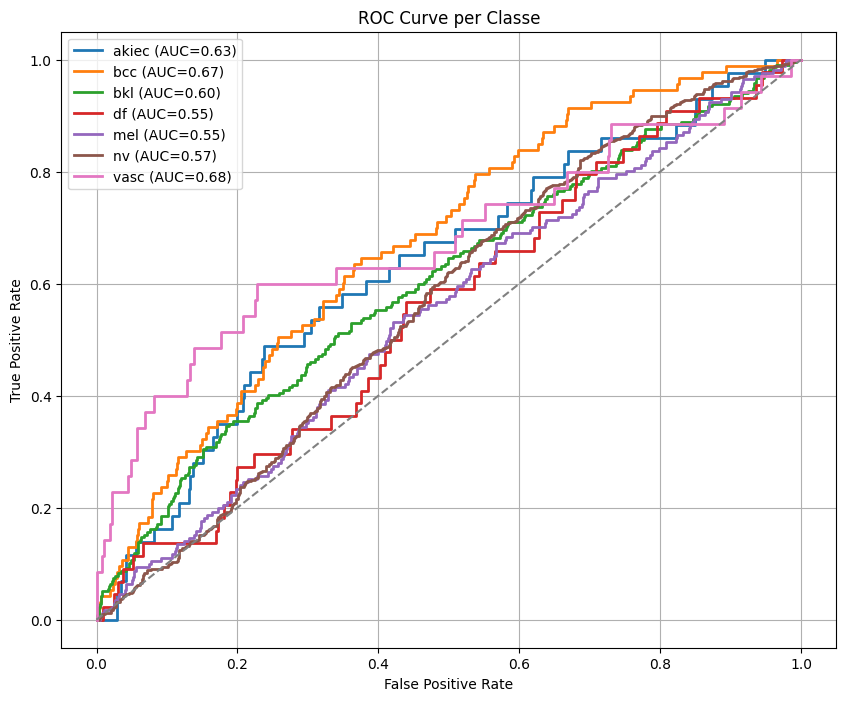

In [ ]:
from sklearn.metrics import roc_curve, auc, roc_auc_score

# ROC per classe
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], pred_probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Micro-average ROC
fpr["micro"], tpr["micro"], _ = roc_curve(y_true_bin.ravel(), pred_probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Macro-average ROC
# Unifica tutti i FPR
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)

for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])

mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot ROC
plt.figure(figsize=(10, 8))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], lw=2, label=f'{class_names[i]} (AUC={roc_auc[i]:.2f})')

#plt.plot(fpr["micro"], tpr["micro"], linestyle='--', color='black', label=f'micro-average (AUC={roc_auc["micro"]:.2f})')
#plt.plot(fpr["macro"], tpr["macro"], linestyle=':', color='navy', label=f'macro-average (AUC={roc_auc["macro"]:.2f})')

plt.plot([0, 1], [0, 1], color='gray', linestyle='--')  # Linea diagonale
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve per Classe")
plt.legend(loc='best')
plt.grid(True)
plt.show()


We can try to finetune the layer of the EfficientNet imposing a learning rate very low.

In [ ]:
base_model = model.layers[1]  # o model.get_layer('efficientnetb0')
base_model.trainable = True




from tensorflow.keras.optimizers import Adam

model.compile(
    optimizer=Adam(learning_rate=5e-5),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)


In [ ]:
fine_tune_history = model.fit(
    train_generator,
    epochs=20,
    validation_data=(X_val_pre, y_val_cat),
    steps_per_epoch=len(X_train) // batch_size,
    callbacks=[EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)]
)


Epoch 1/20
250/250 [==============================] - ETA: 0s - loss: 0.6840 - accuracy: 0.7465

2025-07-04 14:01:52.732166: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 1206030336 exceeds 10% of free system memory.
2025-07-04 14:01:54.300159: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 1206030336 exceeds 10% of free system memory.


250/250 [==============================] - 116s 339ms/step - loss: 0.6840 - accuracy: 0.7465 - val_loss: 0.9740 - val_accuracy: 0.6515
Epoch 2/20
250/250 [==============================] - 73s 291ms/step - loss: 0.5049 - accuracy: 0.8190 - val_loss: 0.9155 - val_accuracy: 0.6725
Epoch 3/20
250/250 [==============================] - 73s 291ms/step - loss: 0.4009 - accuracy: 0.8553 - val_loss: 0.8642 - val_accuracy: 0.6845
Epoch 4/20
250/250 [==============================] - 73s 293ms/step - loss: 0.3291 - accuracy: 0.8809 - val_loss: 0.8151 - val_accuracy: 0.7024
Epoch 5/20
250/250 [==============================] - 76s 305ms/step - loss: 0.2650 - accuracy: 0.9095 - val_loss: 0.8626 - val_accuracy: 0.6975
Epoch 6/20
250/250 [==============================] - 74s 296ms/step - loss: 0.2144 - accuracy: 0.9226 - val_loss: 0.8084 - val_accuracy: 0.7304
Epoch 7/20
250/250 [==============================] - 74s 295ms/step - loss: 0.1769 - accuracy: 0.9356 - val_loss: 1.0353 - val_accuracy: 0.

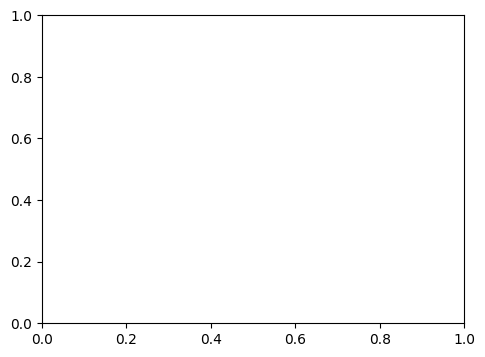

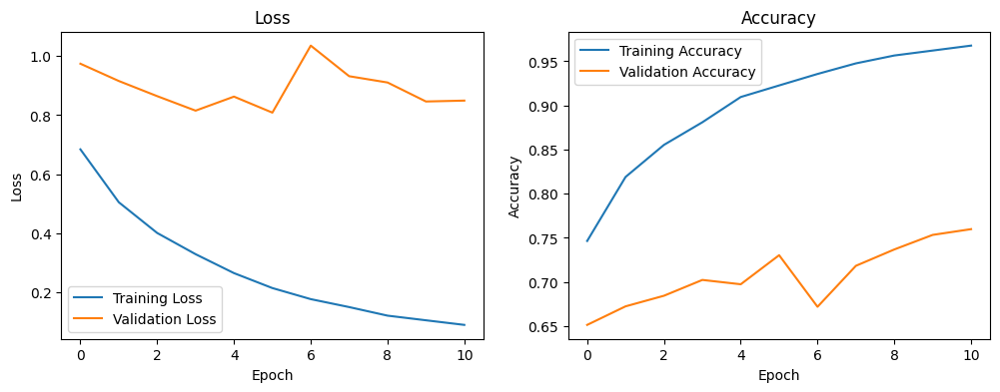

In [ ]:
import matplotlib.pyplot as plt

# Dati estratti dalla tua history (per esempio con `history.history` in Keras)
history_dict = {
    'loss': [0.6840, 0.5049, 0.4009, 0.3291, 0.2650, 0.2144, 0.1769, 0.1500, 0.1210, 0.1053, 0.0897],
    'val_loss': [0.9740, 0.9155, 0.8642, 0.8151, 0.8626, 0.8084, 1.0353, 0.9317, 0.9104, 0.8461, 0.8491],
    'accuracy': [0.7465, 0.8190, 0.8553, 0.8809, 0.9095, 0.9226, 0.9356, 0.9476, 0.9565, 0.9621, 0.9677],
    'val_accuracy': [0.6515, 0.6725, 0.6845, 0.7024, 0.6975, 0.7304, 0.6720, 0.7184, 0.7369, 0.7534, 0.7599],
}

# Epochs
epochs = range(1, len(history_dict['loss']) + 1)

# Plot Loss

plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history_dict['loss'], label='Training Loss')
plt.plot(history_dict['val_loss'], label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history_dict['accuracy'], label='Training Accuracy')
plt.plot(history_dict['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.show()


We can try also to change the way we merge the images with the mask, so we can use the mask to crop a bounding box which contains only the skin lesion.

In [ ]:
import os
from PIL import Image
import numpy as np

input_dir = "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Training_senza_peli"
output_dir = "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/HAM10000_segmentations_lesion_tschandl"
cropped_output_dir = "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Training_crop"
os.makedirs(cropped_output_dir, exist_ok=True)

for filename in os.listdir(input_dir):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        img_path = os.path.join(input_dir, filename)

        # Ricava nome maschera
        base_name, _ = os.path.splitext(filename)
        mask_filename = f"{base_name}_segmentation.png"
        mask_path = os.path.join(output_dir, mask_filename)

        if not os.path.exists(mask_path):
            print(f"Maschera non trovata per {filename}")
            continue

        # Carica immagine originale e maschera
        img = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        # Converti maschera in array binario
        mask_np = np.array(mask)
        binary_mask = (mask_np > 127).astype(np.uint8)

        coords = np.argwhere(binary_mask)
        if coords.size == 0:
            print(f"Nessun oggetto trovato in: {filename}")
            continue

        y0, x0 = coords.min(axis=0)
        y1, x1 = coords.max(axis=0) + 1

        cropped = img.crop((x0, y0, x1, y1))
        cropped.save(os.path.join(cropped_output_dir, f"crop_{filename}"))

print("Ritagli salvati in:", cropped_output_dir)


We do the same with test images

In [ ]:
import os
from PIL import Image
import numpy as np

input_dir = "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Test_senza_peli_224"
output_dir = "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Test_mask"
cropped_output_dir = "/tf/OneDrive/Desktop/Università/Data_Science/Data_miniing/Test_crop_senza_peli"
os.makedirs(cropped_output_dir, exist_ok=True)

for filename in os.listdir(input_dir):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        img_path = os.path.join(input_dir, filename)

        # Ricava nome maschera
        base_name, _ = os.path.splitext(filename)
        mask_filename = f"mask_{base_name}.jpg"
        mask_path = os.path.join(output_dir, mask_filename)

        if not os.path.exists(mask_path):
            print(f"Maschera non trovata per {filename}")
            continue

        # Carica immagine originale e maschera
        img = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        # Converti maschera in array binario
        mask_np = np.array(mask)
        binary_mask = (mask_np > 127).astype(np.uint8)

        coords = np.argwhere(binary_mask)
        if coords.size == 0:
            print(f"Nessun oggetto trovato in: {filename}")
            continue

        y0, x0 = coords.min(axis=0)
        y1, x1 = coords.max(axis=0) + 1

        cropped = img.crop((x0, y0, x1, y1))
        cropped.save(os.path.join(cropped_output_dir, f"crop_{filename}"))

print("Ritagli salvati in:", cropped_output_dir)


We have to change the path of the images

In [ ]:
base_path = "OneDrive/Desktop/Università/Data_Science/Data_miniing"

#Metadata CSV
df = pd.read_csv(os.path.join(base_path, "ISIC2018_Task3_Test_GroundTruth.csv"))
df.rename(columns={
    "dx": "CLASS",
    "dx_type": "Ground truth type"
}, inplace=True)

df

,lesion_id,image_id,CLASS,Ground truth type,age,sex,localization,dataset
0,HAMTEST_0000000,ISIC_0034524,nv,follow_up,40.0,female,back,vidir_molemax
1,HAMTEST_0000001,ISIC_0034525,nv,histo,70.0,male,abdomen,rosendahl
2,HAMTEST_0000002,ISIC_0034526,bkl,histo,70.0,male,back,rosendahl
3,HAMTEST_0000003,ISIC_0034527,nv,histo,35.0,male,trunk,vienna_dias
4,HAMTEST_0000004,ISIC_0034528,nv,follow_up,75.0,female,trunk,vidir_molemax
...,...,...,...,...,...,...,...,...
1507,HAMTEST_0001219,ISIC_0036060,bkl,consensus,NaN,unknown,unknown,external
1508,HAMTEST_0001220,ISIC_0036061,nv,consensus,NaN,unknown,unknown,external
1509,HAMTEST_0001107,ISIC_0036062,akiec,histo,70.0,female,face,vidir_modern
1510,HAMTEST_0001221,ISIC_0036063,bkl,consensus,NaN,unknown,unknown,external


In [ ]:
lesion_type_dict = {
    'nv': 'Melanocytic nevi',
    'mel': 'Melanoma',
    'bkl': 'Benign keratosis-like lesions ',
    'bcc': 'Basal cell carcinoma',
    'akiec': 'Actinic keratoses',
    'vasc': 'Vascular lesions',
    'df': 'Dermatofibroma'
}


df["Cell_type"] = df["CLASS"].map(lesion_type_dict.get)

In [ ]:

def get_image_test(image_id):
    base_images = os.path.join(base_path, "Test_crop_senza_peli")
    path = os.path.join(base_images, f"crop_{image_id}.jpg")
    return path
df["percorso_immagine"] = df["image_id"].apply(get_image_test)
df = df[df['image_id'] != 'ISIC_0035068'].reset_index(drop=True)

In [ ]:

image_files = df["percorso_immagine"].tolist()

print(f"Total number of images: {len(image_files)}")

Total number of images: 1511


In [ ]:
df['label'] = df['CLASS'].astype('category')
class_names = df['label'].cat.categories
df['label_encoded'] = df['label'].cat.codes
num_classes = df['label_encoded'].nunique()

In [ ]:
df['percorso_immagine'][0]

'OneDrive/Desktop/Università/Data_Science/Data_miniing/Test_crop_senza_peli/crop_ISIC_0034524.jpg'

Now we can train the model

In [ ]:

base_model = EfficientNetB0(include_top=False, weights='imagenet', input_shape=input_shape)
base_model.trainable = False  # Freezing

inputs = Input(shape=input_shape)
x = base_model(inputs, training=False)
x = GlobalAveragePooling2D()(x)
x = Dropout(0.2)(x)
outputs = Dense(num_classes, activation='softmax')(x)

model = Model(inputs, outputs)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


In [ ]:
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True,
    verbose=1
)

history = model.fit(
    train_generator,
    epochs=40,
    validation_data=(X_val_pre, y_val_cat),
    steps_per_epoch=len(X_train) // batch_size,
    callbacks=[early_stopping]
)


Epoch 1/40
250/250 [==============================] - 78s 263ms/step - loss: 1.2754 - accuracy: 0.5158 - val_loss: 0.9929 - val_accuracy: 0.6360
Epoch 2/40
250/250 [==============================] - 67s 266ms/step - loss: 1.0363 - accuracy: 0.6095 - val_loss: 0.9994 - val_accuracy: 0.6241
Epoch 3/40
250/250 [==============================] - 59s 236ms/step - loss: 0.9445 - accuracy: 0.6360 - val_loss: 1.0021 - val_accuracy: 0.6201
Epoch 4/40
250/250 [==============================] - 60s 238ms/step - loss: 0.8734 - accuracy: 0.6743 - val_loss: 0.9039 - val_accuracy: 0.6460
Epoch 5/40
250/250 [==============================] - 60s 238ms/step - loss: 0.8253 - accuracy: 0.6926 - val_loss: 0.8525 - val_accuracy: 0.6755
Epoch 6/40
250/250 [==============================] - 60s 240ms/step - loss: 0.7897 - accuracy: 0.7041 - val_loss: 0.8471 - val_accuracy: 0.6545
Epoch 7/40
250/250 [==============================] - 59s 237ms/step - loss: 0.7501 - accuracy: 0.7210 - val_loss: 0.8855 - val_ac

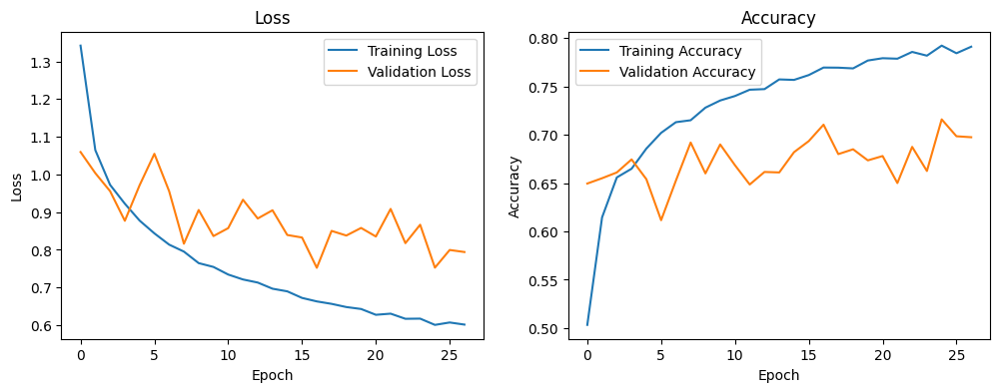

In [ ]:
#printa history del loss e accuracy
import matplotlib.pyplot as plt


plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.show()

And evaluate it on the test

48/48 ━━━━━━━━━━━━━━━━━━━━ 26s 493ms/step
Classification report:
              precision    recall  f1-score   support

       akiec       0.00      0.00      0.00        43
         bcc       0.16      0.41      0.23        93
         bkl       0.52      0.10      0.17       217
          df       1.00      0.02      0.04        44
         mel       0.00      0.00      0.00       171
          nv       0.70      0.63      0.66       908
        vasc       0.04      0.51      0.08        35

    accuracy                           0.43      1511
   macro avg       0.35      0.24      0.17      1511
weighted avg       0.53      0.43      0.44      1511



C:\Users\rober\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\rober\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\rober\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


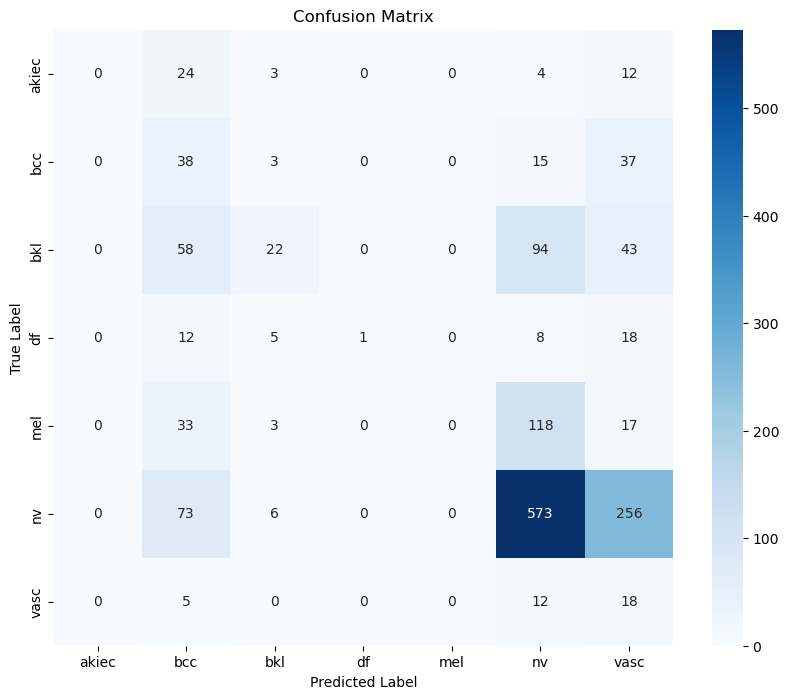

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.applications.resnet50 import preprocess_input
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import pandas as pd

# === 1. Carica immagini e label dal dataframe
IMG_SIZE = (224, 224)
X_test = []
y_true = []

for _, row in df.iterrows():
    img_path = row['percorso_immagine']
    img = load_img(img_path, target_size=IMG_SIZE)
    img_array = img_to_array(img)
    img_array = preprocess_input(img_array)

    X_test.append(img_array)
    y_true.append(row['label_encoded'])  # o 'label' se è già numerico

X_test = np.array(X_test)
y_true = np.array(y_true)

# === 2. Predizione
pred_probs = model.predict(X_test)
y_pred = np.argmax(pred_probs, axis=1)

# === 3. Valutazione testuale
print("Classification report:")
print(classification_report(y_true, y_pred, target_names=class_names))


# === 4. Visualizzazione confusion matrix con seaborn
cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()


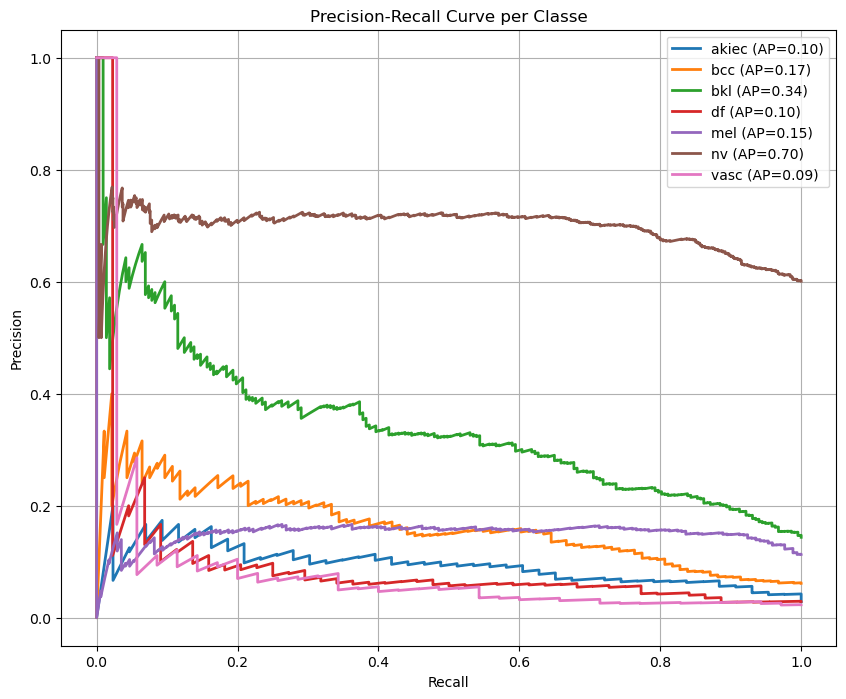

In [ ]:
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.preprocessing import label_binarize
import matplotlib.pyplot as plt

# Binarizza le etichette vere
n_classes = len(class_names)
y_true_bin = label_binarize(y_true, classes=range(n_classes))

# Precision-Recall per classe
precision = dict()
recall = dict()
avg_precision = dict()

for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_true_bin[:, i], pred_probs[:, i])
    avg_precision[i] = average_precision_score(y_true_bin[:, i], pred_probs[:, i])

# Micro-average PR
precision["micro"], recall["micro"], _ = precision_recall_curve(y_true_bin.ravel(), pred_probs.ravel())
avg_precision["micro"] = average_precision_score(y_true_bin, pred_probs, average="micro")

# Plot Precision-Recall
plt.figure(figsize=(10, 8))
for i in range(n_classes):
    plt.plot(recall[i], precision[i], lw=2, label=f'{class_names[i]} (AP={avg_precision[i]:.2f})')
#plt.plot(recall["micro"], precision["micro"], linestyle='--', color='black', label=f'micro-average (AP={avg_precision["micro"]:.2f})')

plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-Recall Curve per Classe")
plt.legend(loc='best')
plt.grid(True)
plt.show()


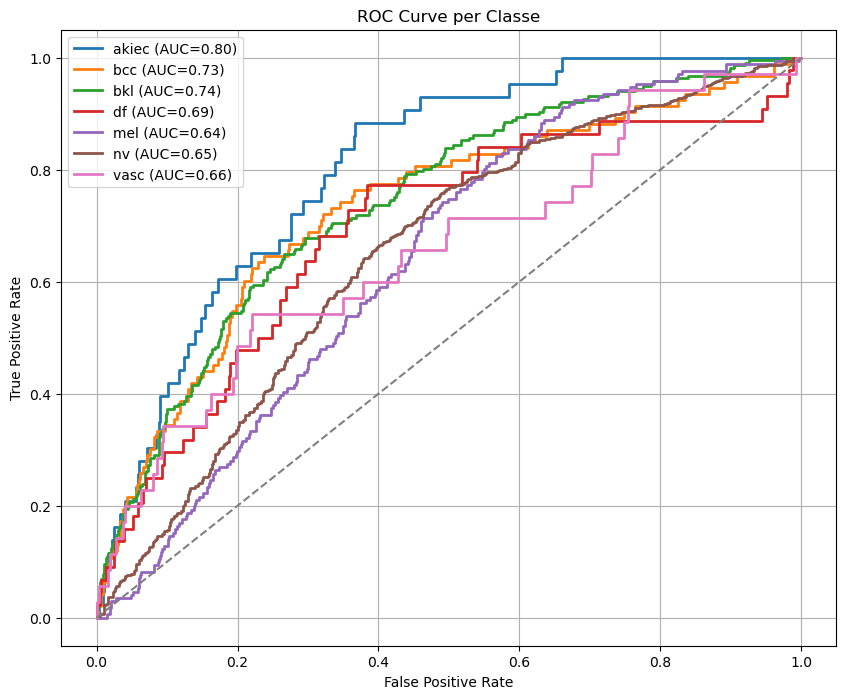

In [ ]:
from sklearn.metrics import roc_curve, auc, roc_auc_score

# ROC per classe
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], pred_probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Micro-average ROC
fpr["micro"], tpr["micro"], _ = roc_curve(y_true_bin.ravel(), pred_probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Macro-average ROC
# Unifica tutti i FPR
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)

for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])

mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot ROC
plt.figure(figsize=(10, 8))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], lw=2, label=f'{class_names[i]} (AUC={roc_auc[i]:.2f})')

#plt.plot(fpr["micro"], tpr["micro"], linestyle='--', color='black', label=f'micro-average (AUC={roc_auc["micro"]:.2f})')
#plt.plot(fpr["macro"], tpr["macro"], linestyle=':', color='navy', label=f'macro-average (AUC={roc_auc["macro"]:.2f})')

plt.plot([0, 1], [0, 1], color='gray', linestyle='--')  # Linea diagonale
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve per Classe")
plt.legend(loc='best')
plt.grid(True)
plt.show()


# Conclusion


Overall, the models did not perform well on the test set, with the exception of melanocytic nevi (nv), which consistently achieved higher accuracy and recall. In contrast, malignant lesions such as melanoma (mel), basal cell carcinoma (bcc), and actinic keratoses (akiec) were poorly classified, with recall values consistently below 50%, even in the best-performing models.

Even with regularization techniques (e.g., data augmentation, class balancing) and architectural improvements (e.g., EfficientNet with fine-tuning), the overall accuracy never exceeded 60%. Furthermore, models using segmented images did not show a consistent advantage. This may be due to the fact that the HAM10000 images are already well-focused dermatoscopic images, reducing the benefit of lesion isolation.

A major challenge lies in the high intra-class variability of certain classes, especially melanocytic nevi, which makes classification less reliable and increases the overlap with malignant categories.